# Projet P6 OC Data Scientist: Classifiez des biens de consommation

# 1. Problématique

Ce projet explore une problématique de **marketplace** **e-commerce** voulant classer automatiquement des articles. Sur cette marketplace, des vendeurs proposent des articles à des acheteurs en postant une photo et une description.  

Pour rendre l’expérience utilisateur des vendeurs (faciliter la mise en ligne de nouveaux articles) et des acheteurs (faciliter la recherche de produits) la plus fluide possible et dans l'optique d'un passage à l'échelle, il devient nécessaire d'automatiser cette tâche.

Pour cela, nous allons réaliser une étude de faisabilité pour la mise en place d'un moteur de classification basé sur le clustering de l'encodage du texte (description) et des images (photos des articles).

# 2. Mise en place environnement et importation des librairies

In [930]:
# Librairies communes
import pandas as pd
import numpy as np
import sklearn
import timeit
import re
import en_core_web_sm
import os
from numpy import nan as Nan

# Librairies pour la visualisation
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly
import plotly.express as px
import matplotlib.cm as cm
from wordcloud import WordCloud
from collections import Counter
import itertools

# Librairies pour NLP
import nltk
from nltk.corpus import stopwords
from nltk.corpus import wordnet
from nltk.stem import PorterStemmer, LancasterStemmer, SnowballStemmer, WordNetLemmatizer
nltk.download('punkt')
nltk.download('words')

import spacy as sp
from nltk.stem.snowball import SnowballStemmer
from nltk.tokenize import RegexpTokenizer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from spacy.lang.en import English
from spacy.tokenizer import Tokenizer
from PIL import Image, ImageOps, ImageFilter
from nltk import word_tokenize
import gensim
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

# Librairies sklearn pour ML
from sklearn.preprocessing import StandardScaler, LabelEncoder, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.cluster import KMeans, MiniBatchKMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix
from sklearn.metrics import silhouette_score, adjusted_rand_score, silhouette_samples
from sklearn.model_selection import RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics.cluster import pair_confusion_matrix
from sklearn.decomposition import NMF
from sklearn.svm import SVC
from sklearn.metrics import plot_confusion_matrix

# Computer Vision Lib.
import cv2
import PIL

# Keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras.applications.resnet50 import preprocess_input

# Librairie fonctions pour le projet
from functions_p6_project import *  

import warnings
warnings.filterwarnings(action='ignore')

# Versions des librairies
print("Version librairie pandas: " + pd.__version__)
print("Version librairie numpy: " + np.__version__)
print("Version librairie matplotlib: " + matplotlib.__version__)
print("Version librairie seaborn: " + sns.__version__)

Version librairie pandas: 1.1.3
Version librairie numpy: 1.19.2
Version librairie matplotlib: 3.3.2
Version librairie seaborn: 0.11.0


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\david\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\david\AppData\Roaming\nltk_data...
[nltk_data]   Package words is already up-to-date!


# 3. Fonctions

In [2]:
# Fonction pour retirer les mots correspondant ou contenant des chiffres
def remove_words_with_digits(description):
    description_temp = re.sub(r"[A-Za-z]+\d+|\d+[A-Za-z]+",'',description).strip()
    description_w_num = ''.join(i for i in description_temp if not i.isdigit())
    return description_w_num

In [3]:
# Fonction pour mapper les balises POS de NLTK dans un format accepté par le lemmatizer Wordnet
def get_wordnet_pos(word):
    """Map POS tag to first character lemmatize() accepts"""
    tag = nltk.pos_tag([word])[0][1][0].upper()
    tag_dict = {"J": wordnet.ADJ,
                "N": wordnet.NOUN,
                "V": wordnet.VERB,
                "R": wordnet.ADV}

    return tag_dict.get(tag, wordnet.NOUN)

In [4]:
# Fonction pour vectoriser des phrases avec Doc2Vec
def enc_doc2vec(df_in, column):
    # tokenization et tag des phrases
    tag_docs = [TaggedDocument(doc.split(' '), [i]) 
             for i, doc in enumerate(df_in[column])]

    # Instanciation du modèle
    model = Doc2Vec(vector_size=1000, window=5, min_count=1, workers=8, epochs=40)
    
    # Construction du vocabulaire
    model.build_vocab(tag_docs)
    
    # Entraînement du modèle
    model.train(tag_docs, total_examples=model.corpus_count, epochs=model.epochs)
    
    # Génération des vecteurs
    sentence_vect = [model.infer_vector((df_in[column][i].split(' '))) 
            for i in range(0,len(df_in[column]))]
    
    # Création d'une liste de liste
    liste_vec = np.array(sentence_vect).tolist()
    
    # Ajout à la dataframe
    df_in["enc_doc2vec"] = liste_vec
    
    return tag_docs, sentence_vect, df_in   

In [5]:
# Fonction pour le nettoyage de la variable "categ_1"
def clean_categ_1(text):
    text = text[2:]
    return text

In [6]:
# Fonction qui ajoute le chemin complet pour accéder directement au répertoire Images
def chemin_complet(image):
    
    # Cette fonction permet de reformater le champs image
    # afin d'avoir le chemin complet dans le but de les
    # charger plus facilement
    
    image = "Images/" + image
    
    return image

In [7]:
# Fonction pour ajout des images au dataset
def image_dataset(df_in_orig, df_in_image):
    
    # On repart du dataset complet pour ajouter les images 
    df_in_image['image'] = df_in_orig['image'].copy()

    # Formatage de la colonne "image" de manière pour avoir le chemin complet des fichiers
    df_in_image['image'] = df_in_image['image'].apply(chemin_complet)
    
    return df_in_image

In [8]:
# Fonction pour redimensionner une image en  224*224 pixels en tenant compte de proportions initiales
def redimensionne_image(image, rep_redim):
    
    # On charge l'image d'origine
    img = Image.open(image)
    file_dir=os.path.split(image)
    
    width, height = img.size
    
    # Test pour savoir si l'image est  au format: paysage ou portrait, ou même carrée
    
    # On récupère le côté le plus grand et on le redimensionne à la taille souhaitée, ici 224.
    # Tout en gardant le ratio hauteur/largeur pour l'autre côté.
    if height > width:
    
        aspect = height / 224
        new_size = (int(width/aspect), 224)
    elif width > height:
        
        aspect = width / 224
        new_size = (224, int(height/aspect))
    else:
        
        new_size = (224, 224)
    
    # On enregistre dans un nouveau dossier l'image redimensionnée.
    img.resize(new_size).save(rep_redim+file_dir[1])

    # Nous avons une image de taille 224xXXX ou XXXx224, or
    # notre CNN n'accepte que des images de la taille 224x224,
    # il nous faut donc retravailler la taille de l'image.
    
    # Pour cela, nous allons créer une image de taille 224x224
    # entièrement blanche, puis coller notre image redimensionnée
    # précédemment de manière centrée sur cette image blanche.
    
    img = Image.open(rep_redim+file_dir[1])
    
    width, height = img.size
    
    if height > width:
        new_img = Image.new('RGB', (224, 224),(255,255,255)) # Image blanche
        
        pos_lrg = int((height - width) / 2)
        new_img.paste(img, box=(pos_lrg,0))
        
        new_img.save(rep_redim+file_dir[1])
        
    elif width > height:
        new_img = Image.new('RGB', (224, 224),(255,255,255)) # image blanche
        
        pos_ht = int((width - height) / 2)
        new_img.paste(img, box=(0, pos_ht))

        new_img.save(rep_redim+file_dir[1])
    
    
    return rep_redim+file_dir[1]

In [9]:
# Fonction pour ajuster automatiquement le contraste d'une image
def autocontraste(image, rep_redim_contrast):
    
    img = Image.open(image)
        
    dimg = ImageOps.autocontrast(img, cutoff=0.5)
    
    file_dir=os.path.split(image)
    dimg.save(rep_redim_contrast+file_dir[1])
    
    return rep_redim_contrast+file_dir[1]

In [10]:
# Fonction pour l'enregistrement des images du dataset en niveaux de gris
def image_gray_scale(image, rep_image):
    file_dir=os.path.split(image)
    
    # Transformation de l'image en niveaux de gris
    image_gray = cv2.imread(image, cv2.IMREAD_GRAYSCALE)
    
    # Filtrage médian pour suppression du bruit
    image_gray_filtre_med = cv2.medianBlur(image_gray, 3)
    
    # Filtrage gaussien pour suppression du bruit à partir du filtre médian
    image_gray_filtre_gauss = cv2.GaussianBlur(image_gray_filtre_med, (5, 5), 1)
    
    # Equalize image histogram
    image_gray_filtre_gauss_eq = cv2.equalizeHist(image_gray_filtre_gauss)   
    
    cv2.imwrite(rep_image+file_dir[1], image_gray_filtre_gauss_eq)
    
    return rep_image+file_dir[1]

In [1198]:
# Fonction pour encodage features SIFT
def encode_features_sift(df_in):
   
    sift_keypoints = []
    
    # Création instance SIFT de 500 descripteurs
    sift = cv2.xfeatures2d.SIFT_create(500)
    
    # Liste des images à traiter
    imgs = df_in["image"]
    for i in range(len(imgs)):
        
        img = imgs[i]
        
        # Transformation de l'image en niveaux de gris
        img = cv2.imread(img, cv2.IMREAD_GRAYSCALE)
    
        # Filtrage gaussien pour réduction du bruit
        img = cv2.GaussianBlur(img, (5, 5), 1)
    
        # Equalize image histogram
        img = cv2.equalizeHist(img)  
        
        # Détermination des descripteurs / keypoints
        kp, desc = sift.detectAndCompute(img, None)
        
        sift_keypoints.append(desc)
        
    sift_keypoints_by_img = np.asarray(sift_keypoints)
    sift_keypoints_all    = np.concatenate(sift_keypoints_by_img, axis=0)

    print('')
    print("Nombre de descripteurs : ", sift_keypoints_all.shape)
    print('')
    
    # Création des clusters de descripteurs
    # Pour k, on prend la racine carrée du nombre des descripteurs
    k = int(round(np.sqrt(len(sift_keypoints_all)),0))
    print("Nombre de clusters estimés : ", k)
    print("Création de",k, "clusters de descripteurs ...")

    kmeans = MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
    kmeans.fit(sift_keypoints_all)
    
    # Création de features et bag of visual words
    hist_vectors=[]

    for i, image_desc in enumerate(sift_keypoints_by_img) :
        if i%100 == 0 : print(i) 
            
        # Calcul de l'histogramme
        hist = build_histogram(kmeans, image_desc, i)
        
        hist_vectors.append(hist)

    image_features = np.asarray(hist_vectors)
    
    # Création de Bag of Visual Words dans le dataset
    df_in["bovw_sift"] = ""

    for i in range(df_in.shape[0]):
        df_in["bovw_sift"][i] = image_features[i]
   
    return sift_keypoints_all, df_in, image_features

In [12]:
# Fonction pour construire l'histogramme /features / bag of visual words
def build_histogram(kmeans, desc, image_num):
    res = kmeans.predict(desc)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_desc=len(desc)
    if nb_desc==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        #hist[i] += 1.0/nb_desc
        hist[i] += 1.0
    return hist

In [13]:
# Fonction pour extraction des données features du dataset
def extract_data_features_text_images(df_in, col):
    temp = np.column_stack(df_in[col].values.tolist())
    df = pd.DataFrame(temp).T
    
    return df

In [449]:
# Fonction pour clustering k-means
def clustering_kmeans(df_in, nbre_clusters, categ_true, nbre_iterations):
    
    silhouette = []
    ari = []
    
    for i in range(0,nbre_iterations):
        
        # Initialisation du k-means
        kmeans = KMeans(init='k-means++', n_clusters=nbre_clusters)
        
        # Entraînement du k-means
        cluster_kmeans = kmeans.fit(df_in)
        
        # Calcul score de silhouette
        sil_score = silhouette_score(df_in, cluster_kmeans.labels_)
        
        # Calcul de l'ARI score
        ari_score = adjusted_rand_score(categ_true, cluster_kmeans.labels_)
    
        silhouette.append(sil_score)
        ari.append(ari_score)
        
        # Calcul des métriques moyennes
        sil_score_mean = round(np.mean(silhouette),2)
        ari_score_mean = round(np.mean(ari),2)
    
    
    print("Coefficient silhouette moyen :", sil_score_mean)
    print("Score moyen Adjusted Rand index (ARI) :", ari_score_mean)
    
    # Retours de labels de clusters et du nombre de clusters
    df_result_kmeans = pd.DataFrame()
    df_result_kmeans["kmeans_labels"] = cluster_kmeans.labels_
    df_result_kmeans["nbre_articles"] = 0
    df_result_kmeans = df_result_kmeans.groupby("kmeans_labels", as_index=False).count()
    
    return kmeans, sil_score_mean, ari_score_mean, df_result_kmeans

In [15]:
# Fonction pour synthétiser les résultats du clustering
def synthese_resultats_clustering(df_in_score, df_in_cluster, pos_index, hyp_encod, type_encod, silhouette, ari, 
                                  result_kmeans):
    df_in_score.loc[pos_index-1]=[hyp_encod, type_encod, silhouette, ari]
    
    df_in_cluster["hyp encodage"] = hyp_encod
    df_in_cluster["type encodage"] = type_encod
    df_in_cluster = pd.concat([df_in_cluster, result_kmeans], axis=1)
    
    return df_in_score, df_in_cluster

In [16]:
# Fonction pour calcul de la matrice de confusion et affichage du heatmap
def affichage_matrice_confusion(cat_true, cat_true_labels, model_kmeans):
    # Calcul de la matrice de confusion
    conf_mat_enc = confusion_matrix(cat_true, model_kmeans.labels_)

    # Création d'une dataframe
    df_cm_enc = pd.DataFrame(conf_mat_enc, index = [label for label in cat_true_labels.unique()],
                            columns = [i for i in "0123456"])

    # Affichage du heatmap
    plt.figure(figsize = (7,5))
    sns.heatmap(df_cm_enc, annot=True, cmap="Blues", fmt="d")
    
    return None

In [1191]:
# Fonction pour calcul de la matrice de confusion et affichage du heatmap
def affichage_matrice_confusion_transform(cat_true, cat_true_labels, kmeans_labels, isforced, argmax):
    # Calcul de la matrice de confusion avec les identifiants de cluster K-means
    conf_mat_enc = confusion_matrix(cat_true, kmeans_labels)
    
    # Mise en correspondance des identifiants de cluster K-means avec les étiquettes
    # de la vérité terrain (catégories d'articles). 
    # L'idée sous-jacente est d'afficher les grandes valeurs sur la ligne diagonale
    # en supposant qu'elles correspondent à la bonne catégorie d'articles
    # Réorganisation de la matrice de confusion pour que ses grandes valeurs se déplacent
    # sur la ligne diagonale.
    if isforced == None:
        cm_argmax = conf_mat_enc.argmax(axis=0)
    elif isforced == "force":
        cm_argmax = argmax
    else:
        print("Cas non pris en compte")
        return None

    label_kmeans_pred_ = np.array([cm_argmax[i] for i in kmeans_labels])
    
     # Calcul de la matrice de confusion transformée
    conf_mat_enc_transform = confusion_matrix(cat_true, label_kmeans_pred_)

    # Création d'une dataframe
    labels_categ_true = cat_true_labels.unique()
    num_clusters = ["0", "1", "2", "3", "4", "5", "6"]
    labels_clusters_categ = ["Cluster ("  +labels_categ_true[0] + ")",
                             "Cluster ("  +labels_categ_true[1] + ")",
                             "Cluster ("  +labels_categ_true[2] + ")",
                             "Cluster ("  +labels_categ_true[3] + ")",
                             "Cluster ("  +labels_categ_true[4] + ")",
                             "Cluster ("  +labels_categ_true[5] + ")",
                             "Cluster ("  +labels_categ_true[6] + ")"]


    df_cm_enc = pd.DataFrame(conf_mat_enc_transform, index = [label for label in 
                                                          cat_true_labels.unique()],
                                                          columns = [i for i in labels_clusters_categ])

    # Affichage du heatmap
    plt.figure(figsize = (7,5))
    sns.heatmap(df_cm_enc, annot=True, cmap="Blues", fmt="d")
    plt.xticks(rotation=75, size=8)
    plt.xlabel("Labels des clusters obtenus en fonction de l'étiquette majoritaire de la vérité terrain",size=8)
    plt.ylabel("Catégories d'article (vérité terrain)", size=8)
    
    return cm_argmax

In [505]:
# Fonction pour l'extraction des features sur les réseaux de neurones (CNN) déjà entraînés
def extract_features_cnn(model, images):
    if model == "VGG16":
        model = VGG16(weights='imagenet', include_top=False)
    elif model == "ResNet50":
        model = ResNet50(weights='imagenet', include_top=False)
    else:
        print("Réseau de neurones non pris en compte !")
        return None
    
    model.summary()
    cnn_feature_list = []

    for img_path in images["image_redim_contrast"]:
    
        img = image.load_img(img_path, target_size=(224, 224))
        img_data = image.img_to_array(img)
        img_data = np.expand_dims(img_data, axis=0)
        img_data = preprocess_input(img_data)

        cnn_feature = model.predict(img_data)
        cnn_feature_np = np.array(cnn_feature)
        cnn_feature_list.append(cnn_feature_np.flatten())
        
    cnn_feature_list_np = np.array(cnn_feature_list)
    
    return cnn_feature_list_np

In [677]:
# Fonction pour modélisation automatique non supervisée NMF (Negative Matrix Factorisation)
def modelisation_nmf(df_in, nbre_component):
    
    print("Dimensions dataset avant NMF : ", df_in.shape)
    
    # Initialisation du modèle
    model_nmf = NMF(n_components=nbre_component, solver="mu")

    # Entraînement du modèle
    W = model_nmf.fit_transform(df_in)
    H = model_nmf.components_
    
    df_in = pd.DataFrame(W)
    
    print("Dimensions dataset après NMF : ", df_in.shape)
    
    return df_in

In [617]:
# Fonction pour ajouter une ligne de score dans une dataframe
def add_line_score_dataset(df_in):
    
    new_line = pd.Series([Nan,Nan,Nan,Nan], index=["hyp encodage", "type encodage",
                                               "silhouette score", 'ari score'])
    df_in = df_in.append(new_line,ignore_index=True)

    return df_in

In [678]:
# Fonction pour la standardisation des données
# Passage de la méthode de standardisation
def std_data(df_in, method):

    # Renvoie un tableau numpy
    x = df_in.values

    scaler = method
    x_scaled = scaler.fit_transform(x)
    df_data_std = pd.DataFrame(x_scaled, columns=df_in.columns)
    
    return df_data_std

In [725]:
# Fonction pour concaténer 2 dataframes
def concat_df(df1, df2):
    df = pd.concat([df1, df2], axis=1, ignore_index=True)
    
    return df

In [805]:
# Fonction pour l'affichage des scores de silhouette
def affich_score_silhouette(df_in):
    data = df_in.sort_values(by="silhouette score", ascending=False)
    plt.figure(figsize=(20, 6))
    plt.xticks(rotation=90, size=14)
    sns.barplot(x=data["hyp encodage"], y=data["silhouette score"])
    plt.title("Synthèse des scores de silhouette", size=18)
    plt.xlabel("Méthodes pour l'extraction des features",size=14)
    plt.ylabel("Score de silhouette", size=14)
    
    plt.show()
    
    return None

In [807]:
# Fonction pour l'affichage des scores ARI
def affich_score_ari(df_in):
    data = df_in.sort_values(by="ari score", ascending=False)
    plt.figure(figsize=(20, 6))
    plt.xticks(rotation=90, size=14)
    sns.barplot(x=data["hyp encodage"], y=data["ari score"])
    plt.title("Synthèse des scores ARI", size=18)
    plt.xlabel("Méthodes pour l'extraction des features",size=14)
    plt.ylabel("Score ARI", size=14)
    
    plt.show()
    
    return None

In [979]:
# Fonction pour l'affichage de la distribution des clusters
def affich_taille_clusters(df_in):

    plt.figure(figsize=(5,5))

    plt.bar(df_in["kmeans_labels"], height=df_in["nbre_articles"])
    plt.xlabel("Numéro de clusters", size=14)
    plt.ylabel("Nbre d'articles", size=14)
    plt.title("Taille de clusters", size=14)
    
    plt.show()
    
    return None

In [943]:
# Fonction pour classification supervisée avec SVC
def classif_svm_classifier(X, y):
    
    # Separation du jeu de données en jeu d'entraînement et de test
    X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 0, test_size=0.25) 
    
    # Entraînement du SVM classifier
    svm_model_linear = SVC(kernel = 'linear', C = 1).fit(X_train, y_train) 
    
    # Prédiction sur le jeu de test
    svm_predictions = svm_model_linear.predict(X_test) 
    
    # model accuracy for X_test   
    accuracy_svm = svm_model_linear.score(X_test, y_test)
    
    return svm_model_linear, svm_predictions, accuracy_svm, X_test, y_test

In [950]:
# Fonction pour l'affichage de la matrice de confusion suite classification
def affich_cm_classif(X_test, y_test, model, predictions):

    # Création de la matrice de confusion 
    cm = confusion_matrix(y_test, predictions)

    plt.figure(figsize=(10,10))

    print("L'echantillon de test contient :", X_test.shape[0], "articles.")

    disp = plot_confusion_matrix(model,
                             X_test, 
                             y_test,
                             cmap="Blues")


    plt.xticks(rotation=90)
    plt.show()
    
    return None

In [1200]:
# Fonction pour afficher des images du dataset
def affich_image(df_images, cat):
    fig = plt.figure(figsize=(15, 5))
    
    columns = 5
    rows = 2
    i = 1
    
    for img in df_images["image_redim_contrast"]:
        
        plt.style.use('default')
        image = plt.imread(img)
        fig.add_subplot(rows, columns, i)
        plt.imshow(image)
        plt.axis('off')
        i += 1

# 4. Chargement et description des données

In [17]:
df_data = pd.read_csv("./Input/flipkart_com-ecommerce_sample_1050.csv")
df_data.shape

(1050, 15)

In [18]:
df_data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [19]:
df_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

# 5. Analyse exploratoire des données

Utilisation de 3 features dans le jeu de données pour le pré-traitement des données textuelles et des images:
- **"product_category_tree"**: cette variable représente l'arborescence complète décrivant la catégorie principale et les sous-catégories auxquelles l'article appartient.
- **"description"**: cette variable correspond à la description de l'article ,sous forme d'une liste de mots décrivant l'article.
- **"image"** pour la photo de l'article.

Les 2 variables "product_category_tree" et "description" seront utilisées pour le pré-traitement des données textuelles et la variable "image" pour les pré-traitement des données image.

La variable "product_category_tree" sera utilisée comme labels des catégories.

## 5.1 Description des variables

### 5.1.1 Variable "description"

In [1244]:
# Affichage de la description du 2ème article
df_data["description"][0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

On remarque que le contenu de la description d'un article contient:
- des mots n'apportant aucune signification sur l'appartenance de l'article à une catégorie donnée comme des articles ou des chiffres.
- des mots commençant par une lettre capitale, qui correspondent aux mots "importants".

### 5.1.2 Variable "product_category_tree"

In [21]:
# Affichage de la description de l'arborescence des catégories produit du 2ème article
df_data["product_category_tree"][1]

'["Baby Care >> Baby Bath & Skin >> Baby Bath Towels >> Sathiyas Baby Bath Towels >> Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Y..."]'

On remarque que cette variable présente une arborescence de catégories / sous-catégories pour l'article.
Il y a une catégorie principale (1er niveau) que nous appellerons **"categ_1"** et une sous-catégorie précisant la catégorie principale (2ème niveau) que nous appellerons **"categ_2"**.

Nous nous intéresserons uniquement qu'aux 2 premiers niveaux de catégories produit.

### 5.1.3 Variable "image"

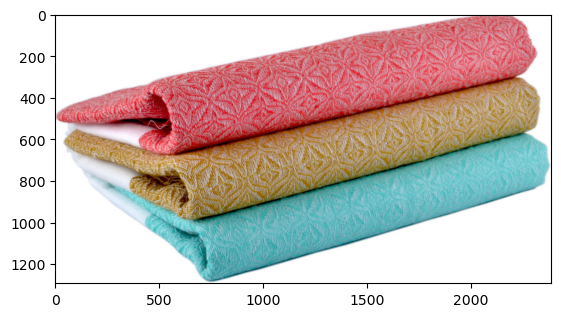

In [22]:
# Affichage de l'image du 2ème article
plt.style.use('default')
image = plt.imread("./Input/Images/7b72c92c2f6c40268628ec5f14c6d590.jpg")
plt.imshow(image)

In [23]:
# Taille en pixels et mode de l'image 
image = Image.open("./Input/Images/7b72c92c2f6c40268628ec5f14c6d590.jpg")
print("Taille en pixels: "+ str(image.size))
print("Mode de l\'image: " + image.mode)

Taille en pixels: (2388, 1293)
Mode de l'image: RGB


## 5.2 Analyse des catégories

### 5.2.1 Récupération des catégories d'article

Nous allons commencer par créer un dataset avec uniquement les features qui nous intéresse pour ce projet, et ensuite analyser l'arbre de chaque catégorie de produits de notre jeu de données pour en extraire les sous-catégories.

In [24]:
# Prise en compte des colonnes pour le pré-traitement du corpus de texte
df_data_text = df_data.loc[:, ["description", "product_category_tree"]]

# On crée une liste de strings en supprimant les >>
df = df_data_text["product_category_tree"].str.split(">>")

# Récupération des 2 premières valeurs de la liste
df_data_text["categ_princ"] = df.apply(lambda x: x[0])
df_data_text["sous_categ"] = df.apply(lambda x: x[1])

# Suppression des 2 premiers caractères de la colonne "categ_princ"
df_data_text["categ_princ"] = df_data_text["categ_princ"].str[2:]

df_data_text

,description,product_category_tree,categ_princ,sous_categ
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Home Furnishing,Curtains & Accessories
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Baby Care,Baby Bath & Skin
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Baby Care,Baby Bath & Skin
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Home Furnishing,Bed Linen
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Home Furnishing,Bed Linen
...,...,...,...,...
1045,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Baby Care,Baby & Kids Gifts
1046,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Baby Care,Baby & Kids Gifts
1047,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Baby Care,Baby & Kids Gifts
1048,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Baby Care,Baby & Kids Gifts


In [25]:
print("Il y a {} catégories dans la catégorie principale (categ_princ).".format(len(df_data_text["categ_princ"].unique())))
print("Il y a {} catégories dans la sous-catégorie (sous-categ).".format(len(df_data_text["sous_categ"].unique())))

Il y a 7 catégories dans la catégorie principale (categ_princ).
Il y a 63 catégories dans la sous-catégorie (sous-categ).


### 5.2.2 Nombre d'articles dans la catégorie principale (categ_princ)

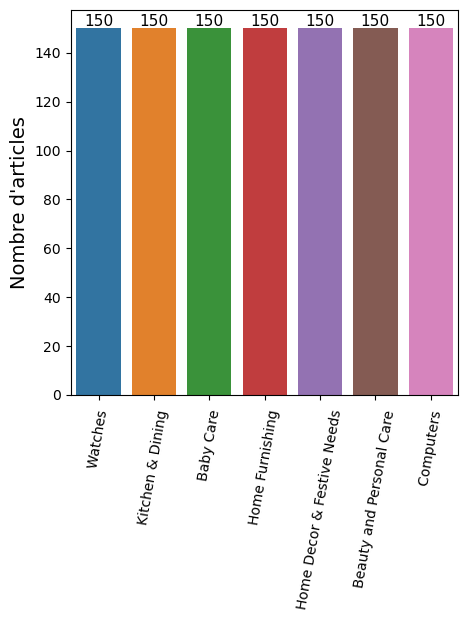

In [26]:
# On commence par faire le comptage de la catégorie principale (categ_princ)
plt.figure(figsize=(5, 5))
    
plt.xticks(rotation=80)

val = df_data_text["categ_princ"].value_counts()
val = pd.DataFrame(val)

sns.barplot(x=val.index, y=val["categ_princ"])

plt.ylabel("Nombre d'articles", size=14)

for i, v in enumerate(val["categ_princ"].values):
    plt.text(i, v+1, v, color='black', ha='center', size=11)


Il y a 150 articles par catégorie principale (categ_princ).

### 5.2.3 Nombre d'articles dans la sous-catégorie de 2ème niveau (sous_categ)

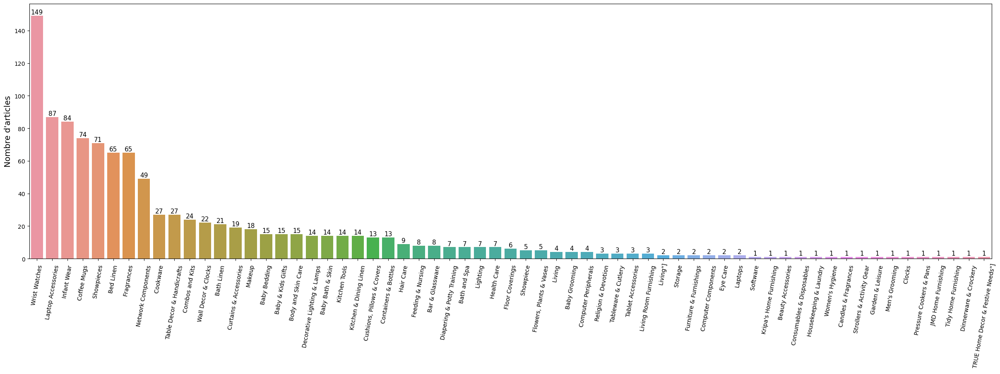

In [27]:
# On commence par faire le comptage d'articles dans la sous-catégorie (sous_categ)
plt.figure(figsize=(30, 8))
    
plt.xticks(rotation=80)

val = df_data_text["sous_categ"].value_counts()
val = pd.DataFrame(val)

sns.barplot(x=val.index, y=val["sous_categ"])

plt.ylabel("Nombre d'articles", size=14)

for i, v in enumerate(val["sous_categ"].values):
    plt.text(i, v+1, v, color='black', ha='center', size=11)


La distribution de la sous-catégorie "sous_categ" est asymétrique.

### 5.2.4 Analyse du contenu de la variable "description"

Affichage des mots de la variable "description" dans un nuage de mots.

(-0.5, 799.5, 499.5, -0.5)

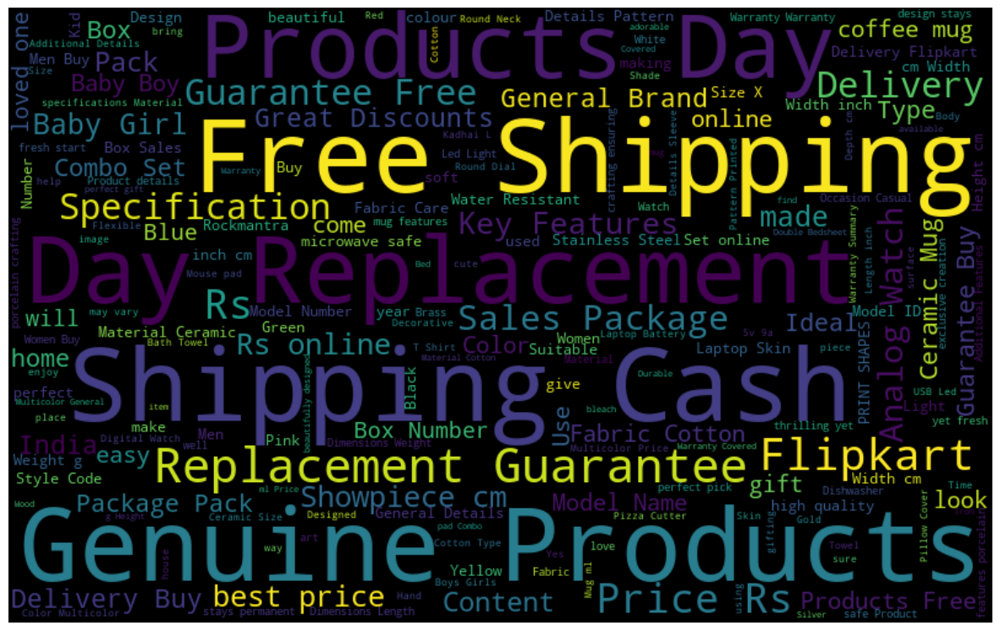

In [28]:
# Concaténation de toutes les descriptions des articles dans une variable
all_description = ' '.join([text for text in df_data_text["description"]])

# Affichage du nuage de mots
wordcloud = WordCloud(width=800, height=500,
                      random_state=21, max_font_size=110).generate(all_description)
plt.figure(figsize=(15, 12))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis('off')

On se rend compte que les mots le plus présents dans la variable "description" sont des mots généraux qui ne décrivent pas les articles.

C'est la raison pour laquelle il faut extraire le mots les plus significatifs pour les lier à la catégorie de l'article.

# 6. Pré-traitement du corpus de texte - traitements NLP

Ce pré-traitement du corpus de texte prend le contenu de la variable "description" du dataset pour effectuer les tâches suivantes:
- tokenisation pour séparer et identifier les différents mots du corpus de texte
- suppression des mots vides (stopwords)
- stemming ou lemmatisation du corpus de texte

## 6.1 Traitements pré-tokenisation

Liste des opérations réalisées:
- conversion des descriptions en minuscules.
- suppression de la ponctuation, des caractères spéciaux.
- suppression des mots contenant ou correspondant à des chiffres.

### 6.1.1 Conversion des descriptions en minuscules

In [29]:
# Conversion des descriptions en minuscules
preprocess_list_description = []
for description in df_data_text["description"]:
    description_lower = "".join([i.lower() for i in description])
    preprocess_list_description.append(description_lower)
preprocess_list_description[0]

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain,elegance polyester multicolor abstract eyelet door curtain (213 cm in height, pack of 2) price: rs. 899 this curtain enhances the look of the interiors.this curtain is made from 100% high quality polyester fabric.it features an eyelet style stitch with metal ring.it makes the room environment romantic and loving.this curtain is ant- wrinkle and anti shrinkage and have elegant apparance.give your home a bright and modernistic appeal with these designs. the surreal attention is sure to steal hearts. these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. bring home the elegant curtain that softly filters light in your room so that you

In [30]:
df_preprocess_list_description = pd.DataFrame(preprocess_list_description, columns=['description_preprocess'])
df_preprocess_list_description

,description_preprocess
0,key features of elegance polyester multicolor ...
1,specifications of sathiyas cotton bath towel (...
2,key features of eurospa cotton terry face towe...
3,key features of santosh royal fashion cotton p...
4,key features of jaipur print cotton floral kin...
...,...
1045,oren empower extra large self adhesive sticker...
1046,wallmantra large vinyl sticker sticker (pack o...
1047,buy uberlyfe extra large pigmented polyvinyl f...
1048,buy wallmantra medium vinyl sticker sticker fo...


### 6.1.2 Suppression de la ponctuation, des caractères spéciaux

In [31]:
# Suppression de la ponctuation, des caractères spéciaux et des espaces blancs
preprocess_list_description = []
for description in df_preprocess_list_description["description_preprocess"]:
    description_single_spaces = " ".join(description.split())
    description_w_punct = "".join([re.sub('[^A-Za-z0-9]+', ' ', i) for i in description_single_spaces])
    preprocess_list_description.append(description_w_punct)
preprocess_list_description[0]

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain  213 cm in height  pack of 2  price  rs  899 this curtain enhances the look of the interiors this curtain is made from 100  high quality polyester fabric it features an eyelet style stitch with metal ring it makes the room environment romantic and loving this curtain is ant  wrinkle and anti shrinkage and have elegant apparance give your home a bright and modernistic appeal with these designs  the surreal attention is sure to steal hearts  these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening  you create the most special moments of joyous beauty given by the soothing prints  bring home the elegant curtain that softly filters light in your room so that you

In [32]:
df_preprocess_list_description = pd.DataFrame(preprocess_list_description, columns=['description_preprocess'])
df_preprocess_list_description

,description_preprocess
0,key features of elegance polyester multicolor ...
1,specifications of sathiyas cotton bath towel ...
2,key features of eurospa cotton terry face towe...
3,key features of santosh royal fashion cotton p...
4,key features of jaipur print cotton floral kin...
...,...
1045,oren empower extra large self adhesive sticker...
1046,wallmantra large vinyl sticker sticker pack o...
1047,buy uberlyfe extra large pigmented polyvinyl f...
1048,buy wallmantra medium vinyl sticker sticker fo...


### 6.1.3 Suppression des mots contenant ou correspondant à des chiffres

In [33]:
# Suppression des mots entiers correspondant à des chiffres et des mots composés uniquement de chiffres
preprocess_list_description = []
for description in df_preprocess_list_description["description_preprocess"]:
    description_words_w_digits = remove_words_with_digits(description)
    preprocess_list_description.append(description_words_w_digits)
preprocess_list_description[0]

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain   cm in height  pack of   price  rs   this curtain enhances the look of the interiors this curtain is made from   high quality polyester fabric it features an eyelet style stitch with metal ring it makes the room environment romantic and loving this curtain is ant  wrinkle and anti shrinkage and have elegant apparance give your home a bright and modernistic appeal with these designs  the surreal attention is sure to steal hearts  these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening  you create the most special moments of joyous beauty given by the soothing prints  bring home the elegant curtain that softly filters light in your room so that you get the r

In [34]:
df_preprocess_list_description = pd.DataFrame(preprocess_list_description, columns=['description_preprocess'])
df_preprocess_list_description

,description_preprocess
0,key features of elegance polyester multicolor ...
1,specifications of sathiyas cotton bath towel ...
2,key features of eurospa cotton terry face towe...
3,key features of santosh royal fashion cotton p...
4,key features of jaipur print cotton floral kin...
...,...
1045,oren empower extra large self adhesive sticker...
1046,wallmantra large vinyl sticker sticker pack o...
1047,buy uberlyfe extra large pigmented polyvinyl f...
1048,buy wallmantra medium vinyl sticker sticker fo...


## 6.2 Tokenisation du corpus de texte

La tokenisation consiste essentiellement à diviser une phrase, un paragraphe ou un document texte entier en unités plus petites, telles que des mots ou des termes individuels. Chacune de ces unités plus petites sont appelées **jetons** (tokens).

Les jetons peuvent être des mots, des chiffres ou des signes de ponctuation.



In [35]:
# Tokenisation du corpus de texte
token_list_description = []
token_vocab = []
for description in df_preprocess_list_description["description_preprocess"]:
    tokenize_description = nltk.tokenize.word_tokenize(description)
    
    # Création d'une chaîne "propre"
    description_tokenized = ' '.join(tokenize_description)
    
    token_vocab += tokenize_description
    token_list_description.append(description_tokenized)
token_list_description[0]

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain cm in height pack of price rs this curtain enhances the look of the interiors this curtain is made from high quality polyester fabric it features an eyelet style stitch with metal ring it makes the room environment romantic and loving this curtain is ant wrinkle and anti shrinkage and have elegant apparance give your home a bright and modernistic appeal with these designs the surreal attention is sure to steal hearts these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening you create the most special moments of joyous beauty given by the soothing prints bring home the elegant curtain that softly filters light in your room so that you get the right amount of 

In [36]:
df_token_list_description = pd.DataFrame(token_list_description, columns=['description_token'])
df_token_list_description

,description_token
0,key features of elegance polyester multicolor ...
1,specifications of sathiyas cotton bath towel b...
2,key features of eurospa cotton terry face towe...
3,key features of santosh royal fashion cotton p...
4,key features of jaipur print cotton floral kin...
...,...
1045,oren empower extra large self adhesive sticker...
1046,wallmantra large vinyl sticker sticker pack of...
1047,buy uberlyfe extra large pigmented polyvinyl f...
1048,buy wallmantra medium vinyl sticker sticker fo...


In [37]:
# Nombre total de tokens dans le vocabulaire de la description des articles
print("Nombre total de tokens dans la description: " + str(len(token_vocab)))

# Nombre unique de tokens dans le vocabulaire de la description des articles
unique_tokens = set(token_vocab)
print("Nombre unique de tokens dans le vocabulaire de la description: " +  str(len(unique_tokens)))

Nombre total de tokens dans la description: 75731
Nombre unique de tokens dans le vocabulaire de la description: 5047


La tokenisation a permis de supprimer les espaces blancs non significatifs.

## 6.3 Traitements post-tokenisation

Liste des opérations réalisées:
- suppression des stopwords (ou mots "vides") en langue anglaise, c'est-à-dire des mots n'apportant pas de sens, comme des articles par exemple.
- suppression de jetons (mots) courts avec moins de 3 caractères.
- suppression de tokens supplémentaires à partir d'une liste prédéfinie.

### 6.3.1 Suppression des Stopwords

In [38]:
# Suppression des stopwords dans le vocabulaire après tokenisation
# Définition des mots "vides" en anglais
stopwords_english = set(nltk.corpus.stopwords.words('english'))

token_list_description = []
token_vocab = []

for description in df_token_list_description["description_token"]:
    tokenize_description = nltk.tokenize.word_tokenize(description)
    description_w_stopwords = [i for i in tokenize_description if i not in stopwords_english]
    
    # Création d'une chaîne "propre"
    description_tokenized_stopwords = ' '.join(description_w_stopwords)                                   
    token_vocab += description_w_stopwords
    token_list_description.append(description_tokenized_stopwords)
token_list_description[0]

'key features elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain cm height pack price rs curtain enhances look interiors curtain made high quality polyester fabric features eyelet style stitch metal ring makes room environment romantic loving curtain ant wrinkle anti shrinkage elegant apparance give home bright modernistic appeal designs surreal attention sure steal hearts contemporary eyelet valance curtains slide smoothly draw apart first thing morning welcome bright sun rays want wish good morning whole world draw close evening create special moments joyous beauty given soothing prints bring home elegant curtain softly filters light room get right amount sunlight specifications elegance polyester multicolor abstract eyelet door curtain cm height pack general brand elegance designed door type eyelet model name abstract polyester door curtain set model id color multicolor dimensions length cm box number 

In [39]:
df_token_list_description_stopw = pd.DataFrame(token_list_description, columns=['description_token_sw'])
df_token_list_description = pd.concat([df_token_list_description, df_token_list_description_stopw], axis=1)
df_token_list_description

,description_token,description_token_sw
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...
...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker rs...


In [40]:
# Nombre total de tokens dans le vocabulaire de la description des articles
print("Nombre total de tokens dans la description après stopwords: " + str(len(token_vocab)))

# Nombre unique de tokens dans le vocabulaire de la description des articles
unique_tokens = set(token_vocab)
print("Nombre unique de tokens dans le vocabulaire de la description après stopwords: " +  str(len(unique_tokens)))

Nombre total de tokens dans la description après stopwords: 55898
Nombre unique de tokens dans le vocabulaire de la description après stopwords: 4927


### 6.3.2 Suppression des jetons (tokens) courts

In [41]:
# Suppression des jetons courts avec moins de 3 caractères
token_list_description = []
token_vocab = []

for description in df_token_list_description["description_token_sw"]:
    
    description_tokens = description.split()
    clean_description_tokens = [i for i in description_tokens if len(i) > 2]
    clean_description_text = " ".join(clean_description_tokens)

    token_vocab += clean_description_tokens
    token_list_description.append(clean_description_text)
token_list_description[0]

'key features elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain height pack price curtain enhances look interiors curtain made high quality polyester fabric features eyelet style stitch metal ring makes room environment romantic loving curtain ant wrinkle anti shrinkage elegant apparance give home bright modernistic appeal designs surreal attention sure steal hearts contemporary eyelet valance curtains slide smoothly draw apart first thing morning welcome bright sun rays want wish good morning whole world draw close evening create special moments joyous beauty given soothing prints bring home elegant curtain softly filters light room get right amount sunlight specifications elegance polyester multicolor abstract eyelet door curtain height pack general brand elegance designed door type eyelet model name abstract polyester door curtain set model color multicolor dimensions length box number contents sales 

In [42]:
df_token_list_description.drop(columns="description_token_sw", inplace=True)
df_token_list_description_stopw = pd.DataFrame(token_list_description, columns=['description_token_sw'])
df_token_list_description = pd.concat([df_token_list_description, df_token_list_description_stopw], axis=1)
df_token_list_description

,description_token,description_token_sw
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...
...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...


In [43]:
# Nombre total de tokens dans le vocabulaire de la description des articles
print("Nombre total de tokens dans la description après suppression jetons courts: " + str(len(token_vocab)))

# Nombre unique de tokens dans le vocabulaire de la description des articles
unique_tokens = set(token_vocab)
print("Nombre unique de tokens dans le vocabulaire de la description après suppression jetons courts: " 
      +  str(len(unique_tokens)))

Nombre total de tokens dans la description après suppression jetons courts: 53097
Nombre unique de tokens dans le vocabulaire de la description après suppression jetons courts: 4798


### 6.3.3 Suppression de tokens supplémentaires à partir d'une liste prédéfinie

In [44]:
# Suppression de tokens supplémentaires à partir d'une liste prédéfinie
stopwords_predefined = ["yes", "get", "length", "inch", "height", "with", "size"]
token_list_description = []
token_vocab = []

for description in df_token_list_description["description_token_sw"]:
    
    description_tokens = description.split()
    clean_plus_description_tokens = [i for i in description_tokens if i not in stopwords_predefined]
    clean_plus_description_text = " ".join(clean_plus_description_tokens)

    token_vocab += clean_plus_description_tokens
    token_list_description.append(clean_plus_description_text)
token_list_description[0]

'key features elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain pack price curtain enhances look interiors curtain made high quality polyester fabric features eyelet style stitch metal ring makes room environment romantic loving curtain ant wrinkle anti shrinkage elegant apparance give home bright modernistic appeal designs surreal attention sure steal hearts contemporary eyelet valance curtains slide smoothly draw apart first thing morning welcome bright sun rays want wish good morning whole world draw close evening create special moments joyous beauty given soothing prints bring home elegant curtain softly filters light room right amount sunlight specifications elegance polyester multicolor abstract eyelet door curtain pack general brand elegance designed door type eyelet model name abstract polyester door curtain set model color multicolor dimensions box number contents sales package pack sales packag

In [45]:
df_token_list_description.drop(columns="description_token_sw", inplace=True)
df_token_list_description_stopw = pd.DataFrame(token_list_description, columns=['description_token_sw'])
df_token_list_description = pd.concat([df_token_list_description, df_token_list_description_stopw], axis=1)
df_token_list_description

,description_token,description_token_sw
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...
...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...


In [46]:
# Nombre total de tokens dans le vocabulaire de la description des articles
print("Nombre total de tokens dans la description après suppression jetons courts: " + str(len(token_vocab)))

# Nombre unique de tokens dans le vocabulaire de la description des articles
unique_tokens = set(token_vocab)
print("Nombre unique de tokens dans le vocabulaire de la description après suppression jetons courts: " 
      +  str(len(unique_tokens)))

Nombre total de tokens dans la description après suppression jetons courts: 52342
Nombre unique de tokens dans le vocabulaire de la description après suppression jetons courts: 4792


## 6.4 Normalisation du texte: stemming et lemmatisation

### 6.4.1 Stemming

En linguistique, **le stemming** est un procédé de transformation des flexions en leur radical ou racine. La racine d’un mot correspond à la partie du mot restante une fois que l’on a supprimé son (ses) préfixe(s) et suffixe(s), à savoir son radical.

Par exemple, en anglais, la racinisation de « fishing' », « fished » , « fish » et « fisher » donne « fish ». Si on ne conservait dans l'index que les mots tels quels, il serait impossible lors d'une recherche de faire référence aux documents comportant uniquement le mot « fishing » en cherchant « fisher ». Grâce à la racinisation on sait qu'ils partagent la même racine et qu'à priori ils font partie du même lexique.

À l'inverse, la racinisation est aussi source d'erreur. Par exemple en anglais, les mots « university » et « universe » ont la même racine («univers») quand bien même les documents utilisant ces deux mots peuvent avoir un rapport très ténu.



In [47]:
# Stemming à partir de la tokenisation avec PorterStemmer
stemmer = PorterStemmer()
token_list_description_stem = []
token_vocab_stem = []

for description in df_token_list_description["description_token_sw"]:
    
    description_tokens = description.split()
    description_tokens_stemmed = [stemmer.stem(i) for i in description_tokens]
    description_text_stemmed = " ".join(description_tokens_stemmed)

    token_vocab_stem += description_tokens_stemmed
    token_list_description_stem.append(description_text_stemmed)
token_list_description_stem[0]

'key featur eleg polyest multicolor abstract eyelet door curtain floral curtain eleg polyest multicolor abstract eyelet door curtain pack price curtain enhanc look interior curtain made high qualiti polyest fabric featur eyelet style stitch metal ring make room environ romant love curtain ant wrinkl anti shrinkag eleg appar give home bright modernist appeal design surreal attent sure steal heart contemporari eyelet valanc curtain slide smoothli draw apart first thing morn welcom bright sun ray want wish good morn whole world draw close even creat special moment joyou beauti given sooth print bring home eleg curtain softli filter light room right amount sunlight specif eleg polyest multicolor abstract eyelet door curtain pack gener brand eleg design door type eyelet model name abstract polyest door curtain set model color multicolor dimens box number content sale packag pack sale packag curtain bodi design materi polyest'

In [48]:
df_token_list_description_stem = pd.DataFrame(token_list_description_stem, columns=['description_token_sw_stem'])
df_token_list_description = pd.concat([df_token_list_description, df_token_list_description_stem], axis=1)
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...
...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...


In [49]:
# Nombre total de tokens dans le vocabulaire de la description des articles
print("Nombre total de tokens dans la description après racinisation: " + str(len(token_vocab_stem)))

# Nombre unique de tokens dans le vocabulaire de la description des articles
unique_tokens_stem = set(token_vocab_stem)
print("Nombre unique de tokens dans le vocabulaire de la description après racinisation: " 
      +  str(len(unique_tokens_stem)))

Nombre total de tokens dans la description après racinisation: 52342
Nombre unique de tokens dans le vocabulaire de la description après racinisation: 3817


La racinisation permet de réduire fortement le nombre unique de tokens, mais au prix d'une perte de signification des tokens après stemming, quelque soit la méthode de stemming (Porter, Lancaster et Snowball stemmers).

**Toutefois, nous testerons la méthode de normalisation du texte par racinisation le plus générale, PorterStemmer.**

### 6.4.2 Lemmatisation

**La lemmatisation** est par définition une action consistant à l’analyse lexicale d’un texte avec pour but de regrouper les mots d’une même famille. On parle ici de donner la forme canonique d’un mot ou d’un ensemble de mots : Chacun de ces mots d’un contenu donné se trouve réduit en une entité appelée en lexicologie lemme ou encore “forme canonique d’un mot”. Les lemmes d’une langue utilisent plusieurs formes en fonction :

- du genre (masculin ou féminin).
- de leur nombre (un ou plusieurs).
- de leur personne (moi, toi, eux…).
- de leur mode (indicatif, impératif…).

Il existe généralement plusieurs formes pour un même lemme. La lemmatisation est similaire au stemming, mais elle apporte un contexte aux mots. Il relie donc des mots ayant des significations similaires à un seul mot.

L’adjectif "grand" existe sous quatre formes : grand, grande, grands et grandes. La forme canonique de tous ces mots dont le sens premier exprime une taille importante est grand.

Les verbes ont une forme canonique reconnaissable à leur infinitif :

Exemple pour le verbe "être" : est, sois, fut, étais, fussions, etc. 

In [50]:
# Lemmatisation à partir de la tokenisation avec WordnetLemmatizer avec étiquette POS appropriée
# Initialisation de Wordnet Lemmatizer
lemmatizer = WordNetLemmatizer()

token_list_description_lemma = []
token_vocab_lemma = []

for description in df_token_list_description["description_token_sw"]:
    
    description_tokens = description.split()
    description_tokens_lemma = [lemmatizer.lemmatize(i, get_wordnet_pos(i)) for i in description_tokens]
    description_text_lemma = " ".join(description_tokens_lemma)

    token_vocab_lemma += description_tokens_lemma
    token_list_description_lemma.append(description_text_lemma)
token_list_description_lemma[0]

'key feature elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain pack price curtain enhances look interior curtain make high quality polyester fabric feature eyelet style stitch metal ring make room environment romantic love curtain ant wrinkle anti shrinkage elegant apparance give home bright modernistic appeal design surreal attention sure steal heart contemporary eyelet valance curtain slide smoothly draw apart first thing morning welcome bright sun ray want wish good morning whole world draw close even create special moment joyous beauty give soothe print bring home elegant curtain softly filter light room right amount sunlight specification elegance polyester multicolor abstract eyelet door curtain pack general brand elegance design door type eyelet model name abstract polyester door curtain set model color multicolor dimension box number content sale package pack sale package curtain body design mate

In [51]:
df_token_list_description_lemma = pd.DataFrame(token_list_description_lemma, columns=['description_token_sw_lemma'])
df_token_list_description = pd.concat([df_token_list_description, df_token_list_description_lemma], axis=1)
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...
...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...,buy uberlyfe extra large pigment polyvinyl fil...
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...


In [52]:
# Nombre total de tokens dans le vocabulaire de la description des articles
print("Nombre total de tokens dans la description après lemmatisation: " + str(len(token_vocab_lemma)))

# Nombre unique de tokens dans le vocabulaire de la description des articles
unique_tokens_lemma = set(token_vocab_lemma)
print("Nombre unique de tokens dans le vocabulaire de la description après lemmatisation: " 
      +  str(len(unique_tokens_lemma)))

Nombre total de tokens dans la description après lemmatisation: 52342
Nombre unique de tokens dans le vocabulaire de la description après lemmatisation: 4130


# 7. Encodage du texte - Extraction des features

Une représentation des textes par **"bag of words"** permet de caculer l'histogramme des occurrences des mots composant les descriptions des articles: pour une description donnée, chaque mot se voit affecté le nombre de fois qu'il apparaît dans la description. Un document est donc représenté par un vecteur de la même taille que le dictionnaire, dont la composante i indique le nombre d'occurrences du i-ème mot du dictionnaire dans la description.

Une représentation des textes par **"bag of words"** aboutit à une représentation vectorielle de grande taille mais très creuse (ou parcimonieuse), du fait qu'une description donnée ne contient qu'une infime partie des mots possibles dans le dictionnaire. De même, un mot donné du dictionnaire ne sera représenté généralement que dans un nombre très restreint de description d'article d'un corpus donné.

## 7.1 Encodage 1: Bag of Words - Stemming

In [53]:
# Encodage 1: CountVectorizer - Bag of Words avec stemming
cv = CountVectorizer()
cv.fit(df_token_list_description["description_token_sw_stem"])
results = cv.transform(df_token_list_description_stem["description_token_sw_stem"])
features = cv.get_feature_names()

# Affichage matrice sparse sous forme d'une dataframe
df_token_list_description["enc_bow_stem"] = list(results.toarray().astype("float64"))
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...,buy uberlyfe extra large pigment polyvinyl fil...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [54]:
print ("Taille vocabulaire: {}",  len (cv.vocabulary_))

Taille vocabulaire: {} 3817


In [55]:
print ("Contenu vocabulaire: {}",  cv.vocabulary_)

Contenu vocabulaire: {} {'key': 1803, 'featur': 1219, 'eleg': 1057, 'polyest': 2544, 'multicolor': 2194, 'abstract': 12, 'eyelet': 1178, 'door': 971, 'curtain': 820, 'floral': 1288, 'pack': 2383, 'price': 2605, 'enhanc': 1088, 'look': 1952, 'interior': 1710, 'made': 1998, 'high': 1560, 'qualiti': 2680, 'fabric': 1181, 'style': 3277, 'stitch': 3236, 'metal': 2098, 'ring': 2838, 'make': 2015, 'room': 2865, 'environ': 1104, 'romant': 2862, 'love': 1969, 'ant': 132, 'wrinkl': 3785, 'anti': 136, 'shrinkag': 3051, 'appar': 153, 'give': 1416, 'home': 1582, 'bright': 427, 'modernist': 2146, 'appeal': 155, 'design': 892, 'surreal': 3333, 'attent': 208, 'sure': 3326, 'steal': 3222, 'heart': 1543, 'contemporari': 726, 'valanc': 3606, 'slide': 3101, 'smoothli': 3123, 'draw': 981, 'apart': 148, 'first': 1259, 'thing': 3433, 'morn': 2166, 'welcom': 3720, 'sun': 3300, 'ray': 2730, 'want': 3690, 'wish': 3755, 'good': 1448, 'whole': 3736, 'world': 3774, 'close': 641, 'even': 1128, 'creat': 789, 'specia

In [56]:
features

['aaa',
 'aapno',
 'aari',
 'aarika',
 'abil',
 'abkl',
 'abl',
 'abod',
 'abras',
 'abroad',
 'absolut',
 'absorb',
 'abstract',
 'abstrct',
 'accent',
 'access',
 'accessori',
 'accid',
 'accident',
 'accommod',
 'accomplish',
 'accord',
 'acer',
 'ach',
 'acid',
 'acn',
 'across',
 'acryl',
 'act',
 'activ',
 'actual',
 'ad',
 'adaa',
 'adapt',
 'adaptor',
 'add',
 'addict',
 'addit',
 'adhes',
 'adi',
 'adida',
 'adino',
 'adjust',
 'admir',
 'ador',
 'adorn',
 'adsl',
 'advanc',
 'advic',
 'advis',
 'aero',
 'affect',
 'afford',
 'afternoon',
 'agarwood',
 'age',
 'ageless',
 'agrasen',
 'agre',
 'agromech',
 'aid',
 'air',
 'airport',
 'airtel',
 'airtex',
 'airtight',
 'ajmal',
 'akshaj',
 'akup',
 'alarm',
 'alcohol',
 'aleo',
 'alfajr',
 'aliv',
 'alli',
 'allin',
 'allov',
 'allow',
 'alloy',
 'alluminium',
 'allur',
 'almond',
 'almost',
 'alo',
 'aloevera',
 'along',
 'alpha',
 'alphabet',
 'alram',
 'also',
 'alter',
 'altern',
 'although',
 'altimet',
 'altitud',
 'alumin

In [57]:
print("Taille vecteur encodage BOW stem :", len(df_token_list_description["enc_bow_stem"][0]))

Taille vecteur encodage BOW stem : 3817


## 7.2 Encodage 2: Bag of Words - Lemmatisation

In [58]:
# Encodage 2: CountVectorizer - Bag of Words avec lemmatization
cv = CountVectorizer()
cv.fit(df_token_list_description["description_token_sw_lemma"])
results = cv.transform(df_token_list_description["description_token_sw_lemma"])
features = cv.get_feature_names()

# Affichage matrice sparse sous forme d'une dataframe
df_token_list_description["enc_bow_lemma"] = list(results.toarray().astype("float64"))
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...,buy uberlyfe extra large pigment polyvinyl fil...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [59]:
print ("Taille vocabulaire: {}",  len (cv.vocabulary_))

Taille vocabulaire: {} 4130


In [60]:
print ("Contenu vocabulaire: {}",  cv.vocabulary_)

Contenu vocabulaire: {} {'key': 1973, 'feature': 1352, 'elegance': 1169, 'polyester': 2762, 'multicolor': 2376, 'abstract': 16, 'eyelet': 1308, 'door': 1077, 'curtain': 900, 'floral': 1423, 'pack': 2583, 'price': 2829, 'enhances': 1203, 'look': 2123, 'interior': 1874, 'make': 2188, 'high': 1707, 'quality': 2912, 'fabric': 1311, 'style': 3568, 'stitch': 3527, 'metal': 2275, 'ring': 3098, 'room': 3126, 'environment': 1222, 'romantic': 3123, 'love': 2140, 'ant': 145, 'wrinkle': 4097, 'anti': 149, 'shrinkage': 3325, 'elegant': 1170, 'apparance': 166, 'give': 1560, 'home': 1729, 'bright': 466, 'modernistic': 2325, 'appeal': 168, 'design': 987, 'surreal': 3626, 'attention': 231, 'sure': 3618, 'steal': 3512, 'heart': 1689, 'contemporary': 800, 'valance': 3909, 'slide': 3379, 'smoothly': 3400, 'draw': 1087, 'apart': 161, 'first': 1394, 'thing': 3729, 'morning': 2348, 'welcome': 4029, 'sun': 3592, 'ray': 2965, 'want': 3997, 'wish': 4066, 'good': 1590, 'whole': 4045, 'world': 4086, 'close': 688,

In [61]:
features

['aaa',
 'aapno',
 'aari',
 'aarika',
 'ability',
 'abkl',
 'able',
 'abode',
 'abrasion',
 'abroad',
 'absolute',
 'absorb',
 'absorbency',
 'absorbent',
 'absorber',
 'absorbs',
 'abstract',
 'abstrcts',
 'accent',
 'access',
 'accessory',
 'accident',
 'accidental',
 'accommodate',
 'accomplishes',
 'accord',
 'acer',
 'ache',
 'acid',
 'acne',
 'across',
 'acrylic',
 'act',
 'active',
 'actual',
 'adaa',
 'adapter',
 'adaptor',
 'add',
 'addiction',
 'addition',
 'additional',
 'additionally',
 'adhesive',
 'adi',
 'adidas',
 'adino',
 'adjust',
 'adjustable',
 'adjusts',
 'admiration',
 'admire',
 'adorable',
 'adorn',
 'adsl',
 'advance',
 'advice',
 'advisable',
 'aero',
 'affect',
 'affordable',
 'afternoon',
 'agarwood',
 'age',
 'ageless',
 'agrasen',
 'agrees',
 'agromech',
 'aid',
 'air',
 'airport',
 'airtel',
 'airtex',
 'airtight',
 'ajmal',
 'akshaj',
 'akup',
 'alarm',
 'alcohol',
 'aleo',
 'alfajr',
 'alive',
 'allin',
 'allover',
 'allow',
 'allows',
 'alloy',
 'allu

In [62]:
print("Taille vecteur encodage BOW lemma :", len(df_token_list_description["enc_bow_lemma"][0]))

Taille vecteur encodage BOW lemma : 4130


## 7.3 Encodage 3: Bag of Words - Lemmatisation - Limitation occurences des mots

Avec **le paramètre"min_df=4"**, on va ignorer les termes apparaissant dans moins de 4 descriptions.

In [63]:
# Encodage 3: CountVectorizer - Bag of Words avec lemmatization et limitation des occurences des mots
cv = CountVectorizer(min_df=4, stop_words="english")
cv.fit(df_token_list_description["description_token_sw_lemma"])
results = cv.transform(df_token_list_description["description_token_sw_lemma"])

# Affichage matrice sparse sous forme d'une dataframe
df_token_list_description["enc_bow_lemma_mindf"] = list(results.toarray().astype("float64"))
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...,buy uberlyfe extra large pigment polyvinyl fil...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [64]:
print ("Taille vocabulaire: {}",  len (cv.vocabulary_))

Taille vocabulaire: {} 1015


In [65]:
print ("Contenu vocabulaire: {}",  cv.vocabulary_)

Contenu vocabulaire: {} {'key': 483, 'feature': 338, 'elegance': 297, 'polyester': 684, 'multicolor': 587, 'abstract': 2, 'eyelet': 325, 'door': 276, 'curtain': 223, 'floral': 354, 'pack': 634, 'price': 698, 'enhances': 304, 'look': 531, 'interior': 473, 'make': 543, 'high': 434, 'quality': 722, 'fabric': 326, 'style': 889, 'stitch': 874, 'metal': 562, 'ring': 768, 'room': 774, 'environment': 309, 'love': 536, 'anti': 33, 'elegant': 298, 'home': 440, 'bright': 103, 'appeal': 36, 'design': 252, 'attention': 54, 'sure': 901, 'contemporary': 194, 'draw': 278, 'morning': 581, 'sun': 895, 'want': 978, 'good': 401, 'world': 1009, 'create': 218, 'special': 855, 'moment': 578, 'beauty': 76, 'print': 702, 'bring': 104, 'light': 517, 'right': 767, 'specification': 858, 'general': 385, 'brand': 100, 'type': 942, 'model': 573, 'set': 806, 'color': 165, 'dimension': 264, 'box': 98, 'number': 610, 'content': 195, 'sale': 783, 'package': 635, 'body': 93, 'material': 552, 'cotton': 210, 'bath': 69, 't

In [66]:
features

['aaa',
 'aapno',
 'aari',
 'aarika',
 'ability',
 'abkl',
 'able',
 'abode',
 'abrasion',
 'abroad',
 'absolute',
 'absorb',
 'absorbency',
 'absorbent',
 'absorber',
 'absorbs',
 'abstract',
 'abstrcts',
 'accent',
 'access',
 'accessory',
 'accident',
 'accidental',
 'accommodate',
 'accomplishes',
 'accord',
 'acer',
 'ache',
 'acid',
 'acne',
 'across',
 'acrylic',
 'act',
 'active',
 'actual',
 'adaa',
 'adapter',
 'adaptor',
 'add',
 'addiction',
 'addition',
 'additional',
 'additionally',
 'adhesive',
 'adi',
 'adidas',
 'adino',
 'adjust',
 'adjustable',
 'adjusts',
 'admiration',
 'admire',
 'adorable',
 'adorn',
 'adsl',
 'advance',
 'advice',
 'advisable',
 'aero',
 'affect',
 'affordable',
 'afternoon',
 'agarwood',
 'age',
 'ageless',
 'agrasen',
 'agrees',
 'agromech',
 'aid',
 'air',
 'airport',
 'airtel',
 'airtex',
 'airtight',
 'ajmal',
 'akshaj',
 'akup',
 'alarm',
 'alcohol',
 'aleo',
 'alfajr',
 'alive',
 'allin',
 'allover',
 'allow',
 'allows',
 'alloy',
 'allu

In [67]:
print("Taille vecteur encodage BOW lemma mindf :", len(df_token_list_description["enc_bow_lemma_mindf"][0]))

Taille vecteur encodage BOW lemma mindf : 1015


## 7.4 Encodage 4: Word Embedding - Vectorisation TF-IDF - Stemming

**TFIDF (Term Frequency Inverse Document Frequency)** fonctionne en augmentant proportionnellement le nombre de fois qu'un mot apparaît dans le document mais est contrebalancé par le nombre de documents dans lesquels il est présent. Par conséquent, des mots comme « ceci », « sont », etc., qui sont couramment présents dans tous les documents ne reçoivent pas un rang très élevé. 

Cependant, un mot qui est présent trop souvent dans quelques-uns des documents se verra attribuer un rang plus élevé car il pourrait indiquer le contexte du document.

**La fréquence des termes (TF)** est définie comme le nombre de fois qu'un mot (i) apparaît dans un document (j) divisé par le nombre total de mots dans le document.

**La fréquence inverse des documents (IDF)** fait référence au journal du nombre total de documents divisé par le nombre de documents contenant le mot. Le logarithme est ajouté pour atténuer l'importance d'une valeur très élevée d'IDF.

In [68]:
# Encodage 4: Vectorisation TFIDF avec racinisation
tfidf = TfidfVectorizer()

description = np.array(df_token_list_description["description_token_sw_stem"])

# Tokenisation et construction du vocabulaire
tfidf.fit(description)
feature_names = tfidf.get_feature_names()

# Encodage des descriptions
vector = tfidf.fit_transform(description)

# Ajout au dataset
df_token_list_description["tfidf_stem"] = list(vector.toarray().astype("float64"))
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...,buy uberlyfe extra large pigment polyvinyl fil...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [69]:
print("Vocabulaire: " + str(tfidf.vocabulary_))

Vocabulaire: {'key': 1803, 'featur': 1219, 'eleg': 1057, 'polyest': 2544, 'multicolor': 2194, 'abstract': 12, 'eyelet': 1178, 'door': 971, 'curtain': 820, 'floral': 1288, 'pack': 2383, 'price': 2605, 'enhanc': 1088, 'look': 1952, 'interior': 1710, 'made': 1998, 'high': 1560, 'qualiti': 2680, 'fabric': 1181, 'style': 3277, 'stitch': 3236, 'metal': 2098, 'ring': 2838, 'make': 2015, 'room': 2865, 'environ': 1104, 'romant': 2862, 'love': 1969, 'ant': 132, 'wrinkl': 3785, 'anti': 136, 'shrinkag': 3051, 'appar': 153, 'give': 1416, 'home': 1582, 'bright': 427, 'modernist': 2146, 'appeal': 155, 'design': 892, 'surreal': 3333, 'attent': 208, 'sure': 3326, 'steal': 3222, 'heart': 1543, 'contemporari': 726, 'valanc': 3606, 'slide': 3101, 'smoothli': 3123, 'draw': 981, 'apart': 148, 'first': 1259, 'thing': 3433, 'morn': 2166, 'welcom': 3720, 'sun': 3300, 'ray': 2730, 'want': 3690, 'wish': 3755, 'good': 1448, 'whole': 3736, 'world': 3774, 'close': 641, 'even': 1128, 'creat': 789, 'special': 3178, '

In [70]:
print("IDF: " + str(tfidf.idf_))

IDF: [7.26435019 6.57120301 7.26435019 ... 7.26435019 7.26435019 6.57120301]


In [71]:
print("Taille vecteur encodage TFIDF stem :", len(df_token_list_description["tfidf_stem"][0]))

Taille vecteur encodage TFIDF stem : 3817


In [72]:
# Encodage 4: Vectorisation TFIDF avec stemming
tfidf = TfidfVectorizer()

description = np.array(df_token_list_description["description_token_sw_stem"])

# Tokenisation et construction du vocabulaire
tfidf.fit(description)
feature_names = tfidf.get_feature_names()

# Encodage des descriptions
vector = tfidf.fit_transform(description)

# Ajout au dataset
df_token_list_description["tfidf_stem"] = list(vector.toarray().astype("float64"))
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...,buy uberlyfe extra large pigment polyvinyl fil...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,buy wallmantra medium vinyl sticker sticker on...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."


In [73]:
print("Vocabulaire: " + str(tfidf.vocabulary_))

Vocabulaire: {'key': 1803, 'featur': 1219, 'eleg': 1057, 'polyest': 2544, 'multicolor': 2194, 'abstract': 12, 'eyelet': 1178, 'door': 971, 'curtain': 820, 'floral': 1288, 'pack': 2383, 'price': 2605, 'enhanc': 1088, 'look': 1952, 'interior': 1710, 'made': 1998, 'high': 1560, 'qualiti': 2680, 'fabric': 1181, 'style': 3277, 'stitch': 3236, 'metal': 2098, 'ring': 2838, 'make': 2015, 'room': 2865, 'environ': 1104, 'romant': 2862, 'love': 1969, 'ant': 132, 'wrinkl': 3785, 'anti': 136, 'shrinkag': 3051, 'appar': 153, 'give': 1416, 'home': 1582, 'bright': 427, 'modernist': 2146, 'appeal': 155, 'design': 892, 'surreal': 3333, 'attent': 208, 'sure': 3326, 'steal': 3222, 'heart': 1543, 'contemporari': 726, 'valanc': 3606, 'slide': 3101, 'smoothli': 3123, 'draw': 981, 'apart': 148, 'first': 1259, 'thing': 3433, 'morn': 2166, 'welcom': 3720, 'sun': 3300, 'ray': 2730, 'want': 3690, 'wish': 3755, 'good': 1448, 'whole': 3736, 'world': 3774, 'close': 641, 'even': 1128, 'creat': 789, 'special': 3178, '

In [74]:
print("IDF: " + str(tfidf.idf_))

IDF: [7.26435019 6.57120301 7.26435019 ... 7.26435019 7.26435019 6.57120301]


## 7.5 Encodage 5: Word Embedding - VectorisationTF-IDF - Lemmatisation

In [75]:
# Encodage 5: Vectorisation TFIDF avec lemmatisation
tfidf = TfidfVectorizer()

description = np.array(df_token_list_description["description_token_sw_lemma"])

# Tokenisation et construction du vocabulaire
tfidf.fit(description)
feature_names = tfidf.get_feature_names()

# Encodage des descriptions
vector = tfidf.fit_transform(description)

# Ajout au dataset
df_token_list_description["tfidf_lemma"] = list(vector.toarray().astype("float64"))
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem,tfidf_lemma
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...,buy uberlyfe extra large pigment polyvinyl fil...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1048,buy wallmantra medium vinyl sticker sticker fo...,buy wallmantra medium vinyl sticker s

In [76]:
print("Vocabulaire: " + str(tfidf.vocabulary_))

Vocabulaire: {'key': 1973, 'feature': 1352, 'elegance': 1169, 'polyester': 2762, 'multicolor': 2376, 'abstract': 16, 'eyelet': 1308, 'door': 1077, 'curtain': 900, 'floral': 1423, 'pack': 2583, 'price': 2829, 'enhances': 1203, 'look': 2123, 'interior': 1874, 'make': 2188, 'high': 1707, 'quality': 2912, 'fabric': 1311, 'style': 3568, 'stitch': 3527, 'metal': 2275, 'ring': 3098, 'room': 3126, 'environment': 1222, 'romantic': 3123, 'love': 2140, 'ant': 145, 'wrinkle': 4097, 'anti': 149, 'shrinkage': 3325, 'elegant': 1170, 'apparance': 166, 'give': 1560, 'home': 1729, 'bright': 466, 'modernistic': 2325, 'appeal': 168, 'design': 987, 'surreal': 3626, 'attention': 231, 'sure': 3618, 'steal': 3512, 'heart': 1689, 'contemporary': 800, 'valance': 3909, 'slide': 3379, 'smoothly': 3400, 'draw': 1087, 'apart': 161, 'first': 1394, 'thing': 3729, 'morning': 2348, 'welcome': 4029, 'sun': 3592, 'ray': 2965, 'want': 3997, 'wish': 4066, 'good': 1590, 'whole': 4045, 'world': 4086, 'close': 688, 'even': 12

In [77]:
print("IDF: " + str(tfidf.idf_))

IDF: [7.26435019 6.57120301 7.26435019 ... 7.26435019 7.26435019 6.57120301]


In [78]:
print("Taille vecteur encodage TFIDF lemma :", len(df_token_list_description["tfidf_lemma"][0]))

Taille vecteur encodage TFIDF lemma : 4130


## 7.6 Encodage 6: Word Embedding - TF-IDF - Lemmatisation - Limitation occur.

Nous allons à présent limiter le nombre de mots dans le vocabulaire en ne prenant que les mots présents dans au moins 4 descriptions.

In [79]:
# Encodage 6: Vectorisation TFIDF avec lemmatisation et limitation occurences de mots
tfidf = TfidfVectorizer(min_df=4, stop_words="english")

description = np.array(df_token_list_description["description_token_sw_lemma"])

# Tokenisation et construction du vocabulaire
tfidf.fit(description)
feature_names = tfidf.get_feature_names()

# Encodage des descriptions
vector = tfidf.fit_transform(description)

# Ajout au dataset
df_token_list_description["tfidf_lemma_mindf"] = list(vector.toarray().astype("float64"))
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem,tfidf_lemma,tfidf_lemma_mindf
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.18654299834229843, 0.0, 0.0, 0.0,..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1047,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyfe extra large pigmented polyvinyl f...,buy uberlyf extra larg pigment polyvinyl film ...,buy uberlyfe ext

In [80]:
print("Vocabulaire: " + str(tfidf.vocabulary_))

Vocabulaire: {'key': 483, 'feature': 338, 'elegance': 297, 'polyester': 684, 'multicolor': 587, 'abstract': 2, 'eyelet': 325, 'door': 276, 'curtain': 223, 'floral': 354, 'pack': 634, 'price': 698, 'enhances': 304, 'look': 531, 'interior': 473, 'make': 543, 'high': 434, 'quality': 722, 'fabric': 326, 'style': 889, 'stitch': 874, 'metal': 562, 'ring': 768, 'room': 774, 'environment': 309, 'love': 536, 'anti': 33, 'elegant': 298, 'home': 440, 'bright': 103, 'appeal': 36, 'design': 252, 'attention': 54, 'sure': 901, 'contemporary': 194, 'draw': 278, 'morning': 581, 'sun': 895, 'want': 978, 'good': 401, 'world': 1009, 'create': 218, 'special': 855, 'moment': 578, 'beauty': 76, 'print': 702, 'bring': 104, 'light': 517, 'right': 767, 'specification': 858, 'general': 385, 'brand': 100, 'type': 942, 'model': 573, 'set': 806, 'color': 165, 'dimension': 264, 'box': 98, 'number': 610, 'content': 195, 'sale': 783, 'package': 635, 'body': 93, 'material': 552, 'cotton': 210, 'bath': 69, 'towel': 929,

In [81]:
print("IDF: " + str(tfidf.idf_))

IDF: [6.34805946 6.01158722 4.15083488 ... 6.34805946 4.2439253  4.6616605 ]


In [82]:
print("Taille vecteur encodage TFIDF lemma mindf :", len(df_token_list_description["tfidf_lemma_mindf"][0]))

Taille vecteur encodage TFIDF lemma mindf : 1015


## 7.7 Encodage 7: Word Embedding- TF-IDF - Lemmatisation - Limit occur. - Ngram

Nous allons prendre en compte des séquences de mots avec le modèle N-gram et notamment les unigrammes et les bigrammes, tout en gardant la limitation des occurences des mots.

In [83]:
# Encodage 7: Vectorisation TFIDF avec lemmatisation, limitation occurences de mots et modèle N-gram
tfidf = TfidfVectorizer(min_df=4, stop_words="english", ngram_range = (1,2))

description = np.array(df_token_list_description["description_token_sw_lemma"])

# Tokenisation et construction du vocabulaire
tfidf.fit(description)
feature_names = tfidf.get_feature_names()

# Encodage des descriptions
vector = tfidf.fit_transform(description)

# Ajout au dataset
df_token_list_description["tfidf_lemma_mindf_ngram"] = list(vector.toarray().astype("float64"))
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem,tfidf_lemma,tfidf_lemma_mindf,tfidf_lemma_mindf_ngram
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.18654299834229843, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.1717100683047162, 0.0, 0.0, 0.0, ..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,wallmantra large vinyl sticker sticker pack of...,wallmantra large vinyl sticker sticker pack pr...,wallmantra larg vinyl sticker sticker pack pri...,wallmantra large vinyl sticker sticker pack pr...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

In [84]:
print("Vocabulaire: " + str(tfidf.vocabulary_))

Vocabulaire: {'key': 1110, 'feature': 802, 'elegance': 736, 'polyester': 1565, 'multicolor': 1347, 'abstract': 2, 'eyelet': 777, 'door': 692, 'curtain': 558, 'floral': 843, 'pack': 1446, 'price': 1595, 'enhances': 745, 'look': 1202, 'interior': 1094, 'make': 1227, 'high': 1012, 'quality': 1669, 'fabric': 782, 'style': 2044, 'stitch': 2020, 'metal': 1281, 'ring': 1770, 'room': 1779, 'environment': 754, 'love': 1210, 'anti': 67, 'elegant': 737, 'home': 1021, 'bright': 230, 'appeal': 71, 'design': 616, 'attention': 96, 'sure': 2071, 'contemporary': 486, 'draw': 700, 'morning': 1317, 'sun': 2065, 'want': 2230, 'good': 951, 'world': 2334, 'create': 547, 'special': 1972, 'moment': 1310, 'beauty': 138, 'print': 1617, 'bring': 231, 'light': 1172, 'right': 1768, 'specification': 1978, 'general': 892, 'brand': 213, 'type': 2137, 'model': 1298, 'set': 1838, 'color': 404, 'dimension': 662, 'box': 190, 'number': 1390, 'content': 488, 'sale': 1799, 'package': 1460, 'body': 174, 'material': 1248, 'ke

In [85]:
print("IDF: " + str(tfidf.idf_))

IDF: [6.34805946 6.01158722 4.15083488 ... 4.6616605  6.34805946 5.76027279]


In [86]:
print("Taille vecteur encodage TFIDF lemma mindf ngram :", len(df_token_list_description["tfidf_lemma_mindf_ngram"][0]))

Taille vecteur encodage TFIDF lemma mindf ngram : 2346


## 7.8 Encodage 8: Word Embedding - Doc2Vec - Lemmatisation

Introduit en 2014, **Doc2Vec** est un modèle qui représente des documents, des paragraphes ou des phrases sous forme de vecteur . Doc2Vec surpasse généralement la moyenne simple des vecteurs Word2Vec.

Il entraîne essentiellement des vecteurs de mots comme word2vec, mais entraîne des vecteurs de documents en même temps.

Ainsi, avec Word2Vec, on détermine des vecteurs de mots pour tous les mots qui apparaissent dans le corpus de texte (moins ceux qui sont exclus, par exemple des mots courants ou inutiles comme "le"). Cela se fait en itérant sur toutes les observations une par une plusieurs fois.

Avec Doc2Vec, on détermine, comme Word2Vec, on détermine les vecteurs de mots pour tous les mots qui apparaissent dans le corpus de textes. Mais en plus, on parcourt toujours toutes les observations plusieurs fois, mais à chaque étape lors de la mise à jour des vecteurs de mots avec les données d'une observation, on met également à jour le vecteur de document correspondant à cette observation.

Essentiellement, vous obtenez des vecteurs de mots ET des vecteurs de documents lors de l'exécution de doc2vec, mais bien sûr, cela peut prendre plus de temps que l'exécution de word2vec.

In [87]:
# Encodage 8: Sentence Embedding - Doc2Vec
tag_docs, sentence_vect, df_token_list_description = enc_doc2vec(df_token_list_description,
                                                                 "description_token_sw_lemma")

In [88]:
tag_docs

[TaggedDocument(words=['key', 'feature', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtain', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'pack', 'price', 'curtain', 'enhances', 'look', 'interior', 'curtain', 'make', 'high', 'quality', 'polyester', 'fabric', 'feature', 'eyelet', 'style', 'stitch', 'metal', 'ring', 'make', 'room', 'environment', 'romantic', 'love', 'curtain', 'ant', 'wrinkle', 'anti', 'shrinkage', 'elegant', 'apparance', 'give', 'home', 'bright', 'modernistic', 'appeal', 'design', 'surreal', 'attention', 'sure', 'steal', 'heart', 'contemporary', 'eyelet', 'valance', 'curtain', 'slide', 'smoothly', 'draw', 'apart', 'first', 'thing', 'morning', 'welcome', 'bright', 'sun', 'ray', 'want', 'wish', 'good', 'morning', 'whole', 'world', 'draw', 'close', 'even', 'create', 'special', 'moment', 'joyous', 'beauty', 'give', 'soothe', 'print', 'bring', 'home', 'elegant', 'curtain', 'softly', 'filter',

In [89]:
sentence_vect

[array([-6.36607856e-02,  2.18617588e-01, -9.47671682e-02, -2.43854403e-01,
        -5.74759841e-01,  3.07099789e-01,  3.68854314e-01, -1.84945345e-01,
        -1.40933052e-01, -2.81438208e-03, -3.20262723e-02, -3.23818445e-01,
        -6.00700751e-02, -5.16698472e-02,  2.18726397e-01, -3.40244085e-01,
         5.05151972e-02,  9.66799781e-02, -1.78119496e-01,  2.29402080e-01,
         9.63227004e-02,  1.64674912e-02,  2.53315687e-01,  8.66066366e-02,
         1.02568924e-01, -3.22069287e-01,  1.47613317e-01, -6.58892319e-02,
         4.24158573e-01, -4.88728732e-01, -1.86541583e-02,  5.47629148e-02,
        -3.98262739e-01,  1.73544288e-01, -1.76983058e-01,  1.25584036e-01,
         4.58638906e-01, -2.95484036e-01, -1.23535432e-01, -1.68030456e-01,
        -3.14993300e-02,  1.75930709e-01,  7.10849240e-02,  1.22442439e-01,
        -2.20602140e-01, -2.14389607e-01, -2.03917786e-01, -3.93701196e-02,
        -3.60420495e-01,  6.94693029e-02,  6.84363917e-02, -2.84741580e-01,
         4.4

In [90]:
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem,tfidf_lemma,tfidf_lemma_mindf,tfidf_lemma_mindf_ngram,enc_doc2vec
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.18654299834229843, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.1717100683047162, 0.0, 0.0, 0.0, ...","[-0.06366078555583954, 0.21861758828163147, -0..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.028805796056985855, 0.0879349634051323, 0...."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.04036976397037506, 0.0015704036923125386, -..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.17030750215053558, 0.09392877668142319, 0...."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.1430835723876953, 0.2899129390716553, -0.0..."
...,...,...,...,...,...,...,...,...,...,...,...,...
1045,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.1072421073913574, -0.04564754664897919, -0...."
1046,wallmantra larg

In [983]:
print("Taille vecteur encodage Doc2Vec :", len(df_token_list_description["enc_doc2vec"][0]))

Taille vecteur encodage Doc2Vec : 1000


# 8. Pré-traitement des images

Le preprocessing sur les images s'articule comme suit:

- Chargement des images en niveau de gris
- Application d'un filtre médian
- Application d'un filtre Gaussien
- Redimensionnement des images en 224x224 pixels pour appliquer le réseaux de neurones CNN
- Extraction des descripteurs de l'image par l'algo SIFT

In [91]:
# Prise en compte des colonnes pour le pré-traitement des images
df_data_image = df_data.loc[:, ["description", "product_category_tree", "image"]]

# On crée une liste de strings en supprimant les >>
df = df_data_image["product_category_tree"].str.split(">>")

# Récupération des 2 premières valeurs de la liste
df_data_image["categ_princ"] = df.apply(lambda x: x[0])
df_data_image["sous_categ"] = df.apply(lambda x: x[1])

# Suppression des 2 premiers caractères de la colonne "categ_princ"
df_data_image["categ_princ"] = df_data_image["categ_princ"].str[2:]

df_data_image

,description,product_category_tree,image,categ_princ,sous_categ
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Curtains & Accessories
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Baby Bath & Skin
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,Baby Bath & Skin
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,Bed Linen
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,Bed Linen
...,...,...,...,...,...
1045,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,Baby & Kids Gifts
1046,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,Baby & Kids Gifts
1047,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",5912e037d12774bb73a2048f35a00009.jpg,Baby Care,Baby & Kids Gifts
1048,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,Baby & Kids Gifts


In [92]:
# Ajout du chemin complet pour charger plus facilement l'image
df_data_image = image_dataset(df_data, df_data_image)
df_data_image

,description,product_category_tree,image,categ_princ,sous_categ
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Curtains & Accessories
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Baby Bath & Skin
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,Baby Bath & Skin
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,Bed Linen
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,Bed Linen
...,...,...,...,...,...
1045,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,Baby & Kids Gifts
1046,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,Baby & Kids Gifts
1047,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/5912e037d12774bb73a2048f35a00009.jpg,Baby Care,Baby & Kids Gifts
1048,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,Baby & Kids Gifts


## 8.1 Exemples de pré-traitement d'images

### 8.1.2 Image d'origine

(1100, 1044, 3)

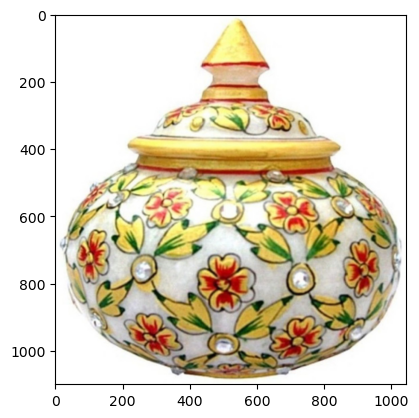

In [93]:
plt.style.use('default')
image = plt.imread("./Input/Images/8f41774c16a931d71fcf01f8fee171e0.jpg")
plt.imshow(image)
image.shape

### 8.1.2 Chargement de l'image en niveaux de gris

Cette opération est nécessaire car les algorithmes de détection de caractéristiques dans opencv (comme ORB) nécessitent une image en niveaux de gris à canal unique (typiquement 8 bits).

Dimension image:(1100, 1044)


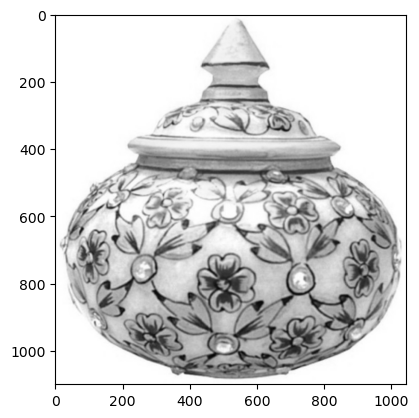

In [94]:
# Conversion de l'image en niveaux de gris
image_gray = cv2.imread("./Input/8f41774c16a931d71fcf01f8fee171e0.jpg", cv2.IMREAD_GRAYSCALE)

plt.imshow(image_gray)
print("Dimension image:" + str(image_gray.shape))

cv2.imwrite("./Input/Images_gray_level_8f41774c16a931d71fcf01f8fee171e0.jpg", image_gray)

# Réouverture de l'image
image_gray = cv2.imread("./Input/Images_gray_level_8f41774c16a931d71fcf01f8fee171e0.jpg")
plt.imshow(image_gray)

### 8.1.3 Réduction du bruit par filtrage médian sur image en niveaux de gris

Dimension image:(1100, 1044)


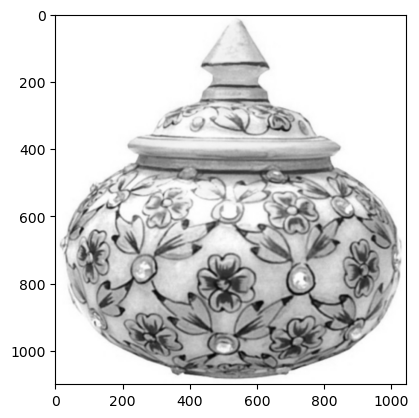

In [95]:
# Conversion de l'image en niveaux de gris
image_gray = cv2.imread("./Input/8f41774c16a931d71fcf01f8fee171e0.jpg", cv2.IMREAD_GRAYSCALE)

# Filtrage médian.
image_filtre_med = cv2.medianBlur(image_gray, 3)
cv2.imwrite("./Input/Images_gray_level_median_8f41774c16a931d71fcf01f8fee171e0.jpg", image_filtre_med)
print("Dimension image:" + str(image_filtre_med.shape))

# Réouverture de l'image
image_filtre_med = cv2.imread("./Input/Images_gray_level_median_8f41774c16a931d71fcf01f8fee171e0.jpg")
plt.imshow(image_filtre_med)

### 8.1.4 Réduction du bruit par filtre gaussien sur image en niveau de gris

Dimension image:(1100, 1044)


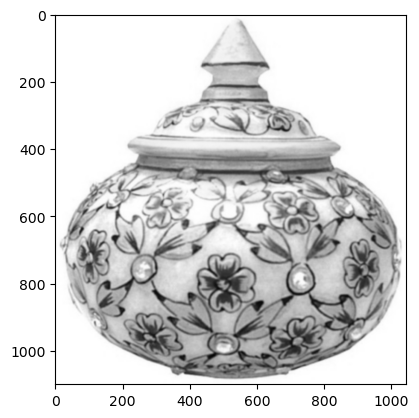

In [1196]:
# Conversion de l'image en niveaux de gris
image_gray = cv2.imread("./Input/8f41774c16a931d71fcf01f8fee171e0.jpg", cv2.IMREAD_GRAYSCALE)

# Filtrage gaussien
image_filtre_gauss = cv2.GaussianBlur(image_gray, (5, 5), 1)

cv2.imwrite("./Input/Images_gray_level_gauss_8f41774c16a931d71fcf01f8fee171e0.jpg", image_filtre_gauss)
print("Dimension image:" + str(image_filtre_gauss.shape))

# Réouverture de l'image
image_filtre_gauss = cv2.imread("./Input/Images_gray_level_gauss_8f41774c16a931d71fcf01f8fee171e0.jpg")
plt.imshow(image_filtre_gauss)

### 8.1.5 Redimensionnement de l'image en taille 224x224 pixels

Les réseaux neruronaux (comme CNN) acceptent (par défaut) en entrée des images de 224x224. Nous allons donc redimensionner toutes les images dans cette dimension en respectant le ratio hauteur/largeur.

In [97]:
image_redim = redimensionne_image("./Input/8f41774c16a931d71fcf01f8fee171e0.jpg", "Images_redim/")

(224, 224, 3)

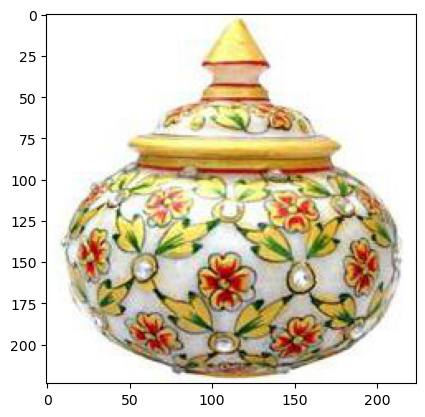

In [98]:
plt.style.use('default')
image = plt.imread("./Images_redim/8f41774c16a931d71fcf01f8fee171e0.jpg")
plt.imshow(image)
image.shape

### 8.1.6 Ajustement automatique du contraste

In [1017]:
image_redim_autocontrast = autocontraste("./Images_redim/8f41774c16a931d71fcf01f8fee171e0.jpg",
                                          "Images_redim_contrast")

(224, 224, 3)

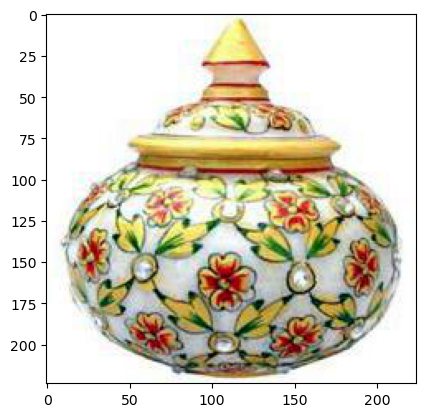

In [1018]:
plt.style.use('default')
image = plt.imread("./Images_redim_contrast/8f41774c16a931d71fcf01f8fee171e0.jpg")
plt.imshow(image)
image.shape

## 8.2 Encodage 9: Création de features - Algorithme SIFT

L'encodage des images comprend les étapes suivantes:
- chargement des images en niveaux de gris
- réduction du bruit avec filtre médian / gaussien
- détection des descripteurs
- création des clusters de desciption par K-means
- création des  features des images (histogramme et bag of visual words)

### 8.2.1 Suppression d'une image dans le dataset

L'image de la ligne avec l'index 343 pose problème lors de la détection des descripteurs, elle est supprimée.

Il reste 1049 images.

In [101]:
# Suppression d'un image (index=343) qui pose problème
df_data_image_idx343 = df_data_image.copy()
df_data_image_idx343.drop(df.index[[343]], inplace=True)
df_data_image_idx343.reset_index(drop=True, inplace=True)
df_data_image_idx343.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1049 entries, 0 to 1048
Data columns (total 5 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   description            1049 non-null   object
 1   product_category_tree  1049 non-null   object
 2   image                  1049 non-null   object
 3   categ_princ            1049 non-null   object
 4   sous_categ             1049 non-null   object
dtypes: object(5)
memory usage: 41.1+ KB


### 8.2.2 Enregistrement des images en niveaux de gris et pré-traitées dans le dataset

In [102]:
# Enregistrement des images des la colonne "imahe_gray_scale" du dataset en niveaux de gris
df_data_image_idx343["image_gray_scale"] = df_data_image_idx343["image"].apply(image_gray_scale,
                                                                               rep_image="Images_gray_scale/")

In [490]:
df_data_image_idx343

,description,product_category_tree,image,categ_princ,sous_categ,image_gray_scale,bovw_sift
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Curtains & Accessories,Images_gray_scale/55b85ea15a1536d46b7190ad6fff...,"[0.0, 1.0, 0.0, 14.0, 0.0, 0.0, 1.0, 0.0, 0.0,..."
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/7b72c92c2f6c40268628ec5f14c6...,"[4.0, 0.0, 1.0, 4.0, 13.0, 0.0, 1.0, 1.0, 0.0,..."
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/64d5d4a258243731dc7bbb1eef49...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,Bed Linen,Images_gray_scale/d4684dcdc759dd9cdf41504698d7...,"[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,Bed Linen,Images_gray_scale/6325b6870c54cd47be6ebfbffa62...,"[1.0, 0.0, 0.0, 4.0, 0.0, 0.0, 1.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...
1044,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/958f54f4c46b53c8a0a9b8167d91...,"[0.0, 0.0, 0.0, 2.0, 28.0, 2.0, 0.0, 0.0, 0.0,..."
1045,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/fd6cbcc22efb6b761bd564c28928...,"[2.0, 1.0, 0.0, 0.0, 0.0, 2.0, 0.0, 3.0, 0.0, ..."
1046,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/5912e037d12774bb73a2048f35a00009.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/5912e037d12774bb73a2048f35a0...,"[3.0, 0.0, 3.0, 20.0, 43.0, 0.0, 1.0, 0.0, 0.0..."
1047,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/c3edc504d1b4f0ba6224fa53a43a...,"[1.0, 0.0, 3.0, 1.0, 8.0, 2.0, 6.0, 1.0, 0.0, ..."


### 8.2.3 Exemple de détermination et affichage des descripteurs SIFT pour une image donnée

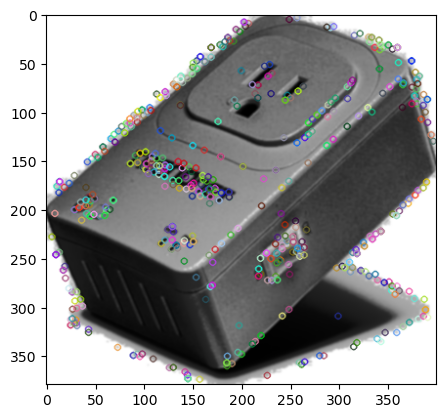

Descripteurs :  (500, 128)

[[ 53.   7.   0. ...   0.   0.   0.]
 [  0.   0.   0. ...  32.   4.   0.]
 [ 85.   4.   0. ...   2.   1.  11.]
 ...
 [145.   0.   0. ...   0.   0.   2.]
 [ 21.   6.   4. ...   0.   2.   5.]
 [ 46.   1.   1. ...   0.   0.   0.]]


In [1197]:
# Exemple de détection des descripteurs sur une image donnée
# Instanciation de SIFT
sift = cv2.xfeatures2d.SIFT_create(500)

# Conversion de l'image en niveaux de gris
img = cv2.imread(df_data_image_idx343["image"][344],0) 

# Equalize image histogram
img = cv2.equalizeHist(img)
    
# Filtrage gaussien pour réduction du bruit
img = cv2.GaussianBlur(img, (5, 5), 1)
            
# Détermination des descripteurs / keypoints
kp, desc = sift.detectAndCompute(img, None)

# Affichage des descripteurs pour l'image
img=cv2.drawKeypoints(img,kp,img)
plt.imshow(img)
plt.show()

print("Descripteurs : ", desc.shape)
print()
print(desc)

L'image contient 500 descripteurs.

Chaque descripteur est un vecteur de longueur 128.

### 8.2.4 Encodage des images par SIFT: détection des descripteurs et création des features

Principes pour la détection des descripteurs:
- pour chaque image passage en gris et equalisation.
- création d'une liste de descripteurs par image ("sift_keypoints_by_img") qui sera utilisée pour réaliser les histogrammes par image.
- création d'une liste de descripteurs pour l'ensemble des images ("sift_keypoints_all") qui sera utilisé pour créer les clusters de descripteurs.

Pour le création des features:
- utilisation de MiniBatchKMeans pour obtenir des temps de traitement raisonnables.
- pour chaque image : 
   - prédiction des numéros de cluster de chaque descripteur
   - création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image



In [105]:
# Appel de la fonction pour détection des descripteurs et création de features pour algorithme SIFT
keypoints_all, df_data_image_sift, image_features = encode_features_sift(df_data_image_idx343)


Nombre de descripteurs :  (506398, 128)

Nombre de clusters estimés :  712
Création de 712 clusters de descripteurs ...
0
100
200
300
400
500
600
700
800
900
1000


In [106]:
df_data_image_sift

,description,product_category_tree,image,categ_princ,sous_categ,image_gray_scale,bovw_sift
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Curtains & Accessories,Images_gray_scale/55b85ea15a1536d46b7190ad6fff...,"[0.0, 1.0, 0.0, 14.0, 0.0, 0.0, 1.0, 0.0, 0.0,..."
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/7b72c92c2f6c40268628ec5f14c6...,"[4.0, 0.0, 1.0, 4.0, 13.0, 0.0, 1.0, 1.0, 0.0,..."
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/64d5d4a258243731dc7bbb1eef49...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,Bed Linen,Images_gray_scale/d4684dcdc759dd9cdf41504698d7...,"[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,Bed Linen,Images_gray_scale/6325b6870c54cd47be6ebfbffa62...,"[1.0, 0.0, 0.0, 4.0, 0.0, 0.0, 1.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...
1044,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/958f54f4c46b53c8a0a9b8167d91...,"[0.0, 0.0, 0.0, 2.0, 28.0, 2.0, 0.0, 0.0, 0.0,..."
1045,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/fd6cbcc22efb6b761bd564c28928...,"[2.0, 1.0, 0.0, 0.0, 0.0, 2.0, 0.0, 3.0, 0.0, ..."
1046,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/5912e037d12774bb73a2048f35a00009.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/5912e037d12774bb73a2048f35a0...,"[3.0, 0.0, 3.0, 20.0, 43.0, 0.0, 1.0, 0.0, 0.0..."
1047,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/c3edc504d1b4f0ba6224fa53a43a...,"[1.0, 0.0, 3.0, 1.0, 8.0, 2.0, 6.0, 1.0, 0.0, ..."


In [986]:
len(image_features[0])

712

## 8.3 Encodage 10:  Extraction features - Réseau neurones pré-entraîné VGG16

### 8.3.1 Redimensionnement des images en 224x224 pixels et ajustement contraste

In [495]:
# Redimensionnment des images en conservant les proportions d'origine en 224*224 pixels
df_data_image_sift["image_redim"] = df_data_image_sift["image"].apply(redimensionne_image, 
                                                                      rep_redim="Image_redim_224x224/")

# Ajustement du contraste des images
df_data_image_sift["image_redim_contrast"] = df_data_image_sift["image_redim"].apply(autocontraste,
                                                                                    rep_redim_contrast="Image_redim_contrast_224x224/")

In [496]:
df_data_image_sift

,description,product_category_tree,image,categ_princ,sous_categ,image_gray_scale,bovw_sift,image_redim,image_redim_contrast
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Curtains & Accessories,Images_gray_scale/55b85ea15a1536d46b7190ad6fff...,"[0.0, 1.0, 0.0, 14.0, 0.0, 0.0, 1.0, 0.0, 0.0,...",Image_redim_224x224/55b85ea15a1536d46b7190ad6f...,Image_redim_contrast_224x224/55b85ea15a1536d46...
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/7b72c92c2f6c40268628ec5f14c6...,"[4.0, 0.0, 1.0, 4.0, 13.0, 0.0, 1.0, 1.0, 0.0,...",Image_redim_224x224/7b72c92c2f6c40268628ec5f14...,Image_redim_contrast_224x224/7b72c92c2f6c40268...
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/64d5d4a258243731dc7bbb1eef49...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",Image_redim_224x224/64d5d4a258243731dc7bbb1eef...,Image_redim_contrast_224x224/64d5d4a258243731d...
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,Bed Linen,Images_gray_scale/d4684dcdc759dd9cdf41504698d7...,"[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",Image_redim_224x224/d4684dcdc759dd9cdf41504698...,Image_redim_contrast_224x224/d4684dcdc759dd9cd...
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,Bed Linen,Images_gray_scale/6325b6870c54cd47be6ebfbffa62...,"[1.0, 0.0, 0.0, 4.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...",Image_redim_224x224/6325b6870c54cd47be6ebfbffa...,Image_redim_contrast_224x224/6325b6870c54cd47b...
...,...,...,...,...,...,...,...,...,...
1044,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/958f54f4c46b53c8a0a9b8167d91...,"[0.0, 0.0, 0.0, 2.0, 28.0, 2.0, 0.0, 0.0, 0.0,...",Image_redim_224x224/958f54f4c46b53c8a0a9b8167d...,Image_redim_contrast_224x224/958f54f4c46b53c8a...
1045,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/fd6cbcc22efb6b761bd564c28928...,"[2.0, 1.0, 0.0, 0.0, 0.0, 2.0, 0.0, 3.0, 0.0, ...",Image_redim_224x224/fd6cbcc22efb6b761bd564c289...,Image_redim_contrast_224x224/fd6cbcc22efb6b761...
1046,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/5912e037d12774bb73a2048f35a00009.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/5912e037d12774bb73a2048f35a0...,"[3.0, 0.0, 3.0, 20.0, 43.0, 0.0, 1.0, 0.0, 0.0...",Image_redim_224x224/5912e037d12774bb73a2048f35...,Image_redim_contrast_224x224/5912e037d12774bb7...
1047,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/c3edc504d1b4f0ba6224fa53a43a...,"[1.0, 0.0, 3.0, 1.0, 8.0, 2.0, 6.0, 1.0, 0.0, ...",Image_redim_224x224/c3edc504d1b4f0ba6224fa53a4...,Image_redim_contrast_224x224/c3edc504d1b4f0ba6...


### 8.3.2 Extraction des features pour VGG16 - Exemple pour une image

In [504]:
vgg16_feature_list_np = extract_features_cnn("VGG16", df_data_image_sift.iloc[[0]])

58900480/58889256 [==============================] - 6s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                              

In [506]:
print("Dimension vecteur par image VGG16 :", len(vgg16_feature_list_np[0]))

Dimension vecteur par image : 25088


### 8.3.3  Extraction features pour VGG16 - Ensemble des images

In [510]:
vgg16_feature_list_np = extract_features_cnn("VGG16", df_data_image_sift)

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

In [511]:
print("Dimension vecteur par image :", len(vgg16_feature_list_np[0]))
print("Nombre total de vecteurs :", len(vgg16_feature_list_np))

Dimension vecteur par image : 25088
Nombre total de vecteurs : 1049


In [512]:
# Intégration des images dans le dataset
df_data_image_sift["img_vgg16"] =  ""

for i in range(df_data_image_sift.shape[0]):
    df_data_image_sift["img_vgg16"][i] = vgg16_feature_list_np[i]

df_data_image_sift

,description,product_category_tree,image,categ_princ,sous_categ,image_gray_scale,bovw_sift,image_redim,image_redim_contrast,img_vgg16
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Curtains & Accessories,Images_gray_scale/55b85ea15a1536d46b7190ad6fff...,"[0.0, 1.0, 0.0, 14.0, 0.0, 0.0, 1.0, 0.0, 0.0,...",Image_redim_224x224/55b85ea15a1536d46b7190ad6f...,Image_redim_contrast_224x224/55b85ea15a1536d46...,"[0.0, 0.0, 0.0, 0.0, 8.8258, 0.0, 0.0, 0.0, 0...."
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/7b72c92c2f6c40268628ec5f14c6...,"[4.0, 0.0, 1.0, 4.0, 13.0, 0.0, 1.0, 1.0, 0.0,...",Image_redim_224x224/7b72c92c2f6c40268628ec5f14...,Image_redim_contrast_224x224/7b72c92c2f6c40268...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/64d5d4a258243731dc7bbb1eef49...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",Image_redim_224x224/64d5d4a258243731dc7bbb1eef...,Image_redim_contrast_224x224/64d5d4a258243731d...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,Bed Linen,Images_gray_scale/d4684dcdc759dd9cdf41504698d7...,"[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",Image_redim_224x224/d4684dcdc759dd9cdf41504698...,Image_redim_contrast_224x224/d4684dcdc759dd9cd...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,Bed Linen,Images_gray_scale/6325b6870c54cd47be6ebfbffa62...,"[1.0, 0.0, 0.0, 4.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...",Image_redim_224x224/6325b6870c54cd47be6ebfbffa...,Image_redim_contrast_224x224/6325b6870c54cd47b...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...,...,...
1044,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/958f54f4c46b53c8a0a9b8167d91...,"[0.0, 0.0, 0.0, 2.0, 28.0, 2.0, 0.0, 0.0, 0.0,...",Image_redim_224x224/958f54f4c46b53c8a0a9b8167d...,Image_redim_contrast_224x224/958f54f4c46b53c8a...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1045,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/fd6cbcc22efb6b761bd564c28928...,"[2.0, 1.0, 0.0, 0.0, 0.0, 2.0, 0.0, 3.0, 0.0, ...",Image_redim_224x224/fd6cbcc22efb6b761bd564c289...,Image_redim_contrast_224x224/fd6cbcc22efb6b761...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/5912e037d12774bb73a2048f35a00009.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/5912e037d12774bb73a2048f35a0...,"[3.0, 0.0, 3.0, 20.0, 43.0, 0.0, 1.0, 0.0, 0.0...",Image_redim_224x224/5912e037d12774bb73a2048f35...,Image_redim_contrast_224x224/5912e037d12774bb7...,"[0.0, 31.598589, 0.0, 0.0, 6.4081283, 5.149060..."
1047,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/c3edc504d1b4f0ba6224fa53a43a...,"[1.0, 0.0, 3.0, 1.0, 8.0, 2.0, 6.0, 1.0, 0.0, ...",Image_redim_224x224/c3edc504d1b4f0ba6224fa53a4...,Image_redim_contrast_224x224

## 8.4 Encodage 11: Extraction features - Réseau neurones pré-entraîné ResNet50

### 8.4.1 Extraction des features pour ResNet50 - Exemple pour une image

In [514]:
resnet50_feature_list_np = extract_features_cnn("ResNet50", df_data_image_sift.iloc[[0]])

94781440/94765736 [==============================] - 9s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_3[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                          

In [515]:
print("Dimension vecteur par image ResNet50 :", len(resnet50_feature_list_np[0]))

Dimension vecteur par image ResNet50 : 100352


### 8.4.2  Extraction features pour ResNet50 - Ensemble des images

In [517]:
resnet50_feature_list_np = extract_features_cnn("ResNet50", df_data_image_sift)

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_5[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                        

In [518]:
print("Dimension vecteur par image :", len(resnet50_feature_list_np[0]))
print("Nombre total de vecteurs :", len(resnet50_feature_list_np))

Dimension vecteur par image : 100352
Nombre total de vecteurs : 1049


In [519]:
# Intégration des images dans le dataset
df_data_image_sift["img_resnet50"] =  ""

for i in range(df_data_image_sift.shape[0]):
    df_data_image_sift["img_resnet50"][i] = resnet50_feature_list_np[i]

df_data_image_sift

,description,product_category_tree,image,categ_princ,sous_categ,image_gray_scale,bovw_sift,image_redim,image_redim_contrast,img_vgg16,img_resnet50
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Curtains & Accessories,Images_gray_scale/55b85ea15a1536d46b7190ad6fff...,"[0.0, 1.0, 0.0, 14.0, 0.0, 0.0, 1.0, 0.0, 0.0,...",Image_redim_224x224/55b85ea15a1536d46b7190ad6f...,Image_redim_contrast_224x224/55b85ea15a1536d46...,"[0.0, 0.0, 0.0, 0.0, 8.8258, 0.0, 0.0, 0.0, 0....","[3.2977567, 0.0, 0.0, 0.15026116, 0.09806049, ..."
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/7b72c92c2f6c40268628ec5f14c6...,"[4.0, 0.0, 1.0, 4.0, 13.0, 0.0, 1.0, 1.0, 0.0,...",Image_redim_224x224/7b72c92c2f6c40268628ec5f14...,Image_redim_contrast_224x224/7b72c92c2f6c40268...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,Baby Bath & Skin,Images_gray_scale/64d5d4a258243731dc7bbb1eef49...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",Image_redim_224x224/64d5d4a258243731dc7bbb1eef...,Image_redim_contrast_224x224/64d5d4a258243731d...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,Bed Linen,Images_gray_scale/d4684dcdc759dd9cdf41504698d7...,"[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",Image_redim_224x224/d4684dcdc759dd9cdf41504698...,Image_redim_contrast_224x224/d4684dcdc759dd9cd...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,Bed Linen,Images_gray_scale/6325b6870c54cd47be6ebfbffa62...,"[1.0, 0.0, 0.0, 4.0, 0.0, 0.0, 1.0, 0.0, 0.0, ...",Image_redim_224x224/6325b6870c54cd47be6ebfbffa...,Image_redim_contrast_224x224/6325b6870c54cd47b...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
...,...,...,...,...,...,...,...,...,...,...,...
1044,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/958f54f4c46b53c8a0a9b8167d9140bc.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/958f54f4c46b53c8a0a9b8167d91...,"[0.0, 0.0, 0.0, 2.0, 28.0, 2.0, 0.0, 0.0, 0.0,...",Image_redim_224x224/958f54f4c46b53c8a0a9b8167d...,Image_redim_contrast_224x224/958f54f4c46b53c8a...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1045,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/fd6cbcc22efb6b761bd564c28928483c.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/fd6cbcc22efb6b761bd564c28928...,"[2.0, 1.0, 0.0, 0.0, 0.0, 2.0, 0.0, 3.0, 0.0, ...",Image_redim_224x224/fd6cbcc22efb6b761bd564c289...,Image_redim_contrast_224x224/fd6cbcc22efb6b761...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
1046,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Images/5912e037d12774bb73a2048f35a00009.jpg,Baby Care,Baby & Kids Gifts,Images_gray_scale/5912e037d12774bb73a2048f35a0...,"[3.0, 0.0, 3.0, 20.0, 43.0, 0.0, 1.0, 0.0, 0.0...",Image_redim_224x224/5912e037d12774bb73a2048f35...,Image_redim_contrast_224x224/5912e037d12774bb7...,"[0.0, 31.598589, 0.0, 0.0, 6.4

# 9. Etude de faisabilité d'un moteur de classification

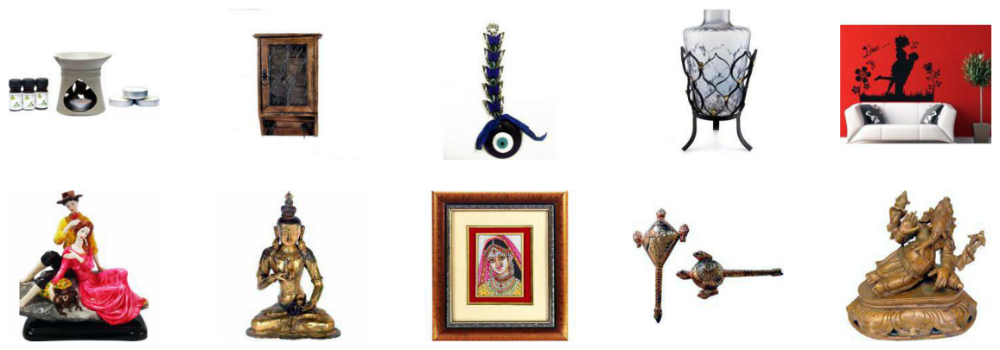

In [1201]:
# Affichage d'un échantillon d'images par catégorie d'articles "Home Decor & Festive Needs"
df = df_data_image_sift.loc[df_data_image_sift["categ_princ"] == 'Home Decor & Festive Needs ']
df = df[:10]
affich_image(df,cat)    

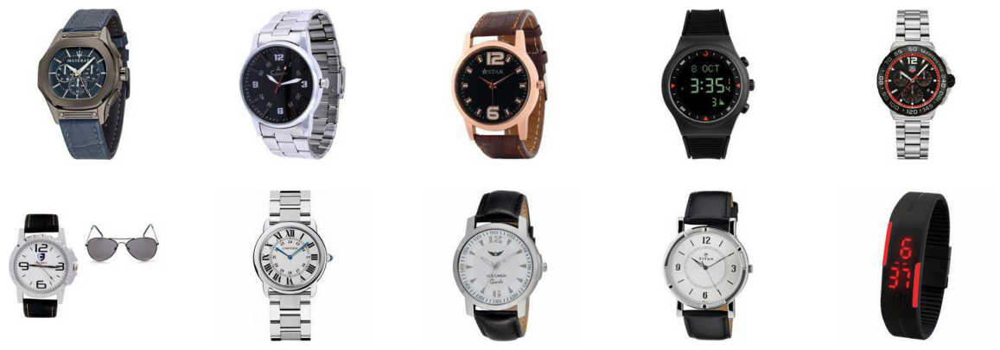

In [1202]:
# Affichage d'un échantillon d'images par catégorie d'articles "Watches"
df = df_data_image_sift.loc[df_data_image_sift["categ_princ"] == 'Watches ']
df = df[:10]
affich_image(df,cat)    

## 9.1 Préparation des données et principes

### 9.1.1 Création d'un dataset commun textes + images

In [107]:
# Suppression de la ligne (indice 343) dans le dataset des colonnes communes
df_data_text.drop(df_data_text.index[[343]], inplace=True)
df_data_text.reset_index(drop=True, inplace=True)
df_data_text

,description,product_category_tree,categ_princ,sous_categ
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Home Furnishing,Curtains & Accessories
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Baby Care,Baby Bath & Skin
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Baby Care,Baby Bath & Skin
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Home Furnishing,Bed Linen
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Home Furnishing,Bed Linen
...,...,...,...,...
1044,Oren Empower Extra Large Self Adhesive Sticker...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Baby Care,Baby & Kids Gifts
1045,Wallmantra Large Vinyl Sticker Sticker (Pack o...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Baby Care,Baby & Kids Gifts
1046,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Baby Care,Baby & Kids Gifts
1047,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",Baby Care,Baby & Kids Gifts


In [108]:
# Suppression de la ligne (indice 343) dans le dataset pour l'encodage texte
df_token_list_description.drop(df_token_list_description.index[[343]], inplace=True)
df_token_list_description.reset_index(drop=True, inplace=True)
df_token_list_description

,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem,tfidf_lemma,tfidf_lemma_mindf,tfidf_lemma_mindf_ngram,enc_doc2vec
0,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.18654299834229843, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.1717100683047162, 0.0, 0.0, 0.0, ...","[-0.06366078555583954, 0.21861758828163147, -0..."
1,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.028805796056985855, 0.0879349634051323, 0...."
2,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.04036976397037506, 0.0015704036923125386, -..."
3,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.17030750215053558, 0.09392877668142319, 0...."
4,key features of jaipur print cotton floral kin...,key features jaipur print cotton floral king s...,key featur jaipur print cotton floral king siz...,key feature jaipur print cotton floral king si...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.1430835723876953, 0.2899129390716553, -0.0..."
...,...,...,...,...,...,...,...,...,...,...,...,...
1044,oren empower extra large self adhesive sticker...,oren empower extra large self adhesive sticker...,oren empow extra larg self adhes sticker pack ...,oren empower extra large self adhesive sticker...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[1.1072421073913574, -0.04564754664897919, -0...."
1045,wallmantra larg

In [523]:
# Concaténation des 3 dataframes
df_data_text_image_enc = pd.concat([df_data_text, df_token_list_description, 
                                   df_data_image_sift[["bovw_sift", "img_vgg16", "img_resnet50"]] ], axis=1)
df_data_text_image_enc

,description,product_category_tree,categ_princ,sous_categ,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem,tfidf_lemma,tfidf_lemma_mindf,tfidf_lemma_mindf_ngram,enc_doc2vec,bovw_sift,img_vgg16,img_resnet50
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Home Furnishing,Curtains & Accessories,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.18654299834229843, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.1717100683047162, 0.0, 0.0, 0.0, ...","[-0.06366078555583954, 0.21861758828163147, -0...","[0.0, 1.0, 0.0, 14.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 8.8258, 0.0, 0.0, 0.0, 0....","[3.2977567, 0.0, 0.0, 0.15026116, 0.09806049, ..."
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Baby Care,Baby Bath & Skin,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.028805796056985855, 0.0879349634051323, 0....","[4.0, 0.0, 1.0, 4.0, 13.0, 0.0, 1.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Baby Care,Baby Bath & Skin,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.04036976397037506, 0.0015704036923125386, -...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Home Furnishing,Bed Linen,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.17030750215053558, 0.09392877668142319, 0....","[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ..."
4,Key Features of Jaipur Print Cotton Floral Kin...,"[""Home Furni

### 9.1.2 Création des labels pour les catégories principales

In [524]:
df_data_text_image_enc["categ_princ"].unique()

array(['Home Furnishing ', 'Baby Care ', 'Watches ',
       'Home Decor & Festive Needs ', 'Kitchen & Dining ',
       'Beauty and Personal Care ', 'Computers '], dtype=object)

In [525]:
label_enc = LabelEncoder()
df_data_text_image_enc["label_cat_true"] = label_enc.fit_transform(df_data_text_image_enc["categ_princ"])
df_data_text_image_enc

,description,product_category_tree,categ_princ,sous_categ,description_token,description_token_sw,description_token_sw_stem,description_token_sw_lemma,enc_bow_stem,enc_bow_lemma,enc_bow_lemma_mindf,tfidf_stem,tfidf_lemma,tfidf_lemma_mindf,tfidf_lemma_mindf_ngram,enc_doc2vec,bovw_sift,img_vgg16,img_resnet50,label_cat_true
0,Key Features of Elegance Polyester Multicolor ...,"[""Home Furnishing >> Curtains & Accessories >>...",Home Furnishing,Curtains & Accessories,key features of elegance polyester multicolor ...,key features elegance polyester multicolor abs...,key featur eleg polyest multicolor abstract ey...,key feature elegance polyester multicolor abst...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 4.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.18654299834229843, 0.0, 0.0, 0.0,...","[0.0, 0.0, 0.1717100683047162, 0.0, 0.0, 0.0, ...","[-0.06366078555583954, 0.21861758828163147, -0...","[0.0, 1.0, 0.0, 14.0, 0.0, 0.0, 1.0, 0.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 8.8258, 0.0, 0.0, 0.0, 0....","[3.2977567, 0.0, 0.0, 0.15026116, 0.09806049, ...",4
1,Specifications of Sathiyas Cotton Bath Towel (...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Baby Care,Baby Bath & Skin,specifications of sathiyas cotton bath towel b...,specifications sathiyas cotton bath towel bath...,specif sathiya cotton bath towel bath towel re...,specification sathiyas cotton bath towel bath ...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.028805796056985855, 0.0879349634051323, 0....","[4.0, 0.0, 1.0, 4.0, 13.0, 0.0, 1.0, 1.0, 0.0,...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0
2,Key Features of Eurospa Cotton Terry Face Towe...,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",Baby Care,Baby Bath & Skin,key features of eurospa cotton terry face towe...,key features eurospa cotton terry face towel s...,key featur eurospa cotton terri face towel set...,key feature eurospa cotton terry face towel se...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.04036976397037506, 0.0015704036923125386, -...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0
3,Key Features of SANTOSH ROYAL FASHION Cotton P...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",Home Furnishing,Bed Linen,key features of santosh royal fashion cotton p...,key features santosh royal fashion cotton prin...,key featur santosh royal fashion cotton print ...,key feature santosh royal fashion cotton print...,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[-0.17030750215053558, 0.09392877668142319, 0....","[0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...","[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",4
4,Key Features of Jaipur Print Cotton Flora

In [526]:
df_data_text_image_enc.groupby("label_cat_true").count()[["categ_princ"]]

,categ_princ
label_cat_true,
0,150
1,150
2,149
3,150
4,150
5,150
6,150


### 9.1.3 Extraction des features pour étude de faisabilité

In [527]:
# Extraction des données features texte et image pour clustering
df_bow_stem = extract_data_features_text_images(df_data_text_image_enc, "enc_bow_stem")
df_bow_lemma = extract_data_features_text_images(df_data_text_image_enc, "enc_bow_lemma")
df_bow_lemma_mindf = extract_data_features_text_images(df_data_text_image_enc, "enc_bow_lemma_mindf")
df_tfidf_stem = extract_data_features_text_images(df_data_text_image_enc, "tfidf_stem")
df_tfidf_lemma = extract_data_features_text_images(df_data_text_image_enc, "tfidf_lemma")
df_tfidf_lemma_mindf = extract_data_features_text_images(df_data_text_image_enc, "tfidf_lemma_mindf")
df_tfidf_lemma_mindf_ngram = extract_data_features_text_images(df_data_text_image_enc, 
                                                               "tfidf_lemma_mindf_ngram")
df_doc2vec = extract_data_features_text_images(df_data_text_image_enc, "enc_doc2vec")
df_bovw_sift = extract_data_features_text_images(df_data_text_image_enc, "bovw_sift")
df_vgg16 = extract_data_features_text_images(df_data_text_image_enc, "img_vgg16")
df_resnet50 = extract_data_features_text_images(df_data_text_image_enc, "img_resnet50")

print("Taille vecteurs bow stem :", df_bow_stem.shape[1])
print("Taille vecteurs bow lemma :", df_bow_lemma.shape[1])
print("Taille vecteurs bow lemma mindf :", df_bow_lemma_mindf.shape[1])
print("Taille vecteurs tfidf stem :", df_tfidf_stem.shape[1])
print("Taille vecteurs tfidf lemma :", df_tfidf_lemma.shape[1])
print("Taille vecteurs tfidf lemma mindf :", df_tfidf_lemma_mindf.shape[1])
print("Taille vecteurs tfidf lemma mindf ngram :", df_tfidf_lemma_mindf_ngram.shape[1])
print("Taille vecteurs doc2vec :", df_doc2vec.shape[1])
print("Taille vecteurs bovw sift :", df_bovw_sift.shape[1])
print("Taille vecteurs img VGG16 :", df_vgg16.shape[1])
print("Taille vecteurs img ResNet50 :", df_resnet50.shape[1])

Taille vecteurs bow stem : 3817
Taille vecteurs bow lemma : 4130
Taille vecteurs bow lemma mindf : 1015
Taille vecteurs tfidf stem : 3817
Taille vecteurs tfidf lemma : 4130
Taille vecteurs tfidf lemma mindf : 1015
Taille vecteurs tfidf lemma mindf ngram : 2346
Taille vecteurs doc2vec : 1000
Taille vecteurs bovw sift : 712
Taille vecteurs img VGG16 : 25088
Taille vecteurs img ResNet50 : 100352


In [728]:
# Concaténation des features textes + images
df_tfidf_resnet50 = concat_df(df_tfidf_lemma_mindf_ngram, df_resnet50)

### 9.1.4 Principes de l'étude de faisabilité

**Etape 1: réduction de dimensions PCA et/ou modélisation NMF**

Réduction PCA sur les features (textes / images) encodées.

La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension, tout en gardant un niveau de variance expliquée élevé (95%).

La modélisation NMF (Non-negative Matrix Factorisation) fait référence à la réduction du calcul par décompression de la matrice de données non-négatives dans le produit de deux petites matrices où X ≈ B×W

X est la matrice de l'ensemble de données, est une matrice n×p , chaque colonne représente une caractéristique, un total de p caractéristiques ; N est un n × k matrice, qui est compris comme k base; W est une matrice k×p et chaque colonne est une projection de l'ensemble de données X sur B.

Dans le cas de la reconnaissance faciale, supposons que chaque photo possède 1 000 features.

Dans le processus PCA, la caractéristique est réduite à 600 dimensions, et chaque face après la dimension réduite contient 600 caractéristiques. En effet, le processus de réduction de la dimensionnalité équivaut à supprimer certaines des caractéristiques détaillées, ce qui entraîne la perte de certaines informations. La manifestation la plus intuitive de l'image est le flou.

Dans le traitement NMF, ces 1000 caractéristiques sont effectivement séparées. La matrice de données X est divisée en le produit des vecteurs de base B et des poids W : X ≈ B × W

Parmi eux, le poids W est compris comme le poids caractéristique, tel que le nez, l'oreille, la bouche, etc. En d'autres termes:
X ≈ B × w1 + B × w2 + …… + B × w1000

En d'autres termes, un visage humain est superposé par ces caractéristiques indépendantes, telles que le nez et les oreilles.

**Globalement, le visage traité par PCA ne distingue pas quel trait spécifique correspond à quelle partie, mais reflète uniformément tous les traits d'une photo ; NMF est une sorte d'idée « additive », différentes caractéristiques correspondent à différents détails du visage, superposant ces détails pour former un visage.**

**Etape 2: clustering k-means sur sortie PCA et/ou NMF**

Initialisation du k-means avec nombre de clusters = 7.

**Etape 3: Visualisation T-SNE 2D à partir de la vérité terrain**

Visualisation T-SNE avec les labels correspondant aux catégories principales des articles.

**Etape 4: Visualisation T-SNE 2D à partir des labels des clusters**

Visualisation T-SNE avec les labels correspondant aux clusters k-means.

**Etape 5: Analyse de la similarité des regroupements selon les catégories d'articles et les labels dsc clusters k-means**

Calcul du ARI score (métrique principale) entre les regroupements selon les catégories d'articles et les labels dsc clusters k-means.

**Etape 6: Analyse de la qualité du clustering - coefficient de silhouette**

Calcul du coefficient de silhouette (métrique secondaire) surles clusters k-means.

**Etape 7: Analyse de la qualité du clustering - matrice de confusion**

Calcul et affichage de la matrice de confusion à partir des labels de catégories d'article et des labels des clusters en fonction de la catégorie d'articles majoritaire.

## 9.2 Encodage 1: encodage textes avec Bag of Word et stemming

### 9.2.1 Réduction de dimensions PCA

In [114]:
# Réduction de dimension PCA
feat_pca_bow_stem = calcul_pca(df_bow_stem, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 3817)
Dimensions dataset après réduction PCA :  (1049, 285)


### 9.2.2 Clustering k-means sur sortie PCA

In [812]:
# Création d'une dataframe pour les scores des métriques du clustering pour les différents encodages
df_cluster_scores = pd.DataFrame(columns=["hyp encodage", "type encodage", "silhouette score", "ari score"], 
                                 index=range(0, 12))

# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_bow_stem = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [144]:
nbre_clusters = 7

In [305]:
hyp_encodage_enc1 = 1
encodage_txt_1 = feat_pca_bow_stem
desc_encodage_txt_1 = "PCA_txt_bow_stem"

# Clustering k-means
model_kmeans_enc1, silhouette_enc1, ari_enc1, results_kmeans_enc1 = clustering_kmeans(feat_pca_bow_stem
                                                                                      , nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.27
Score moyen Adjusted Rand index (ARI) : 0.06


In [813]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_bow_stem = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_bow_stem,
                                                                              hyp_encodage_enc1, desc_encodage_txt_1, "texte", 
                                                                              silhouette_enc1, ari_enc1, results_kmeans_enc1)

In [814]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN


In [815]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_bow_stem

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_bow_stem,texte,0,13
1,PCA_txt_bow_stem,texte,1,2
2,PCA_txt_bow_stem,texte,2,11
3,PCA_txt_bow_stem,texte,3,594
4,PCA_txt_bow_stem,texte,4,77
5,PCA_txt_bow_stem,texte,5,310
6,PCA_txt_bow_stem,texte,6,42


### 9.2.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérite terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [316]:
data_tsne_text_enc1 = classif_tsne(feat_pca_bow_stem, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.005s...
[t-SNE] Computed neighbors for 1049 samples in 0.058s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 1.060657
[t-SNE] KL divergence after 250 iterations with early exaggeration: 69.401817
[t-SNE] KL divergence after 300 iterations: 0.840778


In [317]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc1 = pd.DataFrame()
df_tsne_text_2d_enc1["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc1['tsne-2d-axe 1'] = data_tsne_text_enc1[:,0]
df_tsne_text_2d_enc1['tsne-2d-axe 2'] = data_tsne_text_enc1[:,1]
df_tsne_text_2d_enc1

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,0.020368,17.678444
1,Baby Care,-10.440958,2.872711
2,Baby Care,-11.338646,3.820371
3,Home Furnishing,-3.987697,16.278717
4,Home Furnishing,-3.991724,16.369020
...,...,...,...
1044,Baby Care,7.021372,15.784792
1045,Baby Care,2.432178,-3.939492
1046,Baby Care,2.384969,-5.065626
1047,Baby Care,2.339415,-4.476934


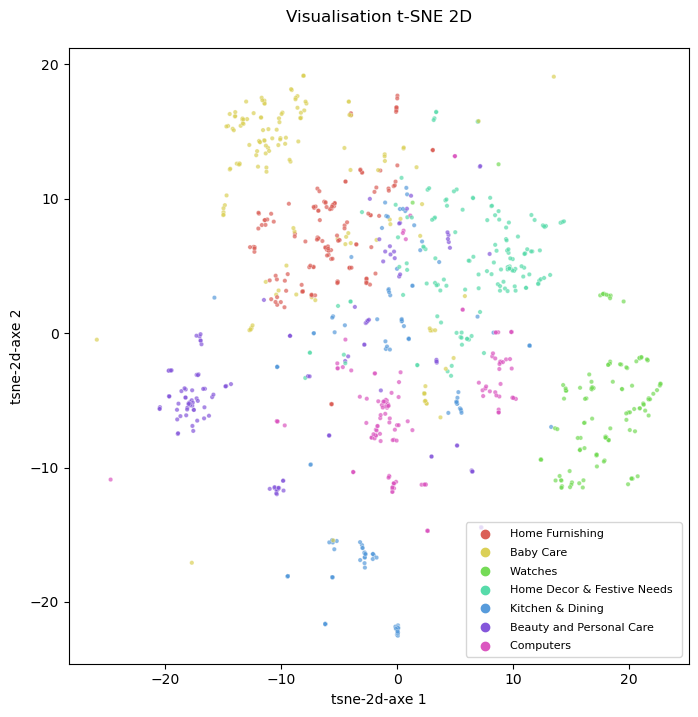

In [318]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc1,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes distincts, mais avec des chevauchements entre les groupes de catégories d'articles (notamment "Baby Care" et "Beauty and Personal Care"). 

### 9.2.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [349]:
# Préparation des données
df_tsne_text_2d_enc1["label_kmeans"] = model_kmeans_enc1.labels_
df_tsne_text_2d_enc1

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,0.020368,17.678444,5
1,Baby Care,-10.440958,2.872711,5
2,Baby Care,-11.338646,3.820371,5
3,Home Furnishing,-3.987697,16.278717,5
4,Home Furnishing,-3.991724,16.369020,5
...,...,...,...,...
1044,Baby Care,7.021372,15.784792,5
1045,Baby Care,2.432178,-3.939492,5
1046,Baby Care,2.384969,-5.065626,3
1047,Baby Care,2.339415,-4.476934,3


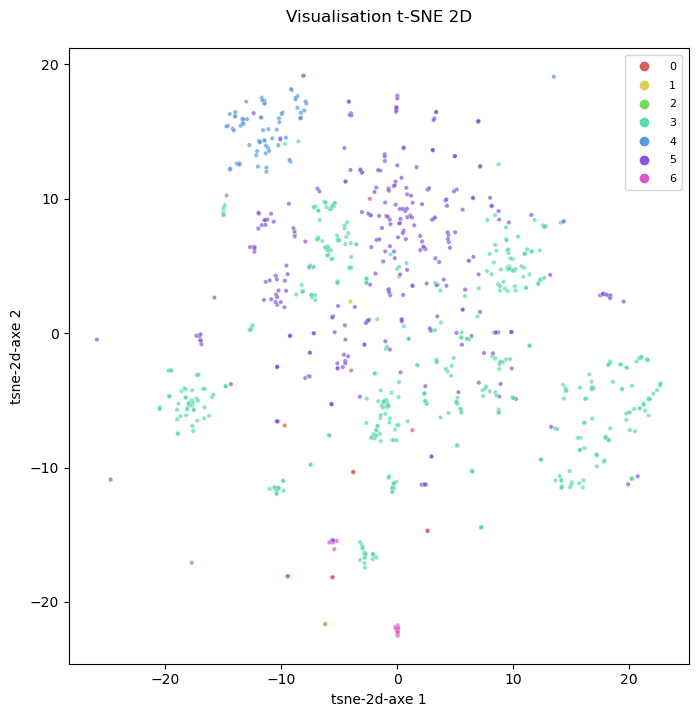

In [350]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc1,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 3 et 5 très importants, les autres de petite taille) avec des chevauchements entre les clusters.

   ### 9.2.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**L'indice de rand ajusté (ARI)** est utilisé pour mesurer la similarité des points de données présents dans les clusters, c'est-à-dire la similarité des instances présentes dans le cluster. 

Ainsi, cette mesure doit être aussi élevée que possible, sinon nous pouvons supposer que les points de données sont attribués au hasard dans les clusters.

Avec ARI, au lieu de compter les éléments individuels, on compte les paires d'éléments correctement classées.

**Le score ARI de 0,06 est très mauvais (proche de 0)**, ce qui signifie que pratiquement aucune paire entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) est classée de la même manière sous les deux regroupements. 

Il n'y pratiquement pas de similitude entre les catégories d'articles et les clusters.

### 9.2.6 Qualité du clustering - Coefficient de silhouette

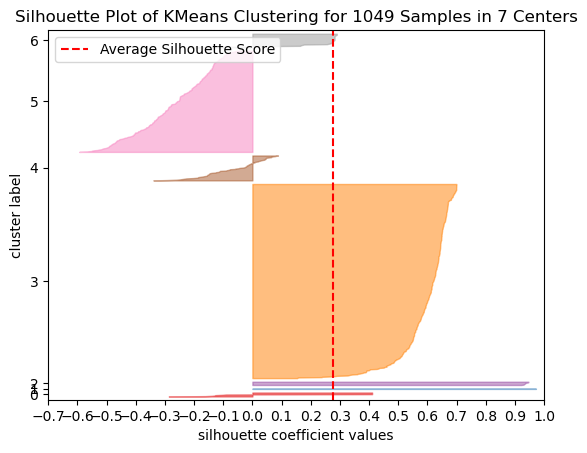

In [322]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_1, model_kmeans_enc1)

Le graphique ci-dessus montre:
- des clusters (4 et 5) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que les données appartenant aux clusters peuvent être erronées/incorrectes.
- des clusters disproportionnés en taille (exemple: cluster 1 avec 2 articles et cluster 3 avec 594 articles)
- un score de silhouette moyenne médioce (0,27).

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters, avec des chevauchements de clusters.

### 9.2.7 Qualité du clustering - Affichage matrice de confusion

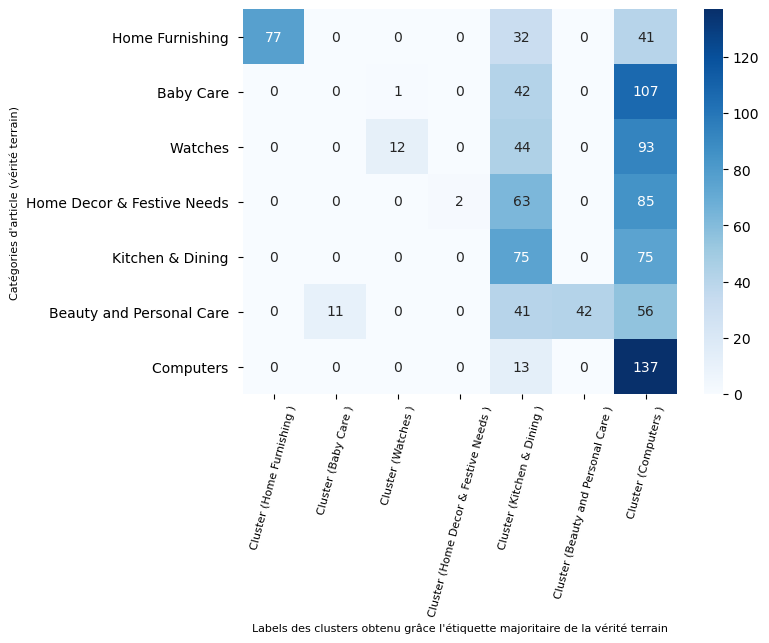

In [1122]:
# Réorganisation forcée de la matrice de confusion
argmax = np.array([2, 3, 1, 6, 0, 4, 5])

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc1.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 5ème et 7ème clusters (très volumineux en nombre d'articles) et que les autres clusters ne contiennent pratiquement pas d'articles.

## 9.3 Encodage 2: encodage textes avec Bag of Words et lemmatisation 

### 9.3.1 Réduction de dimensions PCA

In [128]:
# Réduction de dimension PCA
feat_pca_bow_lemma = calcul_pca(df_bow_lemma, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 4130)
Dimensions dataset après réduction PCA :  (1049, 288)


### 9.3.2 Clustering k-means sur sortie PCA

In [817]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_bow_lemma = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [326]:
hyp_encodage_enc2 = 2
encodage_txt_2 = feat_pca_bow_lemma
desc_encodage_txt_2 = "PCA_txt_bow_lemma"

# Clustering k-means
model_kmeans_enc2, silhouette_enc2, ari_enc2, results_kmeans_enc2 = clustering_kmeans(feat_pca_bow_lemma, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.27
Score moyen Adjusted Rand index (ARI) : 0.05


In [818]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_bow_lemma = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_bow_lemma,
                                                                              hyp_encodage_enc2, desc_encodage_txt_2, "texte", 
                                                                              silhouette_enc2, ari_enc2, results_kmeans_enc2)

In [819]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN


In [820]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_bow_lemma

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_bow_lemma,texte,0,1
1,PCA_txt_bow_lemma,texte,1,585
2,PCA_txt_bow_lemma,texte,2,11
3,PCA_txt_bow_lemma,texte,3,403
4,PCA_txt_bow_lemma,texte,4,31
5,PCA_txt_bow_lemma,texte,5,5
6,PCA_txt_bow_lemma,texte,6,13


### 9.3.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [330]:
data_tsne_text_enc2 = classif_tsne(feat_pca_bow_lemma, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.000s...
[t-SNE] Computed neighbors for 1049 samples in 0.063s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 1.059865
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.429779
[t-SNE] KL divergence after 300 iterations: 0.805461


In [331]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc2 = pd.DataFrame()
df_tsne_text_2d_enc2["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc2['tsne-2d-axe 1'] = data_tsne_text_enc2[:,0]
df_tsne_text_2d_enc2['tsne-2d-axe 2'] = data_tsne_text_enc2[:,1]
df_tsne_text_2d_enc2

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,-3.054892,-17.315681
1,Baby Care,-9.112119,-4.081340
2,Baby Care,-9.707230,-5.153334
3,Home Furnishing,-10.626667,-14.350286
4,Home Furnishing,-10.637951,-14.432777
...,...,...,...
1044,Baby Care,1.088381,-14.850004
1045,Baby Care,8.006864,-2.140895
1046,Baby Care,7.795066,-1.104240
1047,Baby Care,7.914903,-1.659339


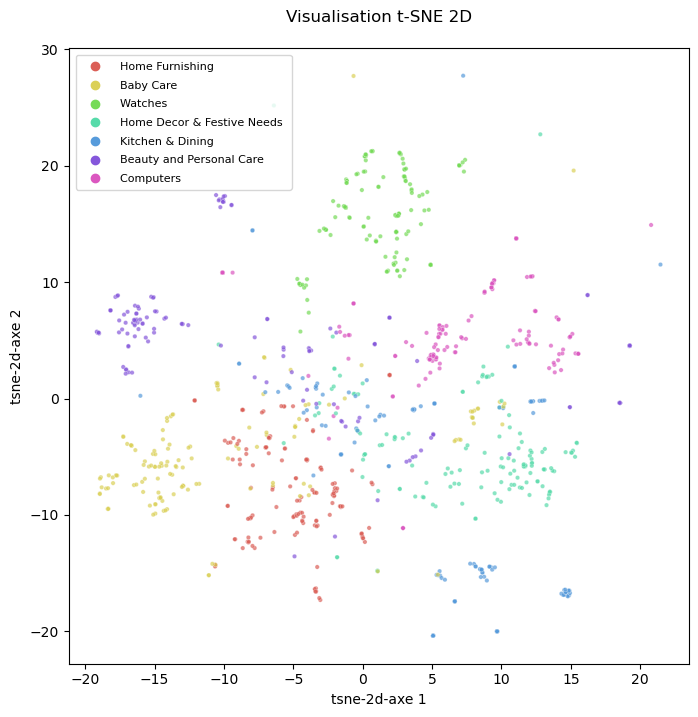

In [332]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc2,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'article) sur le T-SNE montre des groupes assez distincts, mais avec des chevauchements entre les groupes de catégories d'article ("Beauty and Personal Care", "Home Decor and Festive Needs" et "Baby Care" principalement). 

### 9.3.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [351]:
# Préparation des données
df_tsne_text_2d_enc2["label_kmeans"] = model_kmeans_enc2.labels_
df_tsne_text_2d_enc2

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,-3.054892,-17.315681,3
1,Baby Care,-9.112119,-4.081340,3
2,Baby Care,-9.707230,-5.153334,3
3,Home Furnishing,-10.626667,-14.350286,3
4,Home Furnishing,-10.637951,-14.432777,3
...,...,...,...,...
1044,Baby Care,1.088381,-14.850004,3
1045,Baby Care,8.006864,-2.140895,3
1046,Baby Care,7.795066,-1.104240,1
1047,Baby Care,7.914903,-1.659339,1


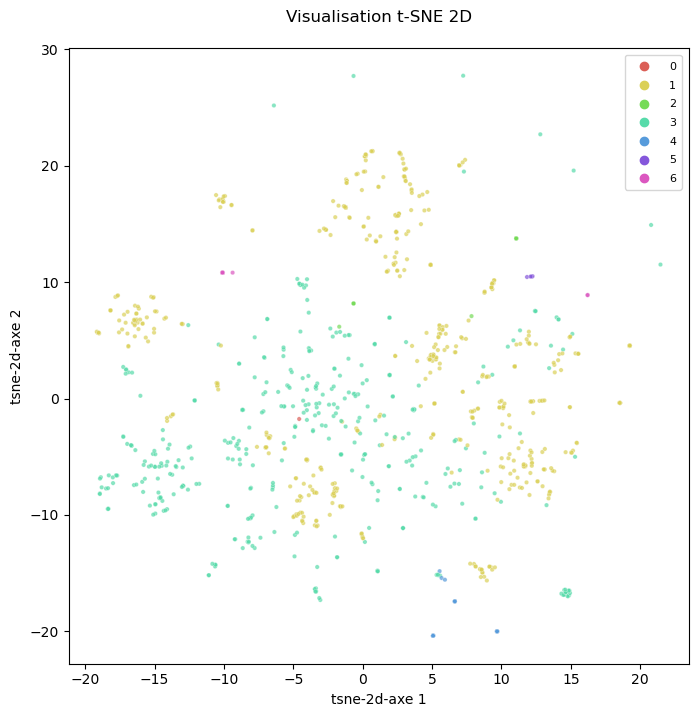

In [352]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc2,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 1 et 3 très importants, les autres de très petite taille) avec des chevauchements entre les clusters.

   ### 9.3.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,05 est très mauvais (proche de 0)**, ce qui signifie que pratiquement aucune paire entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) est classée de la même manière sous les deux regroupements.

Il n'y a pratiquement pas de similitude entre les catégories d'article et les clusters k-means.

### 9.3.6 Qualité du clustering - Coefficient de silhouette

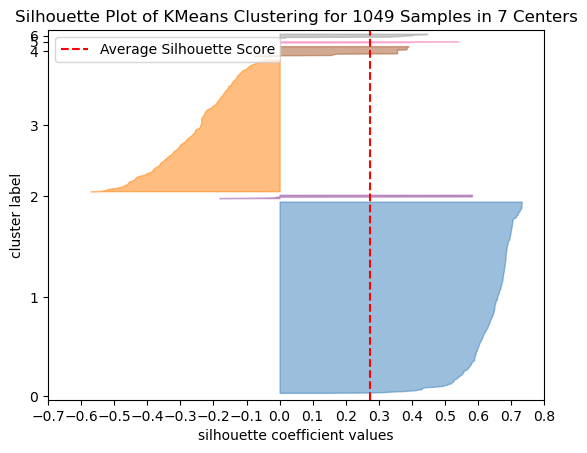

In [335]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_2, model_kmeans_enc2)

Le graphique ci-dessus montre:
- un cluster (3) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que les données appartenant à ce cluster peuvent être erronées/incorrectes. 
- des clusters disproportionnés en taille (exemple: cluster 0 avec 1 article et cluster 1 avec 585 articles)
- un score de silhouette moyenne médioce (0,27).

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters, il y a des chevauchements entre clusters.

### 9.3.7 Qualité du clustering - Affichage matrice de confusion

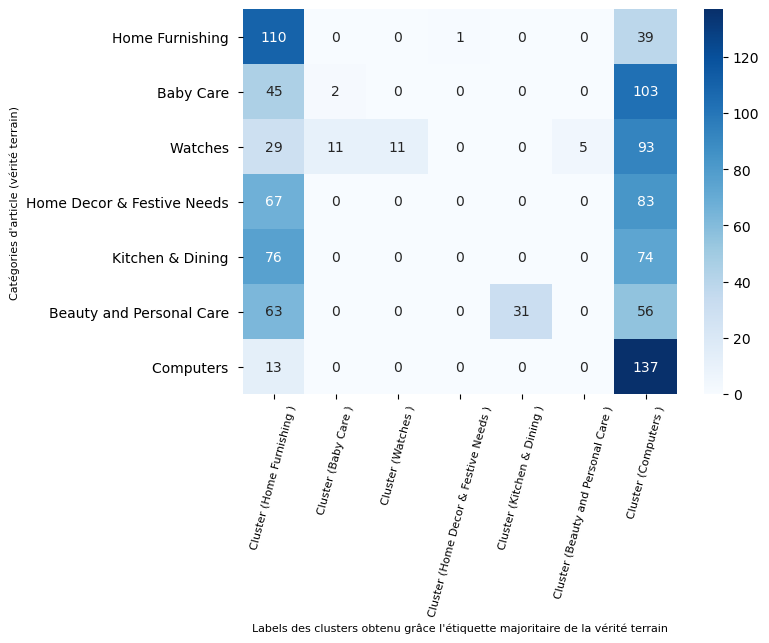

In [1129]:
# Réorganisation forcée de la matrice de confusion
argmax = np.array([3, 6, 2, 0, 4, 5, 1])

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc2.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 1er et 7ème clusters 1(très volumineux en nombre d'articles) et que les autres clusters ne contiennent pratiquement pas d'articles.

## 9.4 Encodage 3: encodage textes - Bag of Words et lemmatisation / mindf

### 9.4.1 Réduction de dimensions PCA

In [179]:
# Réduction de dimension PCA
feat_pca_bow_lemma_mindf = calcul_pca(df_bow_lemma_mindf, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 1015)
Dimensions dataset après réduction PCA :  (1049, 206)


### 9.4.2 Clustering k-means sur sortie PCA

In [822]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_bow_lemma_mindf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [338]:
hyp_encodage_enc3 = 3
encodage_txt_3 = feat_pca_bow_lemma_mindf
desc_encodage_txt_3 = "PCA_txt_bow_lemma_mindf"

# Clustering k-means
model_kmeans_enc3, silhouette_enc3, ari_enc3, results_kmeans_enc3 = clustering_kmeans(feat_pca_bow_lemma_mindf, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.28
Score moyen Adjusted Rand index (ARI) : 0.06


In [823]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_bow_lemma_mindf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_bow_lemma_mindf,
                                                                              hyp_encodage_enc3, desc_encodage_txt_3, "texte", 
                                                                              silhouette_enc3, ari_enc3, results_kmeans_enc3)

In [824]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN


In [825]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_bow_lemma_mindf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_bow_lemma_mindf,texte,0,604
1,PCA_txt_bow_lemma_mindf,texte,1,21
2,PCA_txt_bow_lemma_mindf,texte,2,1
3,PCA_txt_bow_lemma_mindf,texte,3,31
4,PCA_txt_bow_lemma_mindf,texte,4,6
5,PCA_txt_bow_lemma_mindf,texte,5,307
6,PCA_txt_bow_lemma_mindf,texte,6,79


### 9.4.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [342]:
data_tsne_text_enc3 = classif_tsne(feat_pca_bow_lemma_mindf, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.001s...
[t-SNE] Computed neighbors for 1049 samples in 0.051s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.963513
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.437897
[t-SNE] KL divergence after 300 iterations: 0.793174


In [343]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc3 = pd.DataFrame()
df_tsne_text_2d_enc3["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc3['tsne-2d-axe 1'] = data_tsne_text_enc3[:,0]
df_tsne_text_2d_enc3['tsne-2d-axe 2'] = data_tsne_text_enc3[:,1]
df_tsne_text_2d_enc3

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,1.076411,-19.019156
1,Baby Care,11.117671,-2.637898
2,Baby Care,12.105380,-4.037268
3,Home Furnishing,7.859835,-15.400466
4,Home Furnishing,7.827791,-15.496931
...,...,...,...
1044,Baby Care,-5.895985,-13.518296
1045,Baby Care,-16.570642,-0.620651
1046,Baby Care,-15.575955,0.180707
1047,Baby Care,-16.313467,-0.312929


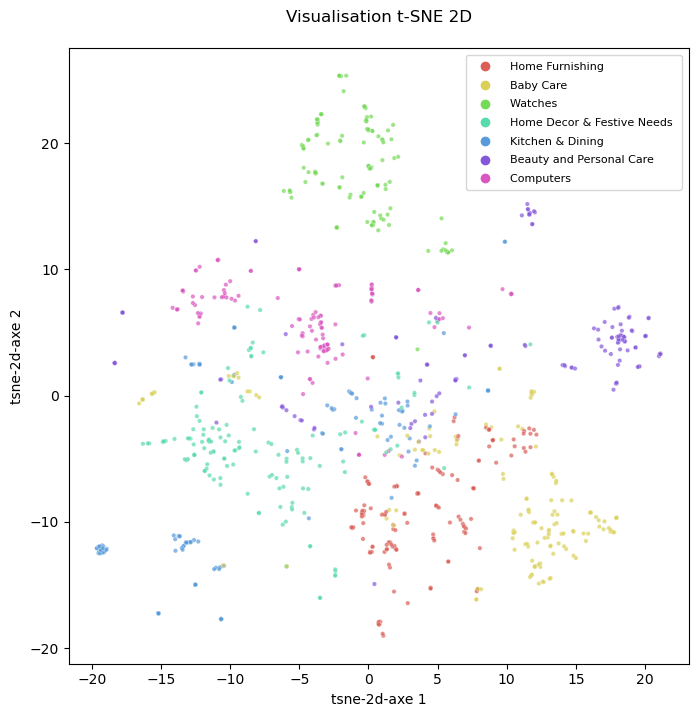

In [344]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc3,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes relativement distincts, mais avec des chevauchements entre les groupes de catégories d'articles ("Baby Care" et "Beauty and Personal Care" principalement). 

### 9.4.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [353]:
# Préparation des données
df_tsne_text_2d_enc3["label_kmeans"] = model_kmeans_enc3.labels_
df_tsne_text_2d_enc3

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,1.076411,-19.019156,5
1,Baby Care,11.117671,-2.637898,5
2,Baby Care,12.105380,-4.037268,5
3,Home Furnishing,7.859835,-15.400466,5
4,Home Furnishing,7.827791,-15.496931,5
...,...,...,...,...
1044,Baby Care,-5.895985,-13.518296,5
1045,Baby Care,-16.570642,-0.620651,5
1046,Baby Care,-15.575955,0.180707,0
1047,Baby Care,-16.313467,-0.312929,0


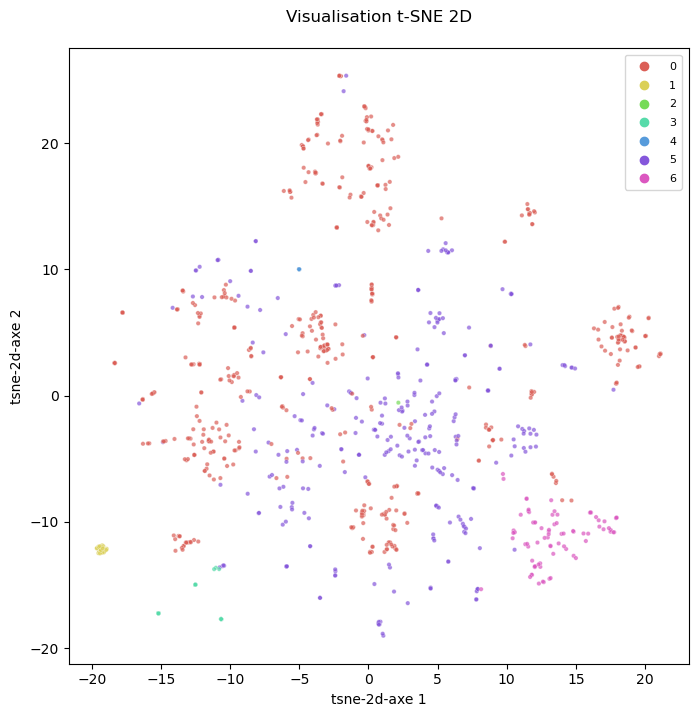

In [354]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc3,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 0 et 5 très importants, les autres de petite taille) avec des chevauchements entre les clusters.

   ### 9.4.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,06 est très mauvais (proche de 0)**, ce qui signifie que pratiquement aucune paire entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) est classée de la même manière sous les deux regroupements.

Il n'y a pratiquement pas de similitude entre la catégorie d'articles et les labels de clusters k-means.

### 9.4.6 Qualité du clustering - Coefficient de silhouette

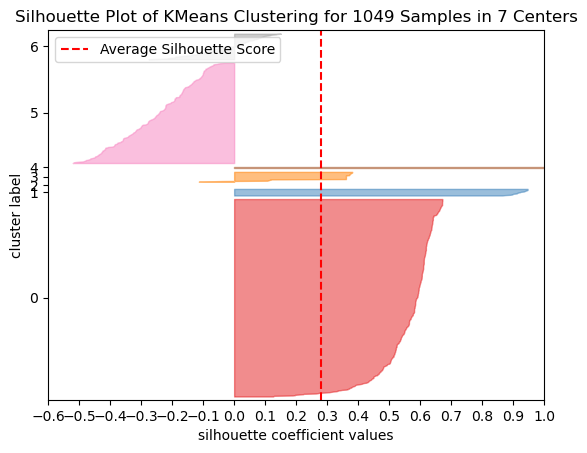

In [355]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_3, model_kmeans_enc3)

Le graphique ci-dessus montre:
- un cluster (5) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que les données appartenant à ce cluster peuvent être erronées ou incorrectes.
- des clusters disproportionnés en taille (exemple: cluster 0 et 5 par rapport aux autres clusters)
- un score de silhouette moyen médiocre (0,28).

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters en groupes denses et séparés.

### 9.4.7 Qualité du clustering - Affichage matrice de confusion

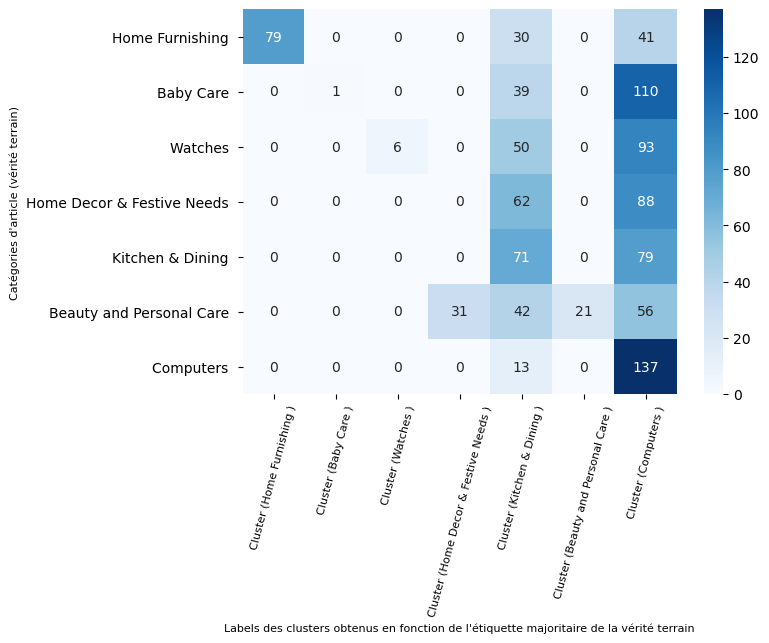

In [1192]:
# Réorganisation forcée de la matrice de confusion
argmax = np.array([6, 5, 1, 3, 2, 4, 0])

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc3.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 5ème et 7ème clusters (très volumineux en nombre d'articles) et que les autres clusters ne contiennent pratiquement pas d'articles.

## 9.5 Encodage 4: encodage textes - TF-IDF avec stemming

### 9.5.1 Réduction de dimensions PCA

In [206]:
# Réduction de dimension PCA
feat_pca_tfidf_stem= calcul_pca(df_tfidf_stem, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 3817)
Dimensions dataset après réduction PCA :  (1049, 614)


### 9.5.2 Clustering k-means sur sortie PCA

In [827]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_tfidf_stem = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [358]:
hyp_encodage_enc4 = 4
encodage_txt_4 = feat_pca_tfidf_stem
desc_encodage_txt_4 = "PCA_txt_tfidf_stem"

# Clustering k-means
model_kmeans_enc4, silhouette_enc4, ari_enc4, results_kmeans_enc4 = clustering_kmeans(feat_pca_tfidf_stem, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.05
Score moyen Adjusted Rand index (ARI) : 0.23


In [828]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_tfidf_stem = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_tfidf_stem,
                                                                              hyp_encodage_enc4, desc_encodage_txt_4, "texte", 
                                                                              silhouette_enc4, ari_enc4, results_kmeans_enc4)

In [829]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN


In [830]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_tfidf_stem

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_tfidf_stem,texte,0,115
1,PCA_txt_tfidf_stem,texte,1,337
2,PCA_txt_tfidf_stem,texte,2,243
3,PCA_txt_tfidf_stem,texte,3,80
4,PCA_txt_tfidf_stem,texte,4,25
5,PCA_txt_tfidf_stem,texte,5,175
6,PCA_txt_tfidf_stem,texte,6,74


### 9.5.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [368]:
data_tsne_text_enc4 = classif_tsne(feat_pca_tfidf_stem, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.001s...
[t-SNE] Computed neighbors for 1049 samples in 0.331s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.405047
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.382988
[t-SNE] KL divergence after 300 iterations: 1.083579


In [369]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc4 = pd.DataFrame()
df_tsne_text_2d_enc4["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc4['tsne-2d-axe 1'] = data_tsne_text_enc4[:,0]
df_tsne_text_2d_enc4['tsne-2d-axe 2'] = data_tsne_text_enc4[:,1]
df_tsne_text_2d_enc4

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,8.622527,-1.662351
1,Baby Care,6.885550,-5.295313
2,Baby Care,7.860322,-5.616447
3,Home Furnishing,13.400901,0.629665
4,Home Furnishing,13.441943,0.625720
...,...,...,...
1044,Baby Care,2.873500,3.820001
1045,Baby Care,2.846473,3.662867
1046,Baby Care,-2.677017,-5.608251
1047,Baby Care,-2.932650,-4.797688


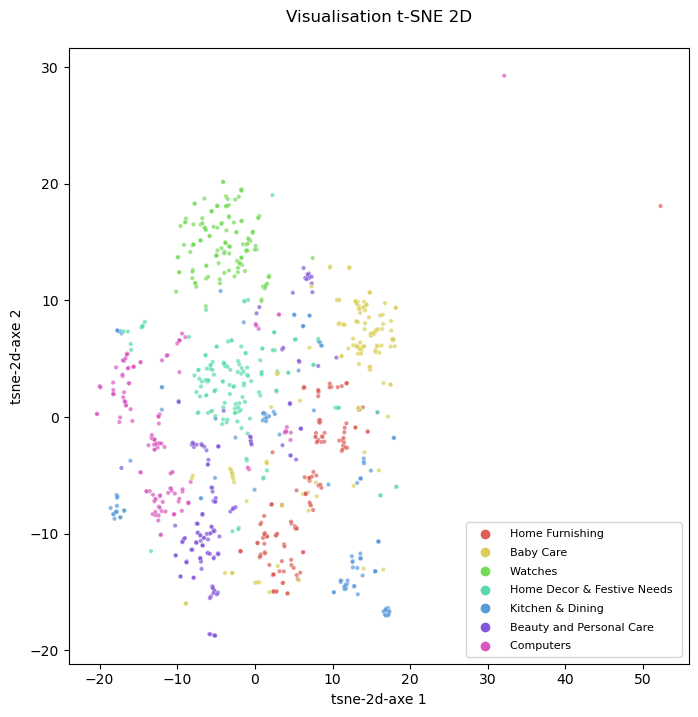

In [370]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc4,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'article) sur le T-SNE montre des groupes peu distincts, mais avec des chevauchements entre les groupes de catégories d'article ("Kitchen & Dining", "Beauty and Personal Care", "Baby Care" principalement). 

### 9.5.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [371]:
# Préparation des données
df_tsne_text_2d_enc4["label_kmeans"] = model_kmeans_enc4.labels_
df_tsne_text_2d_enc4

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,8.622527,-1.662351,1
1,Baby Care,6.885550,-5.295313,1
2,Baby Care,7.860322,-5.616447,1
3,Home Furnishing,13.400901,0.629665,1
4,Home Furnishing,13.441943,0.625720,1
...,...,...,...,...
1044,Baby Care,2.873500,3.820001,1
1045,Baby Care,2.846473,3.662867,1
1046,Baby Care,-2.677017,-5.608251,5
1047,Baby Care,-2.932650,-4.797688,5


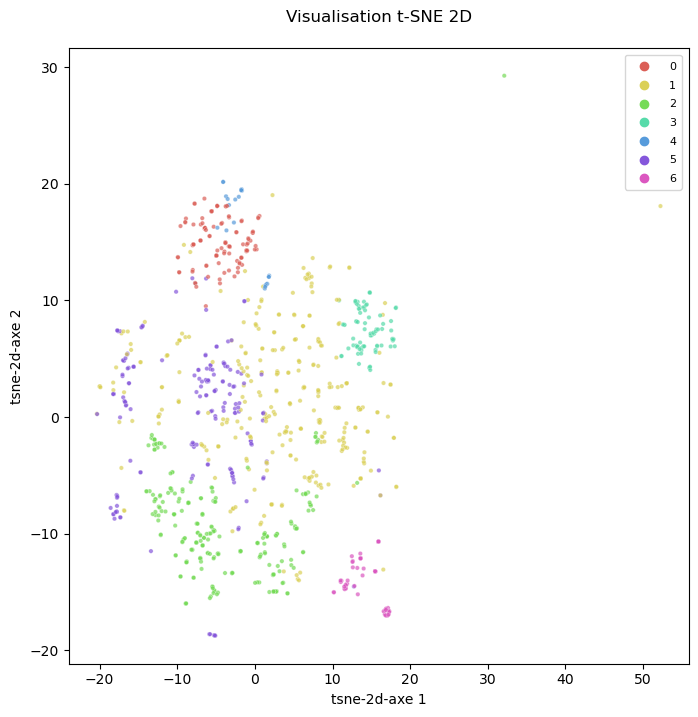

In [372]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc4,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 1 et 5 relativement importants, les autres de plus petite taille) avec des chevauchements entre les clusters (clusters 1 et 5).

Toutefois, les tailles de clusters sont plus homogènes que sur les encodages BOW et il semblerait qu'il y ait moins de chevauchements entre clusters.

   ### 9.5.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,23 est médiocre**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements, mais le score ARI est meilleur que pour l'encodage BOW.

### 9.5.6 Qualité du clustering - Coefficient de silhouette

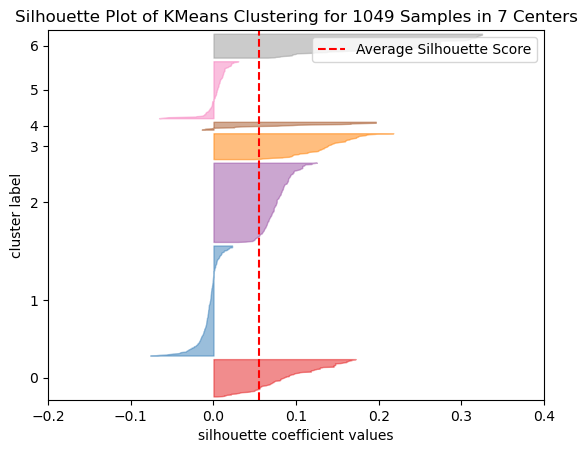

In [373]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_4, model_kmeans_enc4)

Le graphique ci-dessus montre:
- des clusters (1 et 5) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que les données de ces clusters sont incorrectes.
- des clusters disproportionnés en taille (exemple: clusters 1 et 2 par rapport aux autres clusters), mais avec des disproportions moindres que pour l'encodage BOW.
- un score de silhouette moyenne très mauvais (0,05), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.5.7 Qualité du clustering - Affichage matrice de confusion

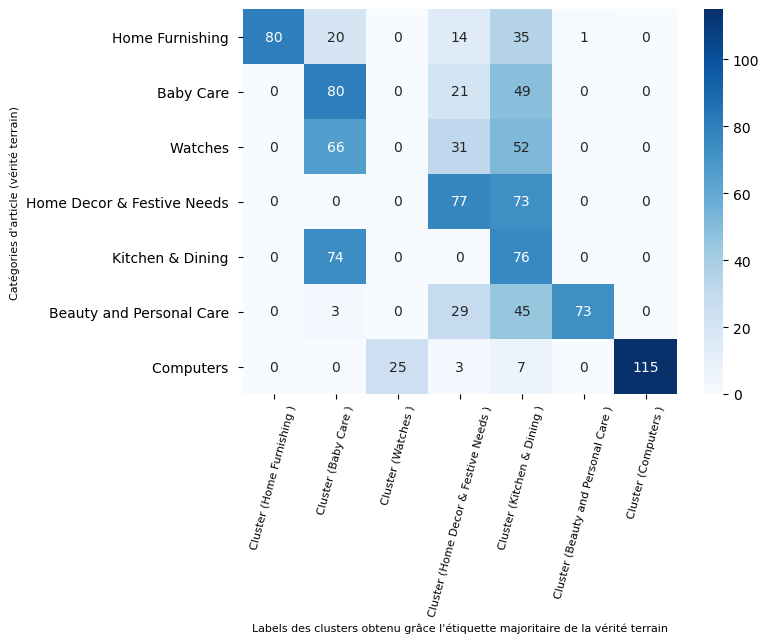

In [1135]:
# Réorganisation forcée de la matrice de confusion
argmax = np.array([6, 4, 1, 0, 2, 3, 5])

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc4.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans pratiquement tous les clusters, seul le dernier cluster semble contenir les articles de la catégorie "Computers".

## 9.6 Encodage 5: encodage textes - TF-IDF avec lemmatisation

### 9.6.1 Réduction de dimensions PCA

In [236]:
# Réduction de dimension PCA
feat_pca_tfidf_lemma = calcul_pca(df_tfidf_lemma, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 4130)
Dimensions dataset après réduction PCA :  (1049, 618)


### 9.6.2 Clustering k-means sur sortie PCA

In [831]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_tfidf_lemma = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [376]:
hyp_encodage_enc5 = 5
encodage_txt_5 = feat_pca_tfidf_lemma
desc_encodage_txt_5 = "_PCAtxt_tfidf_lemma"

# Clustering k-means
model_kmeans_enc5, silhouette_enc5, ari_enc5, results_kmeans_enc5 = clustering_kmeans(feat_pca_tfidf_lemma, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.07
Score moyen Adjusted Rand index (ARI) : 0.23


In [833]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_tfidf_lemma = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_tfidf_lemma,
                                                                              hyp_encodage_enc5, desc_encodage_txt_5, "texte", 
                                                                              silhouette_enc5, ari_enc5, results_kmeans_enc5)

In [834]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN


In [835]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_tfidf_lemma

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_tfidf_lemma,texte,0,467
1,PCA_txt_tfidf_lemma,texte,1,80
2,PCA_txt_tfidf_lemma,texte,2,135
3,PCA_txt_tfidf_lemma,texte,3,21
4,PCA_txt_tfidf_lemma,texte,4,48
5,PCA_txt_tfidf_lemma,texte,5,244
6,PCA_txt_tfidf_lemma,texte,6,54


### 9.6.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [383]:
data_tsne_text_enc5 = classif_tsne(feat_pca_tfidf_lemma, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.001s...
[t-SNE] Computed neighbors for 1049 samples in 0.094s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.400715
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.124695
[t-SNE] KL divergence after 300 iterations: 1.037527


In [384]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc5 = pd.DataFrame()
df_tsne_text_2d_enc5["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc5['tsne-2d-axe 1'] = data_tsne_text_enc5[:,0]
df_tsne_text_2d_enc5['tsne-2d-axe 2'] = data_tsne_text_enc5[:,1]
df_tsne_text_2d_enc5

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,7.097441,-11.868879
1,Baby Care,-3.357097,-5.274901
2,Baby Care,-3.837130,-4.024705
3,Home Furnishing,6.090088,-4.014291
4,Home Furnishing,6.021569,-3.998038
...,...,...,...
1044,Baby Care,2.300326,3.891071
1045,Baby Care,2.207084,3.733815
1046,Baby Care,-6.474943,-0.384804
1047,Baby Care,-5.985489,0.195871


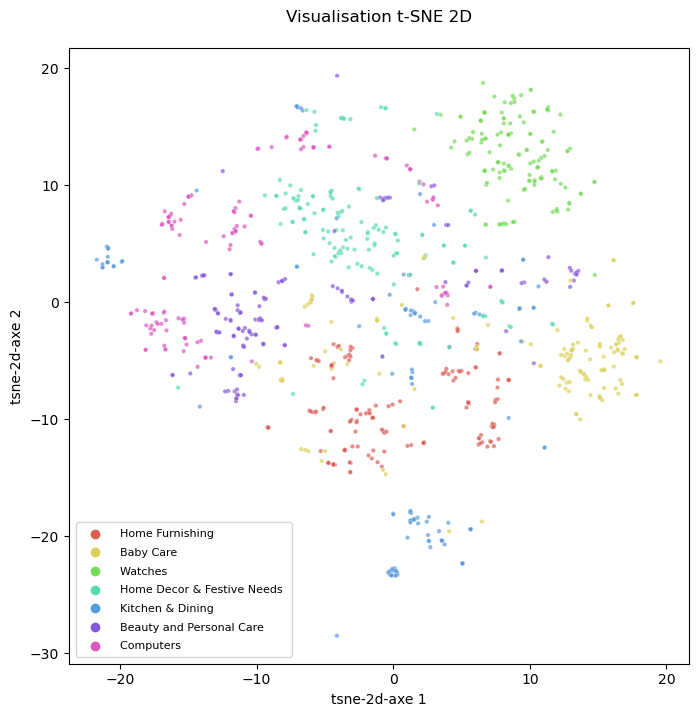

In [385]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc5,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes peu distincts, mais avec des chevauchements entre les groupes de catégories d'articles ("Beauty and Personal Care", "Home Decor & Festive Needs", "Baby Care" principalement). 

### 9.6.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [386]:
# Préparation des données
df_tsne_text_2d_enc5["label_kmeans"] = model_kmeans_enc5.labels_
df_tsne_text_2d_enc5

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,7.097441,-11.868879,0
1,Baby Care,-3.357097,-5.274901,0
2,Baby Care,-3.837130,-4.024705,0
3,Home Furnishing,6.090088,-4.014291,0
4,Home Furnishing,6.021569,-3.998038,0
...,...,...,...,...
1044,Baby Care,2.300326,3.891071,0
1045,Baby Care,2.207084,3.733815,0
1046,Baby Care,-6.474943,-0.384804,0
1047,Baby Care,-5.985489,0.195871,0


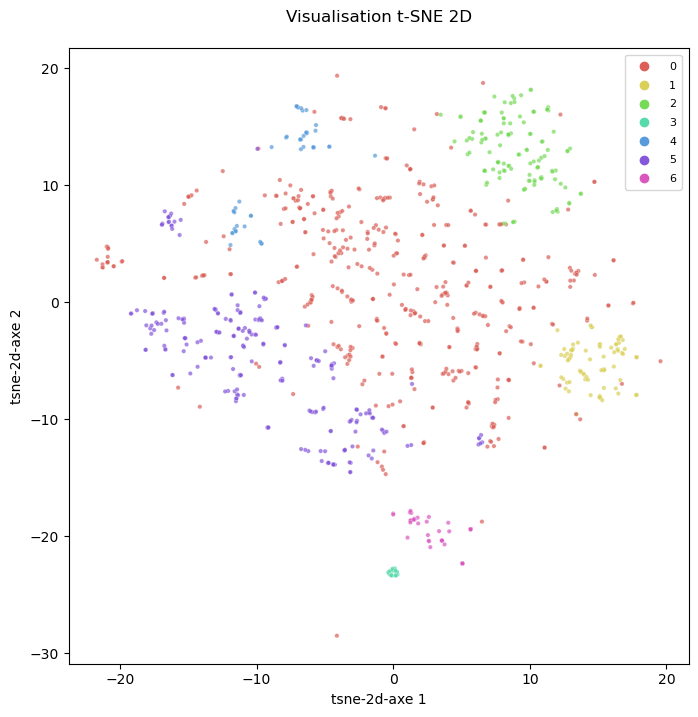

In [387]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc5,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 0 relativement important, les autres de plus petite taille) avec des erreurs possible sur le cluster 0.

   ### 9.6.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,23 est médiocre**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

### 9.6.6 Qualité du clustering - Coefficient de silhouette

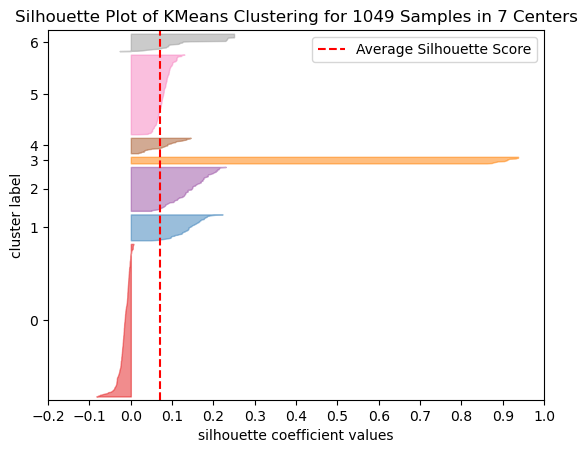

In [388]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_5, model_kmeans_enc5)

Le graphique ci-dessus montre:
- un cluster (0) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que les données de ce cluster sont incorrectes.
- des clusters disproportionnés en taille (exemple: clusters 0, 5 par rapport aux autres clusters)
- un score de silhouette moyenne très mauvais (0,06), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.6.7 Qualité du clustering - Affichage matrice de confusion

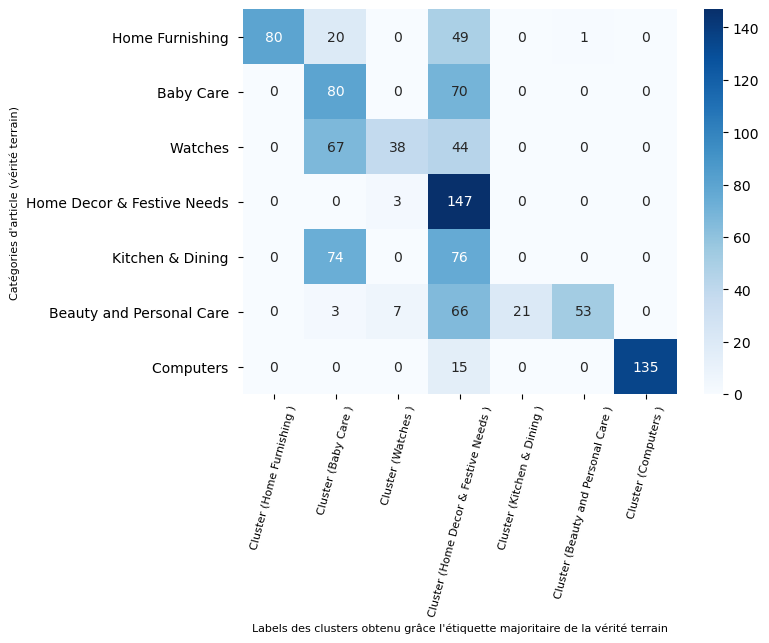

In [1139]:
# Réorganisation forcée de la matrice de confusion
argmax = np.array([3, 0, 6, 4, 2, 1, 5])

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc5.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 2ème et 4ème clusters.

Le 7ème cluster contient la majorité des articles de la catégorie "Computers".

## 9.7 Encodage 6: encodage textes - TF-IDF avec lemmatisation et mindf

### 9.7.1 Réduction de dimensions PCA

In [256]:
# Réduction de dimension PCA
feat_pca_tfidf_lemma_mindf = calcul_pca(df_tfidf_lemma_mindf, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 1015)
Dimensions dataset après réduction PCA :  (1049, 346)


### 9.7.2 Clustering k-means sur sortie PCA

In [836]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_tfidf_lemma_mindf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [391]:
hyp_encodage_enc6 = 6
encodage_txt_6 = feat_pca_tfidf_lemma_mindf
desc_encodage_txt_6 = "PCA_txt_tfidf_lemma_mindf"

# Clustering k-means
model_kmeans_enc6, silhouette_enc6, ari_enc6, results_kmeans_enc6 = clustering_kmeans(feat_pca_tfidf_lemma_mindf, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.1
Score moyen Adjusted Rand index (ARI) : 0.24


In [838]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_tfidf_lemma_mindf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_tfidf_lemma_mindf,
                                                                              hyp_encodage_enc6, desc_encodage_txt_6, "texte", 
                                                                              silhouette_enc6, ari_enc6, results_kmeans_enc6)

In [839]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN


In [840]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_tfidf_lemma_mindf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_tfidf_lemma_mindf,texte,0,82
1,PCA_txt_tfidf_lemma_mindf,texte,1,137
2,PCA_txt_tfidf_lemma_mindf,texte,2,408
3,PCA_txt_tfidf_lemma_mindf,texte,3,89
4,PCA_txt_tfidf_lemma_mindf,texte,4,30
5,PCA_txt_tfidf_lemma_mindf,texte,5,228
6,PCA_txt_tfidf_lemma_mindf,texte,6,75


### 9.7.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [395]:
data_tsne_text_enc6 = classif_tsne(feat_pca_tfidf_lemma_mindf, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.011s...
[t-SNE] Computed neighbors for 1049 samples in 0.067s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.461798
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.605705
[t-SNE] KL divergence after 300 iterations: 0.810560


In [396]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc6 = pd.DataFrame()
df_tsne_text_2d_enc6["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc6['tsne-2d-axe 1'] = data_tsne_text_enc6[:,0]
df_tsne_text_2d_enc6['tsne-2d-axe 2'] = data_tsne_text_enc6[:,1]
df_tsne_text_2d_enc6

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,-4.183329,8.800761
1,Baby Care,-5.315248,19.403156
2,Baby Care,-5.157034,17.965326
3,Home Furnishing,-0.075302,14.541869
4,Home Furnishing,-0.084745,14.535086
...,...,...,...
1044,Baby Care,7.949643,-2.629134
1045,Baby Care,7.923345,-2.703170
1046,Baby Care,-3.835103,-12.987517
1047,Baby Care,-3.061761,-12.986629


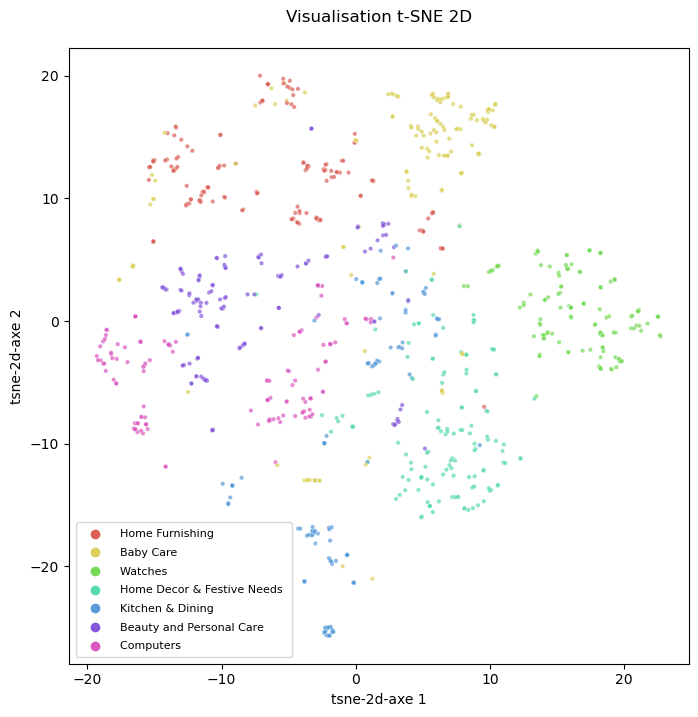

In [397]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc6,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'article) sur le T-SNE montre des groupes peu distincts, mais avec des chevauchements entre les groupes de catégories d'articles ("Beauty and Personal Care", Kitchen & Dining", "Home Decor & Festive Needs" principalement).

### 9.7.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [398]:
# Préparation des données
df_tsne_text_2d_enc6["label_kmeans"] = model_kmeans_enc6.labels_
df_tsne_text_2d_enc6

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,-4.183329,8.800761,2
1,Baby Care,-5.315248,19.403156,4
2,Baby Care,-5.157034,17.965326,4
3,Home Furnishing,-0.075302,14.541869,2
4,Home Furnishing,-0.084745,14.535086,2
...,...,...,...,...
1044,Baby Care,7.949643,-2.629134,2
1045,Baby Care,7.923345,-2.703170,2
1046,Baby Care,-3.835103,-12.987517,2
1047,Baby Care,-3.061761,-12.986629,2


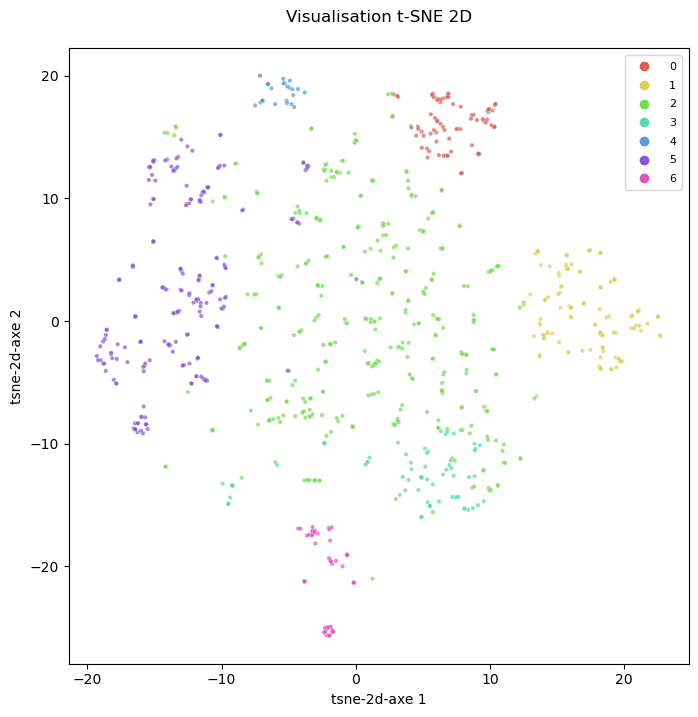

In [399]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc6,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 2 et 5 relativement importants, les autres de plus petite taille) avec des chevauchements entre les clusters, notamment pour le cluster 2.

   ### 9.7.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,24 est médiocre**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

Il y a toutefois quelques similitudes entre les catégories d'articles et les labels de clusters.

### 9.7.6 Qualité du clustering - Coefficient de silhouette

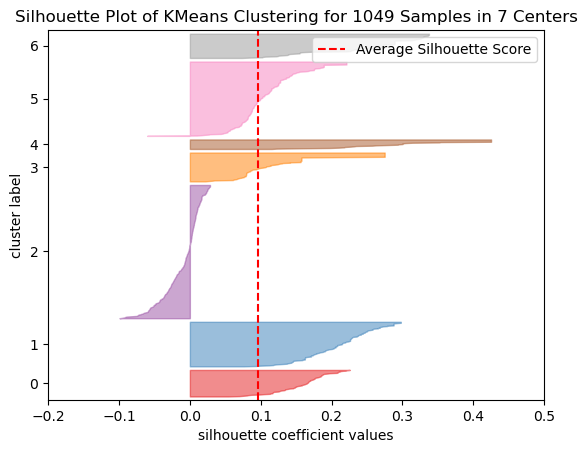

In [400]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_6, model_kmeans_enc6)

Le graphique ci-dessus montre:
- un cluster (2) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que ce cluster contient des données erronées. 
- des clusters disproportionnés en taille (exemple: clusters 2, 5 par rapport aux autres clusters)
- un score de silhouette moyenne médiocre (0,1), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.7.7 Qualité du clustering - Affichage matrice de confusion

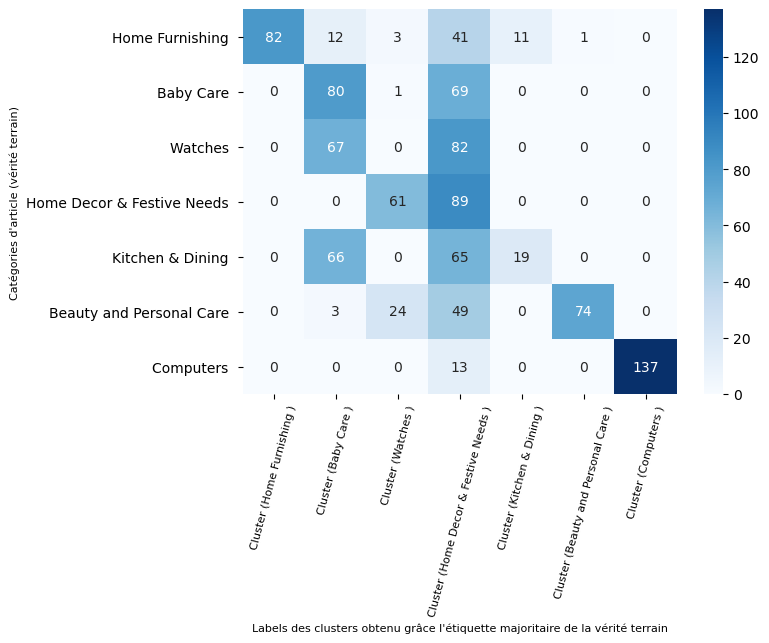

In [1140]:
# Réorganisation forcée de la matrice de confusion
argmax = np.array([0, 6, 3, 2, 4, 1, 5])

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc6.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 2ème et 4ème clusters (très volumineux en nombre d'articles) et que les autres clusters contiennent moins d'articles.

Toutefois, on voit que 7ème cluster correspond vraisemblablement à la catégorie "Computers", que le 1er cluster correspond vraisemblablement à la catégorie "Home Furnishing".

## 9.8 Encodage 7: encodage textes - TF-IDF - Lemmatisation / mindf / ngram

### 9.8.1 Réduction de dimensions PCA

In [274]:
# Réduction de dimension PCA
feat_pca_tfidf_lemma_mindf_ngram = calcul_pca(df_tfidf_lemma_mindf_ngram, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 2346)
Dimensions dataset après réduction PCA :  (1049, 406)


### 9.8.2 Clustering k-means sur sortie PCA

In [841]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_tfidf_lemma_mindf_ngram = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [403]:
hyp_encodage_enc7 = 7
encodage_txt_7 = feat_pca_tfidf_lemma_mindf_ngram
desc_encodage_txt_7 = "PCA_txt_tfidf_lemma_mindf_ngram"

# Clustering k-means
model_kmeans_enc7, silhouette_enc7, ari_enc7, results_kmeans_enc7 = clustering_kmeans(feat_pca_tfidf_lemma_mindf_ngram, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.09
Score moyen Adjusted Rand index (ARI) : 0.25


In [843]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_tfidf_lemma_mindf_ngram = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_tfidf_lemma_mindf_ngram,
                                                                              hyp_encodage_enc7, desc_encodage_txt_7, "texte", 
                                                                              silhouette_enc7, ari_enc7, results_kmeans_enc7)

In [844]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN


In [845]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_tfidf_lemma_mindf_ngram

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_tfidf_lemma_mindf_ngram,texte,0,149
1,PCA_txt_tfidf_lemma_mindf_ngram,texte,1,165
2,PCA_txt_tfidf_lemma_mindf_ngram,texte,2,136
3,PCA_txt_tfidf_lemma_mindf_ngram,texte,3,36
4,PCA_txt_tfidf_lemma_mindf_ngram,texte,4,56
5,PCA_txt_tfidf_lemma_mindf_ngram,texte,5,95
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,6,412


### 9.8.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [407]:
data_tsne_text_enc7 = classif_tsne(feat_pca_tfidf_lemma_mindf_ngram, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.001s...
[t-SNE] Computed neighbors for 1049 samples in 0.080s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.469343
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.189415
[t-SNE] KL divergence after 300 iterations: 0.778940


In [408]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc7 = pd.DataFrame()
df_tsne_text_2d_enc7["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc7['tsne-2d-axe 1'] = data_tsne_text_enc7[:,0]
df_tsne_text_2d_enc7['tsne-2d-axe 2'] = data_tsne_text_enc7[:,1]
df_tsne_text_2d_enc7

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,1.724517,9.515359
1,Baby Care,2.580235,14.239199
2,Baby Care,1.596633,15.356642
3,Home Furnishing,-2.034930,11.806225
4,Home Furnishing,-1.987900,11.771395
...,...,...,...
1044,Baby Care,-3.124019,-4.447172
1045,Baby Care,-3.009044,-4.570970
1046,Baby Care,10.649489,-14.144181
1047,Baby Care,10.398863,-13.788897


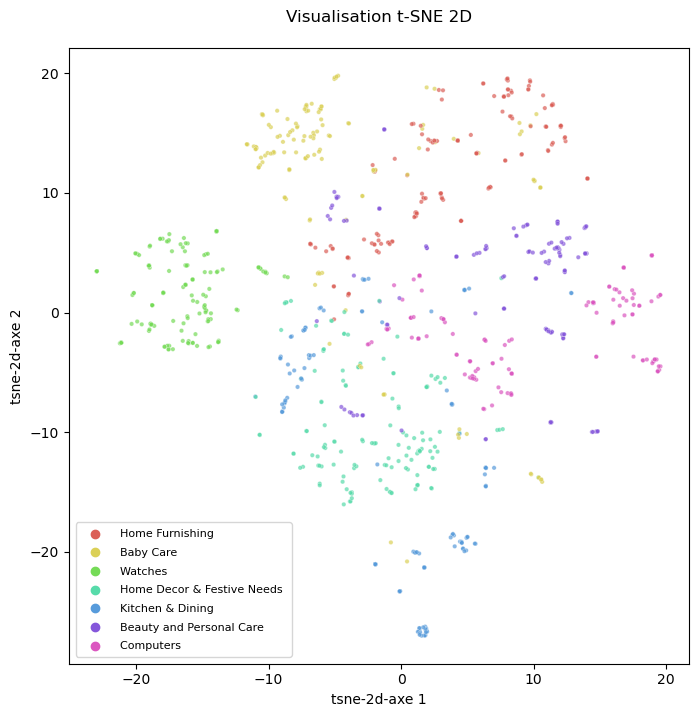

In [409]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc7,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes peu distincts, mais avec des chevauchements entre les groupes de catégories d'articles. 

### 9.8.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [410]:
# Préparation des données
df_tsne_text_2d_enc7["label_kmeans"] = model_kmeans_enc7.labels_
df_tsne_text_2d_enc7

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,1.724517,9.515359,6
1,Baby Care,2.580235,14.239199,6
2,Baby Care,1.596633,15.356642,6
3,Home Furnishing,-2.034930,11.806225,6
4,Home Furnishing,-1.987900,11.771395,6
...,...,...,...,...
1044,Baby Care,-3.124019,-4.447172,6
1045,Baby Care,-3.009044,-4.570970,6
1046,Baby Care,10.649489,-14.144181,1
1047,Baby Care,10.398863,-13.788897,1


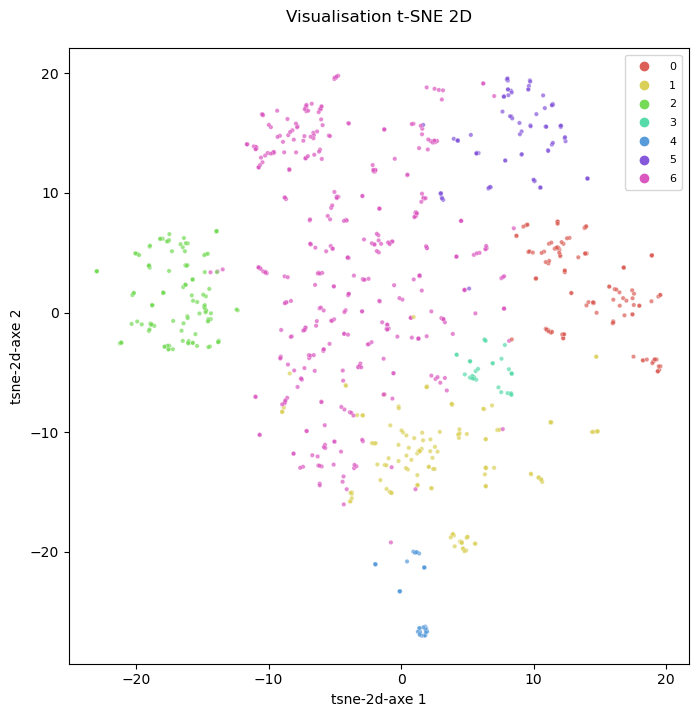

In [411]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc7,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 6 relativement important, les autres de plus petite taille) avec des groupes distincts, mais avec un cluster 6 non dense et qui se chevauche avec les autres clusters.

   ### 9.8.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,25 est médiocre**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

### 9.8.6 Qualité du clustering - Coefficient de silhouette

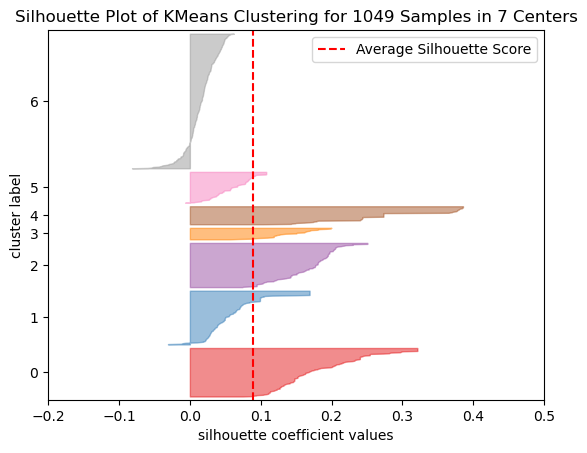

In [412]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_7, model_kmeans_enc7)

Le graphique ci-dessus montre:
- un cluster (6) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters,  il y a des données en erreur dans ce cluster.
- un cluster disproportionné en taille (exemple: cluster 6 par rapport aux autres clusters)
- un score de silhouette moyenne médiocre (0,09), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.8.7 Qualité du clustering - Affichage matrice de confusion

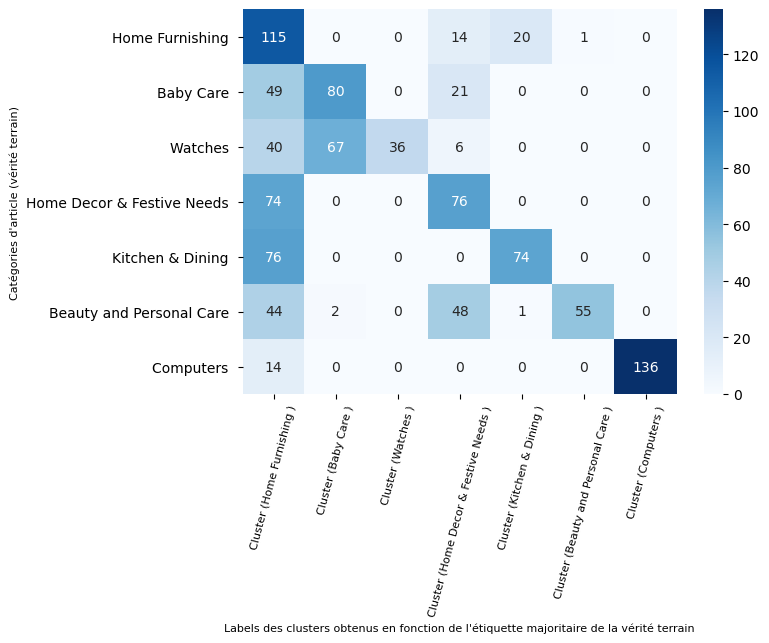

In [1193]:
# Réorganisation forcée de la matrice de confusion
argmax = None

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc7.labels_, None, argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 1er et 4ème clusters (le 1er cluster est très volumineux en nombre d'articles) et que les autres clusters contiennent moins d'articles.

Le 7ème cluster semble correspondre à la catégorie "Computers" et le 1er cluster semble correspondre  à la catégorie "Home Furnishing".

## 9.9 Encodage 8: encodage textes -  Word / Sentence Embedding - Doc2Vec

### 9.9.1 Réduction de dimensions PCA

In [414]:
# Réduction de dimension PCA
feat_pca_docvec2 = calcul_pca(df_doc2vec, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 1000)
Dimensions dataset après réduction PCA :  (1049, 27)


### 9.9.2 Clustering k-means sur sortie PCA

In [846]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_docvec2 = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [422]:
hyp_encodage_enc8 = 8
encodage_txt_8 = feat_pca_docvec2
desc_encodage_txt_8 = "PCA_txt_docvec2"

# Clustering k-means
model_kmeans_enc8, silhouette_enc8, ari_enc8, results_kmeans_enc8 = clustering_kmeans(feat_pca_docvec2, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.26
Score moyen Adjusted Rand index (ARI) : 0.04


In [848]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_docvec2 = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_docvec2,
                                                                              hyp_encodage_enc8, desc_encodage_txt_8, "texte", 
                                                                              silhouette_enc8, ari_enc8, results_kmeans_enc8)

In [849]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN


In [850]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_docvec2

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_docvec2,texte,0,663
1,PCA_txt_docvec2,texte,1,36
2,PCA_txt_docvec2,texte,2,23
3,PCA_txt_docvec2,texte,3,46
4,PCA_txt_docvec2,texte,4,13
5,PCA_txt_docvec2,texte,5,229
6,PCA_txt_docvec2,texte,6,39


### 9.9.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [426]:
data_tsne_text_enc8 = classif_tsne(feat_pca_docvec2, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.000s...
[t-SNE] Computed neighbors for 1049 samples in 0.063s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.426693
[t-SNE] KL divergence after 250 iterations with early exaggeration: 68.733467
[t-SNE] KL divergence after 300 iterations: 1.441328


In [427]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc8 = pd.DataFrame()
df_tsne_text_2d_enc8["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc8['tsne-2d-axe 1'] = data_tsne_text_enc8[:,0]
df_tsne_text_2d_enc8['tsne-2d-axe 2'] = data_tsne_text_enc8[:,1]
df_tsne_text_2d_enc8

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,12.886962,0.916917
1,Baby Care,-5.079002,12.221253
2,Baby Care,-4.944956,12.586314
3,Home Furnishing,3.176270,13.723081
4,Home Furnishing,3.603858,14.260411
...,...,...,...
1044,Baby Care,10.426088,12.844077
1045,Baby Care,10.573441,12.792796
1046,Baby Care,-7.001854,6.648865
1047,Baby Care,-1.153831,1.157390


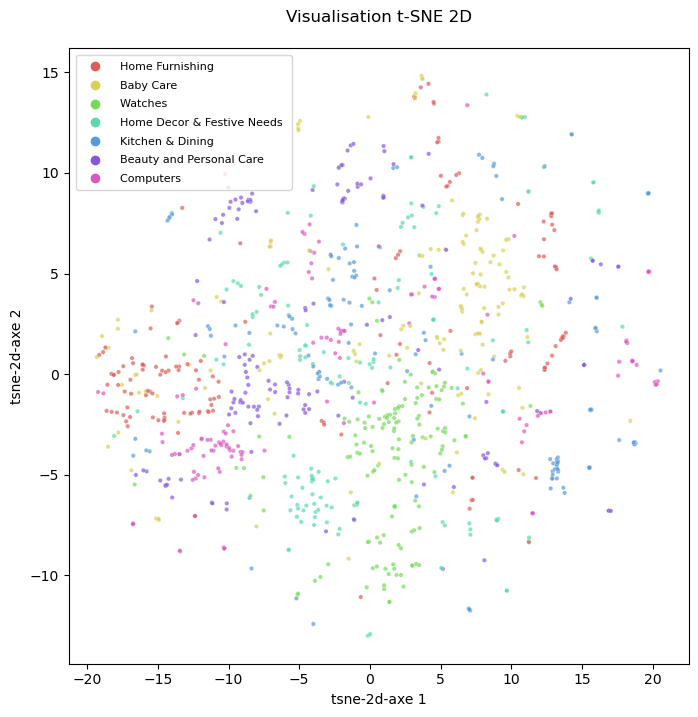

In [428]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc8,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'article) sur le T-SNE ne montre pas des groupes distincts, il y des chevauchements entre tous les groupes de catégories d'articles.

### 9.9.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [429]:
# Préparation des données
df_tsne_text_2d_enc8["label_kmeans"] = model_kmeans_enc8.labels_
df_tsne_text_2d_enc8

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,12.886962,0.916917,6
1,Baby Care,-5.079002,12.221253,0
2,Baby Care,-4.944956,12.586314,6
3,Home Furnishing,3.176270,13.723081,6
4,Home Furnishing,3.603858,14.260411,6
...,...,...,...,...
1044,Baby Care,10.426088,12.844077,1
1045,Baby Care,10.573441,12.792796,6
1046,Baby Care,-7.001854,6.648865,0
1047,Baby Care,-1.153831,1.157390,0


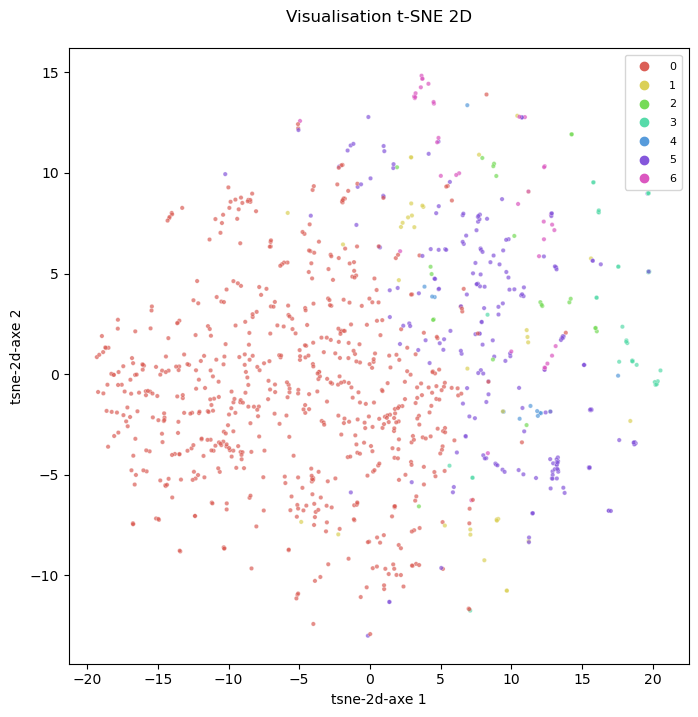

In [430]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc8,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 0 et 5 relativement importants, les autres de plus petite taille), avec des clusters non denses.

   ### 9.9.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,04 est mauvais**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

Il n'y pratiquement pas de similitude entre les catégories d'article et le labels des clusters.

### 9.9.6 Qualité du clustering - Coefficient de silhouette

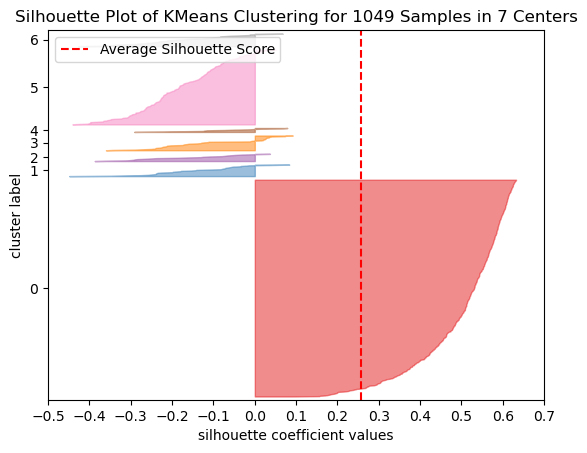

In [431]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_8, model_kmeans_enc8)

Le graphique ci-dessus montre:
- tous les clusters en erreur (sauf le cluster 0) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que la plupart des clusters contient des des données en erreur.
- un cluster disproportionné en taille (exemple: cluster 0 par rapport aux autres clusters)
- un score de silhouette moyen (0,26), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.9.7 Qualité du clustering - Affichage matrice de confusion

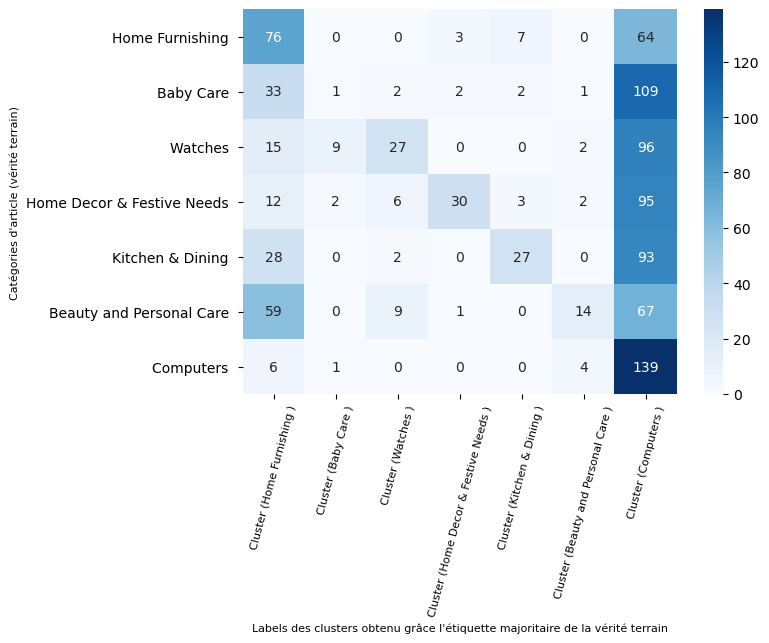

In [1148]:
# Réorganisation forcée de la matrice de confusion
argmax = [6,3,5,2,1,0,4]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc8.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans le 7ème cluster (très volumineux en nombre d'articles) et que les autres clusters contiennent moins d'articles.

Impossibilité de savoir si un cluster contient majoritairement un catégorie d'articles.

## 9.10 Encodage 9: encodage images - Bag of Visual Words avec SIFT

### 9.10.1 Réduction de dimensions PCA

In [433]:
# Réduction de dimension PCA
feat_pca_bovw_sift= calcul_pca(df_bovw_sift, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 712)
Dimensions dataset après réduction PCA :  (1049, 148)


### 9.10.2 Clustering k-means sur sortie PCA

In [851]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_bovw_sift = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [464]:
hyp_encodage_enc9 = 9
encodage_image_9 = feat_pca_bovw_sift
desc_encodage_txt_9 = "PCA_img_bovw_sift"

# Clustering k-means
model_kmeans_enc9, silhouette_enc9, ari_enc9, results_kmeans_enc9 = clustering_kmeans(feat_pca_bovw_sift, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.07
Score moyen Adjusted Rand index (ARI) : 0.02


In [853]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_bovw_sift = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_bovw_sift,
                                                                              hyp_encodage_enc9, desc_encodage_txt_9, "image", 
                                                                              silhouette_enc9, ari_enc9, results_kmeans_enc9)

In [854]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,NaN,NaN,NaN,NaN


In [855]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_bovw_sift

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_img_bovw_sift,image,0,39
1,PCA_img_bovw_sift,image,1,11
2,PCA_img_bovw_sift,image,2,360
3,PCA_img_bovw_sift,image,3,4
4,PCA_img_bovw_sift,image,4,2
5,PCA_img_bovw_sift,image,5,610
6,PCA_img_bovw_sift,image,6,23


### 9.10.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images.

In [469]:
data_tsne_img_enc9 = classif_tsne(feat_pca_bovw_sift, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.002s...
[t-SNE] Computed neighbors for 1049 samples in 0.061s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 11.365048
[t-SNE] KL divergence after 250 iterations with early exaggeration: 74.167473
[t-SNE] KL divergence after 300 iterations: 1.323865


In [471]:
# Préparation des données pour affichage des points 
df_tsne_img_2d_enc9 = pd.DataFrame()
df_tsne_img_2d_enc9["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_img_2d_enc9['tsne-2d-axe 1'] = data_tsne_img_enc9[:,0]
df_tsne_img_2d_enc9['tsne-2d-axe 2'] = data_tsne_img_enc9[:,1]
df_tsne_img_2d_enc9

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,-5.541757,-7.888005
1,Baby Care,-6.276165,-7.304078
2,Baby Care,-9.594781,8.986707
3,Home Furnishing,-7.902016,-8.235977
4,Home Furnishing,-6.832154,-10.915381
...,...,...,...
1044,Baby Care,1.102248,-7.584314
1045,Baby Care,-7.486520,13.365512
1046,Baby Care,5.341323,-13.895671
1047,Baby Care,-8.001342,9.151999


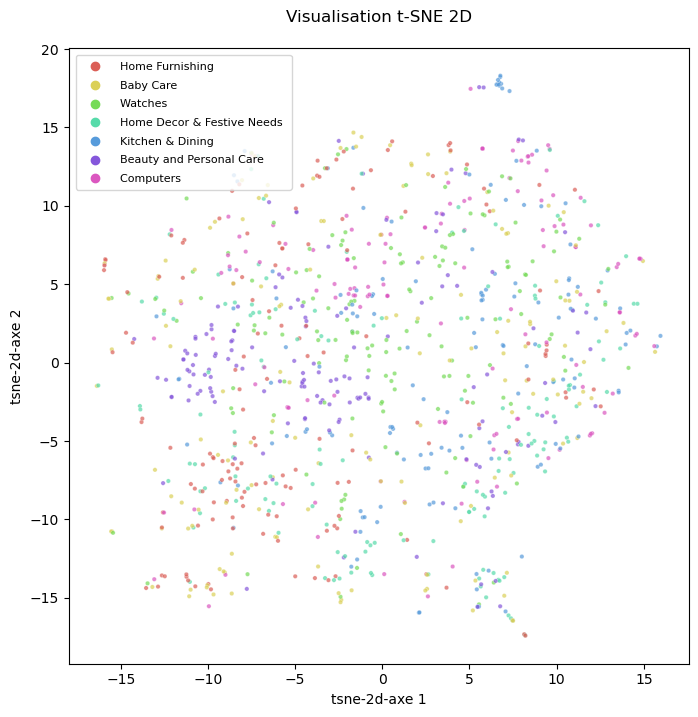

In [472]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc9,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'article) sur le T-SNE ne montre pas des groupes distincts, il y des chevauchements entre tous les groupes de catégories d'articles. 

### 9.10.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [473]:
# Préparation des données
df_tsne_img_2d_enc9["label_kmeans"] = model_kmeans_enc9.labels_
df_tsne_img_2d_enc9

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,-5.541757,-7.888005,5
1,Baby Care,-6.276165,-7.304078,5
2,Baby Care,-9.594781,8.986707,5
3,Home Furnishing,-7.902016,-8.235977,5
4,Home Furnishing,-6.832154,-10.915381,5
...,...,...,...,...
1044,Baby Care,1.102248,-7.584314,5
1045,Baby Care,-7.486520,13.365512,5
1046,Baby Care,5.341323,-13.895671,5
1047,Baby Care,-8.001342,9.151999,5


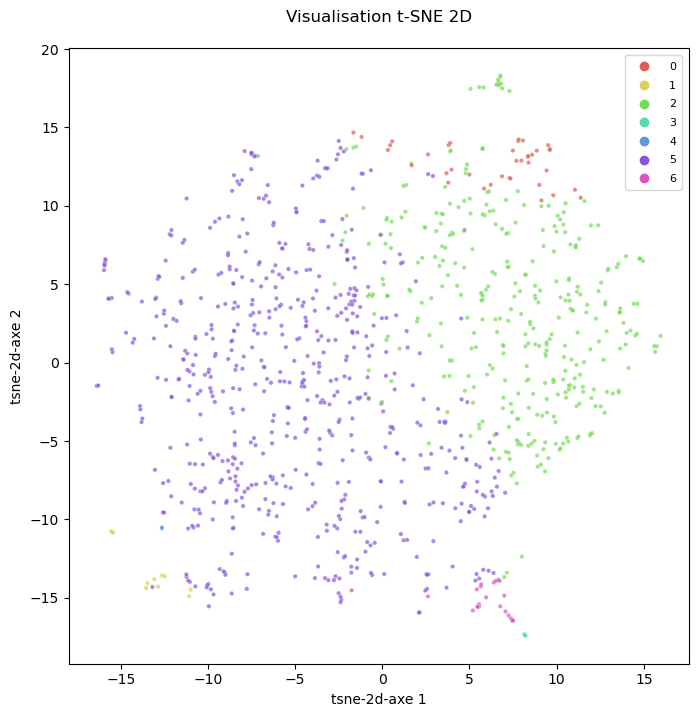

In [474]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc9,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 2 et 5 relativement importants, les autres de plus petite taille) avec des clusters peu denses (clusters 2 et 5) et qui se chevauchent.

   ### 9.10.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,02 est mauvais**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

Il n'y a pratiquement pas de similitude entre les catégories d'articles et les labels des clusters.

### 9.10.6 Qualité du clustering - Coefficient de silhouette

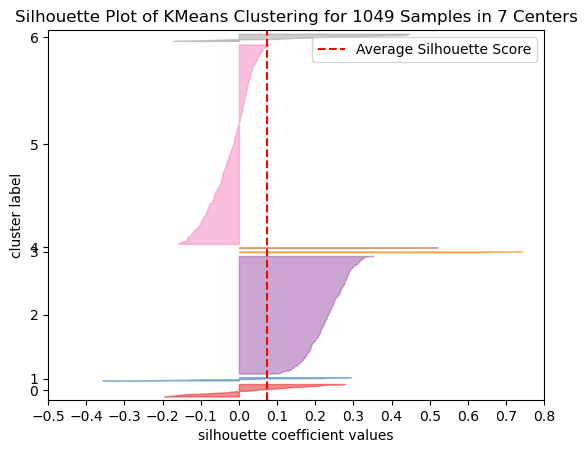

In [475]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_image_9, model_kmeans_enc9)

Le graphique ci-dessus montre:
- des clusters en erreur (notamment les clusters 0, 1 et 5) présentant principalement des erreurs, le cluster 5 avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, 
- un cluster disproportionné en taille (exemple: clusters 2 et 5 par rapport aux autres clusters)
- un score de silhouette mauvais (0,07), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.10.7 Qualité du clustering - Affichage matrice de confusion

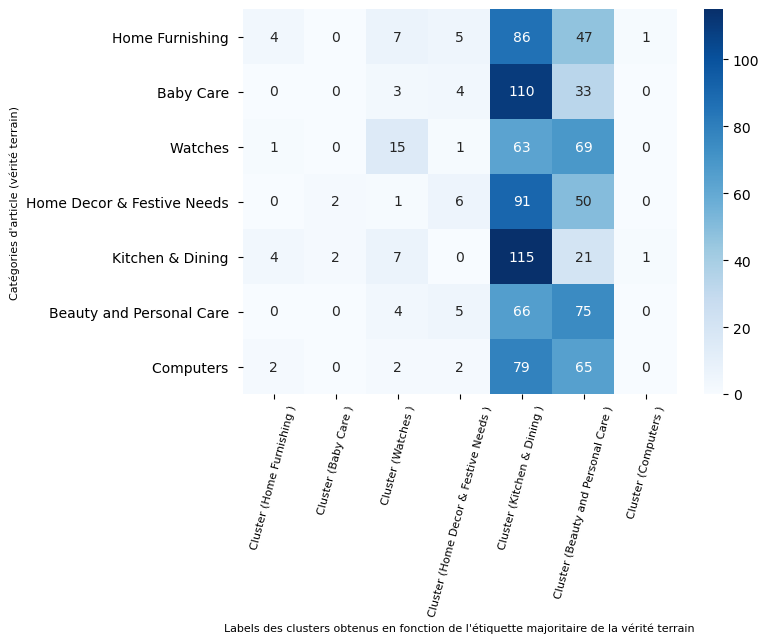

In [1194]:
# Réorganisation forcée de la matrice de confusion
argmax = [2,0,5,1,6,4,3]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc9.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 5ème et 6ème clusters (très volumineux en nombre d'articles) et que les autres clusters contiennent très peu d'articles.

Il est impossible de déterminer la catégorie d'article gérée par chaque cluster.

## 9.11 Encodage 10: encodage images - Réseau neurones VGG16

### 9.11.1 Réduction de dimensions PCA

In [542]:
# Réduction de dimension PCA
feat_pca_img_vgg16= calcul_pca(df_vgg16, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 25088)
Dimensions dataset après réduction PCA :  (1049, 736)


### 9.11.2 Clustering k-means sur sortie PCA

In [856]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_img_vgg16 = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [549]:
hyp_encodage_enc10 = 10
encodage_image_10 = feat_pca_img_vgg16
desc_encodage_txt_10 = "PCA_img_vgg16"

# Clustering k-means
model_kmeans_enc10, silhouette_enc10, ari_enc10, results_kmeans_enc10 = clustering_kmeans(feat_pca_img_vgg16, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.13
Score moyen Adjusted Rand index (ARI) : 0.09


In [858]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_img_vgg16 = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_img_vgg16,
                                                                              hyp_encodage_enc10, desc_encodage_txt_10, "image", 
                                                                              silhouette_enc10, ari_enc10, results_kmeans_enc10)

In [859]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [860]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_img_vgg16

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_img_vgg16,image,0,19
1,PCA_img_vgg16,image,1,785
2,PCA_img_vgg16,image,2,51
3,PCA_img_vgg16,image,3,73
4,PCA_img_vgg16,image,4,32
5,PCA_img_vgg16,image,5,44
6,PCA_img_vgg16,image,6,45


### 9.11.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images.

In [559]:
data_tsne_img_enc10 = classif_tsne(feat_pca_img_vgg16, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.001s...
[t-SNE] Computed neighbors for 1049 samples in 0.113s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 409.467528
[t-SNE] KL divergence after 250 iterations with early exaggeration: 108.718170
[t-SNE] KL divergence after 300 iterations: 2.731081


In [560]:
# Préparation des données pour affichage des points 
df_tsne_img_2d_enc10 = pd.DataFrame()
df_tsne_img_2d_enc10["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_img_2d_enc10['tsne-2d-axe 1'] = data_tsne_img_enc10[:,0]
df_tsne_img_2d_enc10['tsne-2d-axe 2'] = data_tsne_img_enc10[:,1]
df_tsne_img_2d_enc10

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,14.148789,5.360056
1,Baby Care,-1.245833,-10.816358
2,Baby Care,4.777494,-11.506790
3,Home Furnishing,5.092673,-19.089010
4,Home Furnishing,6.637350,-12.050197
...,...,...,...
1044,Baby Care,15.434245,-11.412024
1045,Baby Care,10.689115,3.603736
1046,Baby Care,14.029543,-20.994719
1047,Baby Care,11.366763,2.383208


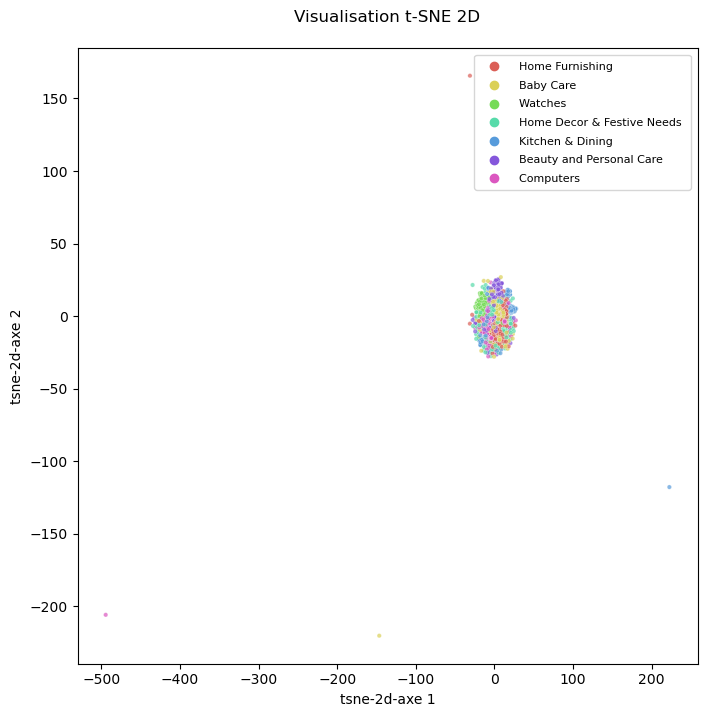

In [561]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc10,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes non distincts, et avec des chevauchements entre les groupes de catégories d'article. 

### 9.11.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [562]:
# Préparation des données
df_tsne_img_2d_enc10["label_kmeans"] = model_kmeans_enc10.labels_
df_tsne_img_2d_enc10

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,14.148789,5.360056,1
1,Baby Care,-1.245833,-10.816358,1
2,Baby Care,4.777494,-11.506790,1
3,Home Furnishing,5.092673,-19.089010,1
4,Home Furnishing,6.637350,-12.050197,1
...,...,...,...,...
1044,Baby Care,15.434245,-11.412024,1
1045,Baby Care,10.689115,3.603736,1
1046,Baby Care,14.029543,-20.994719,1
1047,Baby Care,11.366763,2.383208,1


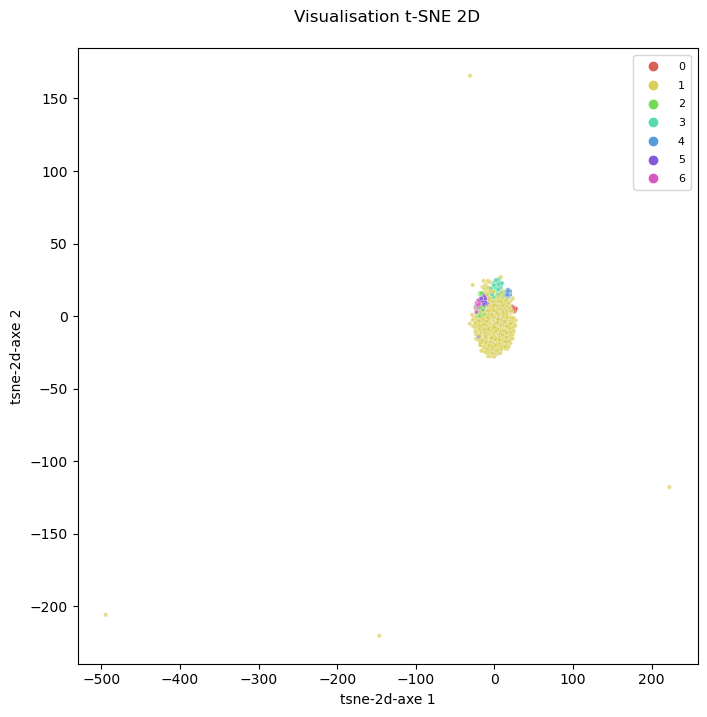

In [563]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc10,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 1 relativement important, les autres de plus petite taille) avec des chevauchements entre les clusters.

   ### 9.11.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,09 est mauvais**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

Il n'y pratiquement pas de similitude et les catégories d'articles et les labels de clusters.

### 9.11.6 Qualité du clustering - Coefficient de silhouette

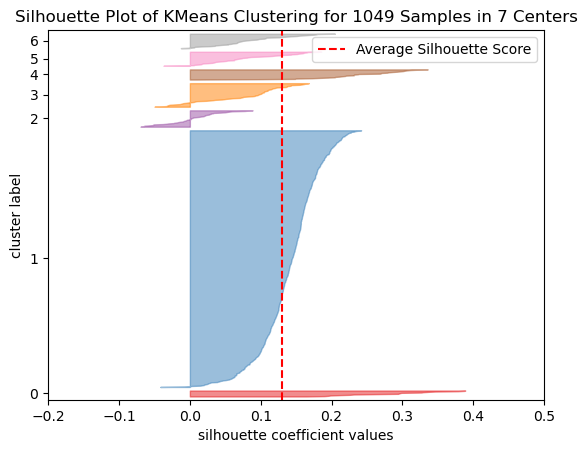

In [564]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_image_10, model_kmeans_enc10)

Le graphique ci-dessus montre:
- des clusters en erreur (notamment les clusters 2 à 6) présentant principalement des erreurs (présence de données incorrectes), 
- un cluster disproportionné en taille (exemple: cluster 1 (785 articles) par rapport aux autres clusters)
- un score de silhouette mauvais (0,13), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.11.7 Qualité du clustering - Affichage matrice de confusion

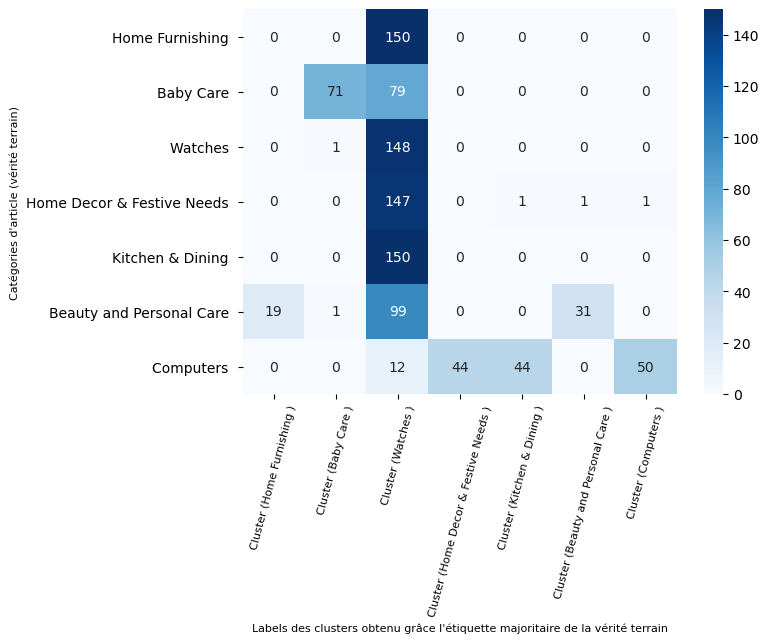

In [1155]:
# Réorganisation forcée de la matrice de confusion
argmax = [0,2,6,1,5,3,4]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc10.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans le 3ème cluster (très volumineux en nombre d'articles) et que les autres clusters contiennent très peu d'articles.

## 9.12 Encodage 11: encodage images - Réseau neurones ResNet50

### 9.12.1 Réduction de dimensions PCA

In [566]:
# Réduction de dimension PCA
feat_pca_img_resnet50= calcul_pca(df_resnet50, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 100352)
Dimensions dataset après réduction PCA :  (1049, 807)


### 9.12.2 Clustering k-means sur sortie PCA

In [861]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_img_resnet50 = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [576]:
hyp_encodage_enc11 = 11
encodage_image_11 = feat_pca_img_resnet50
desc_encodage_txt_11 = "PCA_img_resnet50"

# Clustering k-means
model_kmeans_enc11, silhouette_enc11, ari_enc11, results_kmeans_enc11 = clustering_kmeans(feat_pca_img_resnet50, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.02
Score moyen Adjusted Rand index (ARI) : 0.34


In [863]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_img_resnet50 = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_img_resnet50,
                                                                              hyp_encodage_enc11, desc_encodage_txt_11, "image", 
                                                                              silhouette_enc11, ari_enc11, results_kmeans_enc11)

In [864]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [865]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_img_resnet50

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_img_resnet50,image,0,124
1,PCA_img_resnet50,image,1,328
2,PCA_img_resnet50,image,2,141
3,PCA_img_resnet50,image,3,121
4,PCA_img_resnet50,image,4,129
5,PCA_img_resnet50,image,5,163
6,PCA_img_resnet50,image,6,43


### 9.12.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images.

In [580]:
data_tsne_img_enc11 = classif_tsne(feat_pca_img_resnet50, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.012s...
[t-SNE] Computed neighbors for 1049 samples in 0.129s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 128.261292
[t-SNE] KL divergence after 250 iterations with early exaggeration: 101.121010
[t-SNE] KL divergence after 300 iterations: 2.521485


In [581]:
# Préparation des données pour affichage des points 
df_tsne_img_2d_enc11 = pd.DataFrame()
df_tsne_img_2d_enc11["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_img_2d_enc11['tsne-2d-axe 1'] = data_tsne_img_enc11[:,0]
df_tsne_img_2d_enc11['tsne-2d-axe 2'] = data_tsne_img_enc11[:,1]
df_tsne_img_2d_enc11

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,6.872926,-5.047223
1,Baby Care,-8.244853,-6.149196
2,Baby Care,-17.504568,6.026925
3,Home Furnishing,-20.120613,-2.894018
4,Home Furnishing,-18.009106,-1.074368
...,...,...,...
1044,Baby Care,-16.767391,-4.710691
1045,Baby Care,-2.216318,12.396356
1046,Baby Care,-19.468903,-10.506598
1047,Baby Care,-2.215579,12.611771


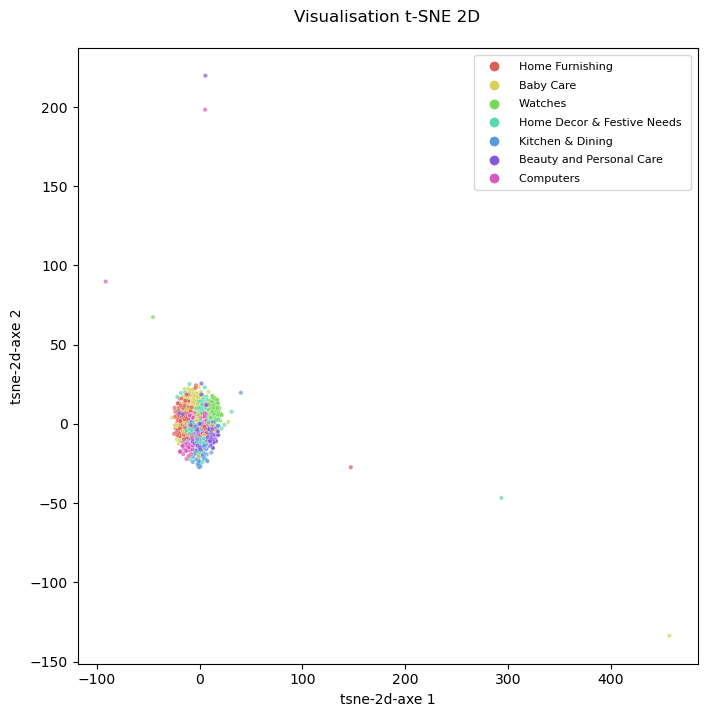

In [582]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc11,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes non distincts, et avec des chevauchements entre les groupes de catégories d'articles. 

### 9.12.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [583]:
# Préparation des données
df_tsne_img_2d_enc11["label_kmeans"] = model_kmeans_enc11.labels_
df_tsne_img_2d_enc11

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,6.872926,-5.047223,5
1,Baby Care,-8.244853,-6.149196,0
2,Baby Care,-17.504568,6.026925,0
3,Home Furnishing,-20.120613,-2.894018,0
4,Home Furnishing,-18.009106,-1.074368,0
...,...,...,...,...
1044,Baby Care,-16.767391,-4.710691,1
1045,Baby Care,-2.216318,12.396356,5
1046,Baby Care,-19.468903,-10.506598,1
1047,Baby Care,-2.215579,12.611771,5


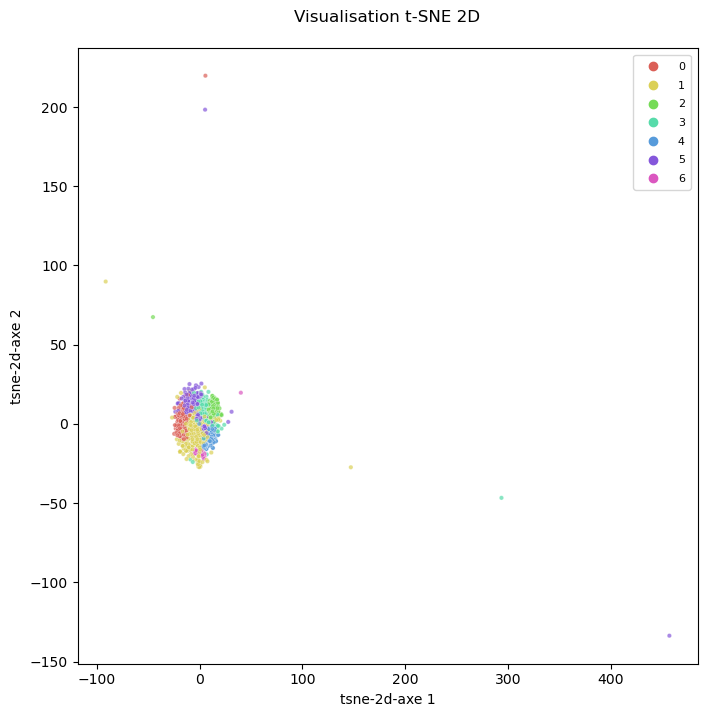

In [584]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc11,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 1 relativement important, les autres de plus petite taille) avec des chevauchements entre les clusters.

   ### 9.12.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,34 est moyen**, ce qui signifie qu'il y a des similitudes entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article), mais qu'il y aussi beaucoup de différences.

### 9.12.6 Qualité du clustering - Coefficient de silhouette

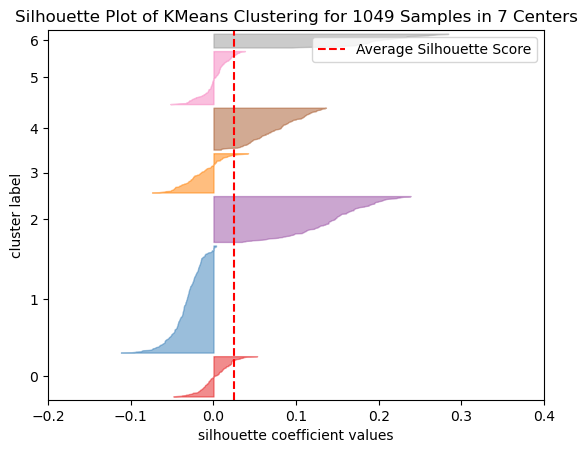

In [585]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_image_11, model_kmeans_enc11)

Le graphique ci-dessus montre:
- des clusters en erreur (notamment les clusters 0, 1, 3 et 5) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters pour le cluster 1, 
- un cluster disproportionné en taille (exemple: cluster 1 (328 articles) par rapport aux autres clusters)
- un score de silhouette très mauvais (0,02), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.12.7 Qualité du clustering - Affichage matrice de confusion

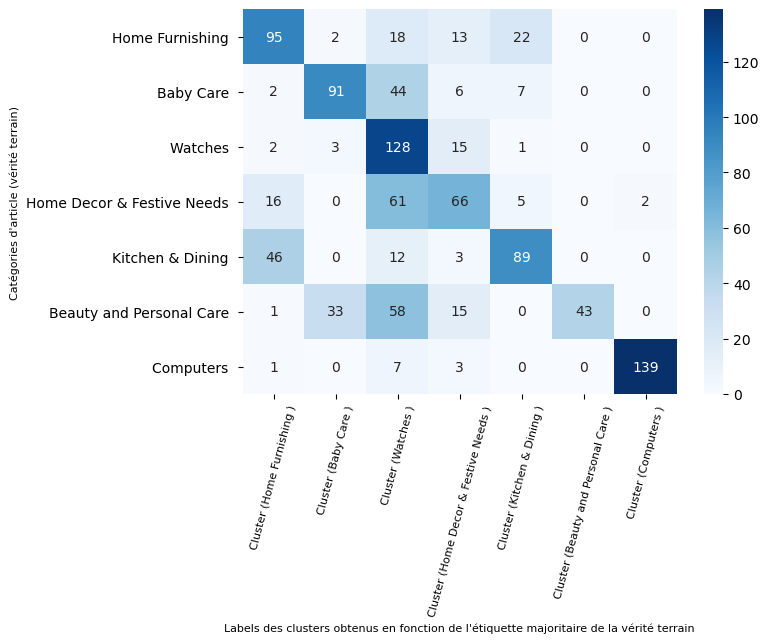

In [1195]:
# Réorganisation forcée de la matrice de confusion
argmax = None

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc11.labels_, None, argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans le 3ème cluster (très volumineux en nombre d'articles), mais que certaines catégories d'article semblent correspondre à un cluster particulier:
- 1er cluster pour la catégorie "Home Furnishing"
- 3ème cluster pour la catégorie "Watches",
- 7ème cluster pour la catégorie "Computers"

## 9.13 Encodage 12: encodage images - Réseau neurones VGG16 et NMF

### 9.13.1 Modélisation non supervisée NMF et compression de features

In [593]:
# Modélisation / Réduction de dimension NMF
feat_nmf_img_vgg16 = modelisation_nmf(df_vgg16, 7)

Dimensions dataset avant NMF :  (1049, 25088)
Dimensions dataset après NMF :  (1049, 7)


### 9.13.2 Clustering k-means sur sortie NMF

In [866]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_img_vgg16_nmf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [598]:
hyp_encodage_enc12 = 12
encodage_image_12 = feat_nmf_img_vgg16
desc_encodage_txt_12 = "NMF_img_vgg16"

# Clustering k-means
model_kmeans_enc12, silhouette_enc12, ari_enc12, results_kmeans_enc12 = clustering_kmeans(feat_nmf_img_vgg16, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.45
Score moyen Adjusted Rand index (ARI) : 0.15


In [868]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_img_vgg16_nmf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_img_vgg16_nmf,
                                                                              hyp_encodage_enc12, desc_encodage_txt_12, "image", 
                                                                              silhouette_enc12, ari_enc12, results_kmeans_enc12)

In [869]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [870]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_img_vgg16_nmf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,NMF_img_vgg16,image,0,73
1,NMF_img_vgg16,image,1,65
2,NMF_img_vgg16,image,2,70
3,NMF_img_vgg16,image,3,176
4,NMF_img_vgg16,image,4,31
5,NMF_img_vgg16,image,5,39
6,NMF_img_vgg16,image,6,595


### 9.13.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images.

In [602]:
data_tsne_img_enc12 = classif_tsne(feat_nmf_img_vgg16, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.430s...
[t-SNE] Computed neighbors for 1049 samples in 0.045s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.514875
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.461628
[t-SNE] KL divergence after 300 iterations: 0.541131


In [603]:
# Préparation des données pour affichage des points 
df_tsne_img_2d_enc12 = pd.DataFrame()
df_tsne_img_2d_enc12["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_img_2d_enc12['tsne-2d-axe 1'] = data_tsne_img_enc12[:,0]
df_tsne_img_2d_enc12['tsne-2d-axe 2'] = data_tsne_img_enc12[:,1]
df_tsne_img_2d_enc12

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,-13.374135,-4.127203
1,Baby Care,13.549410,2.821712
2,Baby Care,-10.068548,12.701484
3,Home Furnishing,-11.240374,10.675070
4,Home Furnishing,-12.880144,15.548373
...,...,...,...
1044,Baby Care,-3.587611,4.824704
1045,Baby Care,-3.297175,-2.310927
1046,Baby Care,3.928221,4.191758
1047,Baby Care,-2.737672,-1.464118


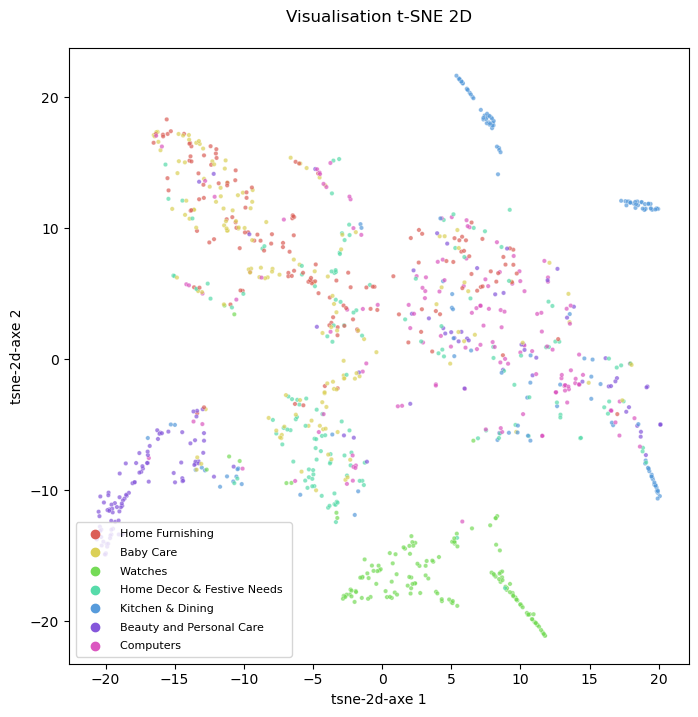

In [604]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc12,7, "categorie")

La projection des données issues de la NMF avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes peu distincts, avec des chevauchements, sauf pour les catégories "Watches" et "Kitchen & Dining". 

### 9.13.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [605]:
# Préparation des données
df_tsne_img_2d_enc12["label_kmeans"] = model_kmeans_enc12.labels_
df_tsne_img_2d_enc12

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,-13.374135,-4.127203,6
1,Baby Care,13.549410,2.821712,3
2,Baby Care,-10.068548,12.701484,6
3,Home Furnishing,-11.240374,10.675070,6
4,Home Furnishing,-12.880144,15.548373,6
...,...,...,...,...
1044,Baby Care,-3.587611,4.824704,6
1045,Baby Care,-3.297175,-2.310927,6
1046,Baby Care,3.928221,4.191758,6
1047,Baby Care,-2.737672,-1.464118,6


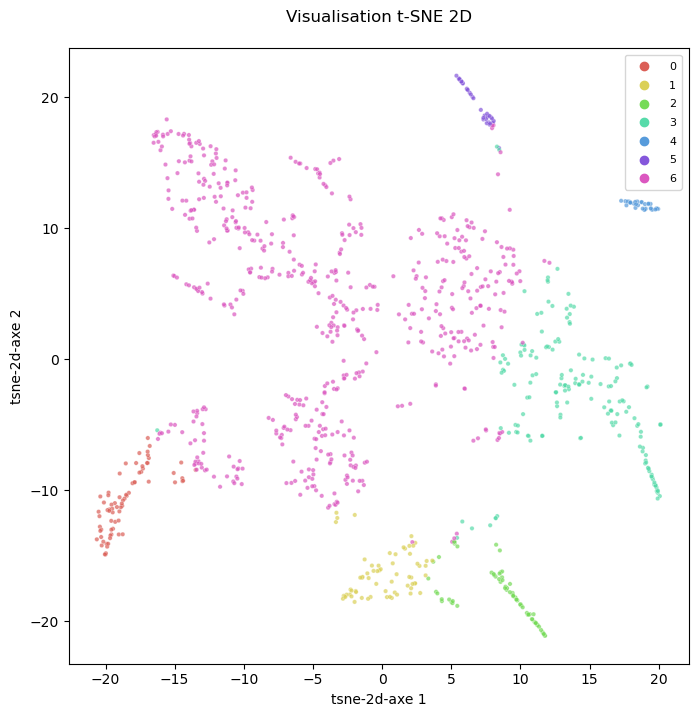

In [1238]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc12,7, "label_kmeans")

La projection des données issues de la NMF avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 6 relativement important, les autres de plus petite taille) avec des clusters relativment bbien séparés.

   ### 9.13.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,15 est médiocre**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

### 9.13.6 Qualité du clustering - Coefficient de silhouette

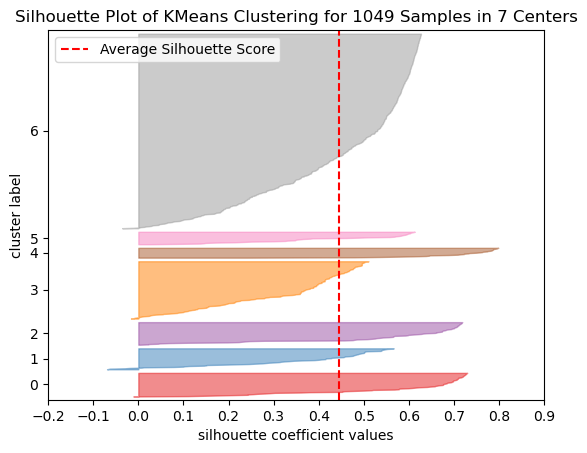

In [607]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_image_12, model_kmeans_enc12)

Le graphique ci-dessus montre:
- peu de clusters en erreur présentant des incohérences sur les données, 
- un cluster disproportionné en taille (exemple: cluster 6 (595 articles) par rapport aux autres clusters)
- un score de silhouette moyen (0,45), ce qui signifie que les clusters sont relativement denses et séparés.

Par conséquent, le clustering pour cet encodage des descriptions permet de séparer à peu près distinctement les clusters.

### 9.13.7 Qualité du clustering - Affichage matrice de confusion

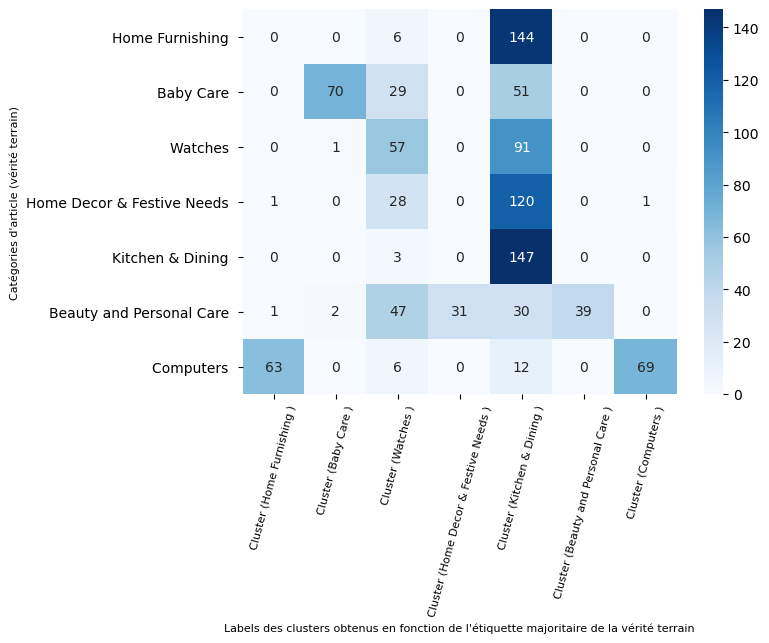

In [1239]:
# Réorganisation forcée de la matrice de confusion
argmax = [1, 0, 6, 2, 3, 5, 4]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc12.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans le 5ème cluster (très volumineux en nombre d'articles) et que les autres clusters contiennent très peu d'articles.

## 9.14 Encodage 13: encodage images - Réseau neurones ResNet50 et NMF

### 9.14.1 Modélisation non supervisée NMF et compression de features

In [618]:
# Modélisation / Réduction de dimension NMF
feat_nmf_img_resnet50 = modelisation_nmf(df_resnet50, 7)

Dimensions dataset avant NMF :  (1049, 100352)
Dimensions dataset après NMF :  (1049, 7)


### 9.14.2 Clustering k-means sur sortie NMF

In [871]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [872]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_img_resnet50_nmf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [625]:
hyp_encodage_enc13 = 13
encodage_image_13 = feat_nmf_img_resnet50
desc_encodage_txt_13 = "NMF_img_resnet50"

# Clustering k-means
model_kmeans_enc13, silhouette_enc13, ari_enc13, results_kmeans_enc13 = clustering_kmeans(feat_nmf_img_resnet50, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.44
Score moyen Adjusted Rand index (ARI) : 0.26


In [874]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_img_resnet50_nmf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_img_resnet50_nmf,
                                                                              hyp_encodage_enc13, desc_encodage_txt_13, "image", 
                                                                              silhouette_enc13, ari_enc13, results_kmeans_enc13)

In [875]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [876]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_img_resnet50_nmf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,NMF_img_resnet50,image,0,417
1,NMF_img_resnet50,image,1,267
2,NMF_img_resnet50,image,2,141
3,NMF_img_resnet50,image,3,102
4,NMF_img_resnet50,image,4,78
5,NMF_img_resnet50,image,5,23
6,NMF_img_resnet50,image,6,21


### 9.14.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images.

In [629]:
data_tsne_img_enc13 = classif_tsne(feat_nmf_img_resnet50, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.003s...
[t-SNE] Computed neighbors for 1049 samples in 0.047s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.622213
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.153217
[t-SNE] KL divergence after 300 iterations: 0.670757


In [630]:
# Préparation des données pour affichage des points 
df_tsne_img_2d_enc13 = pd.DataFrame()
df_tsne_img_2d_enc13["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_img_2d_enc13['tsne-2d-axe 1'] = data_tsne_img_enc13[:,0]
df_tsne_img_2d_enc13['tsne-2d-axe 2'] = data_tsne_img_enc13[:,1]
df_tsne_img_2d_enc13

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,1.096060,-11.062228
1,Baby Care,-16.913300,-7.249714
2,Baby Care,-12.683431,-6.858269
3,Home Furnishing,-13.791484,-1.743108
4,Home Furnishing,-9.235903,-5.354996
...,...,...,...
1044,Baby Care,-5.735366,0.961798
1045,Baby Care,13.286849,-10.033868
1046,Baby Care,-1.772704,3.270963
1047,Baby Care,14.290604,-10.201849


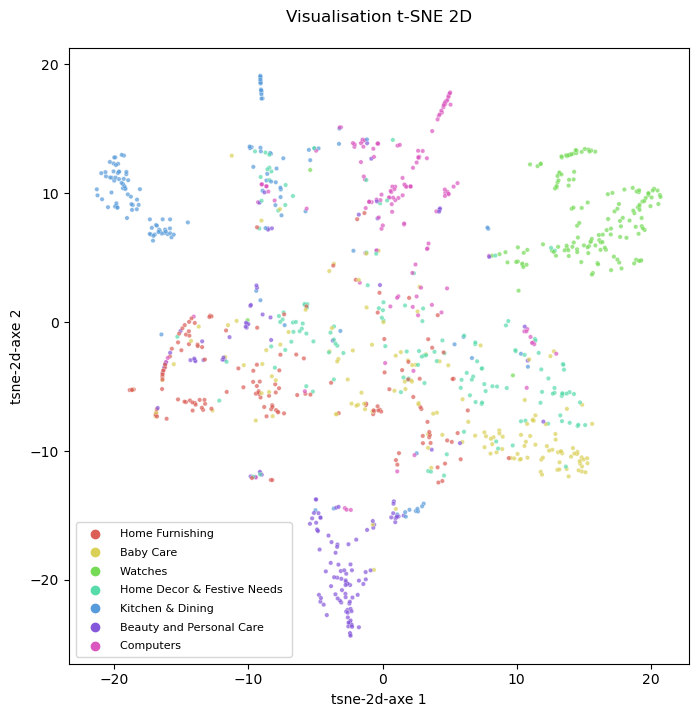

In [631]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc13,7, "categorie")

La projection des données issues de la NMF avec les vraies étiquettes (catégories d'article) sur le T-SNE montre des groupes peu distincts, et avec des chevauchements entre les groupes de catégories d'article ("Baby Care", "Home Furnishing", "Home Decor & Festive Needs" principalement). 

### 9.14.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [632]:
# Préparation des données
df_tsne_img_2d_enc13["label_kmeans"] = model_kmeans_enc13.labels_
df_tsne_img_2d_enc13

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,1.096060,-11.062228,1
1,Baby Care,-16.913300,-7.249714,0
2,Baby Care,-12.683431,-6.858269,0
3,Home Furnishing,-13.791484,-1.743108,0
4,Home Furnishing,-9.235903,-5.354996,0
...,...,...,...,...
1044,Baby Care,-5.735366,0.961798,0
1045,Baby Care,13.286849,-10.033868,1
1046,Baby Care,-1.772704,3.270963,0
1047,Baby Care,14.290604,-10.201849,1


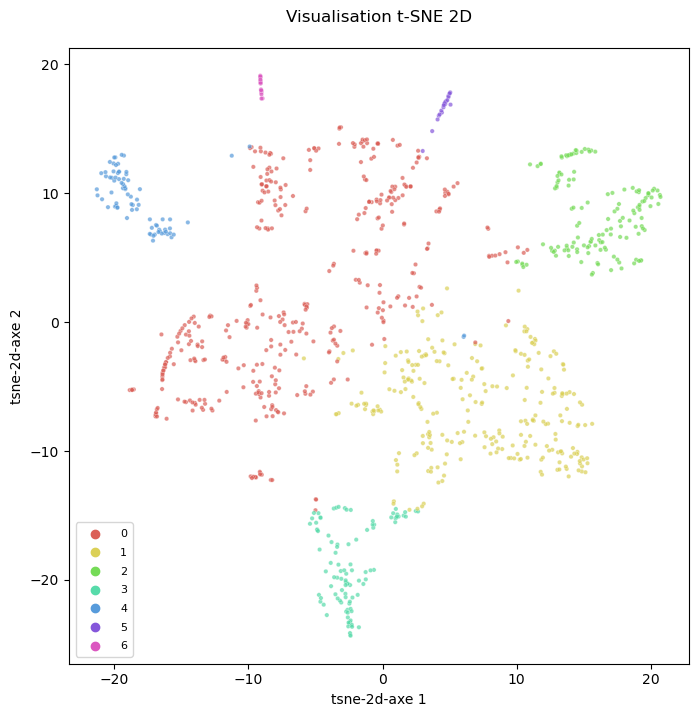

In [633]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc13,7, "label_kmeans")

La projection des données issues de la NFM avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 6 relativement important par rapport aux clusters 5 et 6),  avec des clusters relativement bien espacés.

   ### 9.14.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,26 est moyen**, ce qui signifie qu'il y a des similitudes entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article), mais pour toutes les paires de labels.

### 9.14.6 Qualité du clustering - Coefficient de silhouette

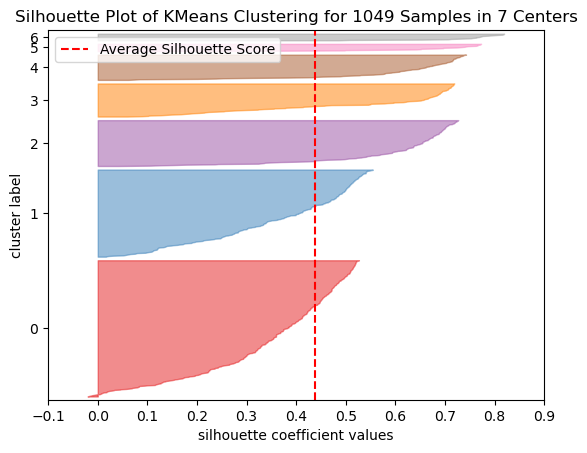

In [634]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_image_13, model_kmeans_enc13)

Le graphique ci-dessus montre:
- pas de clusters en erreur (sauf le cluster 0), mais présentant peu d'erreurs, 
- un cluster disproportionné en taille (exemple: cluster 0 (417 articles) par rapport aux autres clusters)
- un score de silhouette mauvais (0,44), ce qui signifie que les clusters sont relativement denses et séparés.

Par conséquent, le clustering pour cet encodage des descriptions permet de séparer à peu près distinctement les clusters.

### 9.14.7 Qualité du clustering - Affichage matrice de confusion

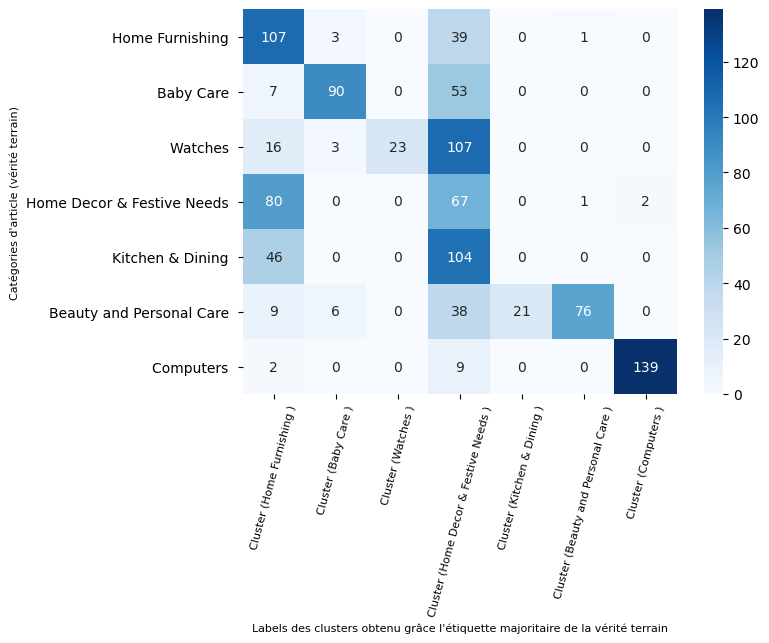

In [1165]:
# Réorganisation forcée de la matrice de confusion
argmax = [3, 0, 6, 1, 5, 2, 4]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc13.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans le 4ème cluster (très volumineux en nombre d'articles) et que certaines catégories d'articles sont rattachées majoritairement à un cluster:
- catégorie "Home Furnishing" au 1er cluster,
- catégorie "Baby Care" au 2ème cluster,
- catégorie "Computers" au 7ème cluster.

## 9.15 Encodage 14: encodage textes - BOW et lemmatisation / mindf et NMF

### 9.15.1 Modélisation non supervisée NMF et compression de features

In [636]:
# Modélisation / Réduction de dimension NMF
feat_nmf_bow_lemma_mindf = modelisation_nmf(df_bow_lemma_mindf, 7)

Dimensions dataset avant NMF :  (1049, 1015)
Dimensions dataset après NMF :  (1049, 7)


### 9.15.2 Clustering k-means sur sortie NMF

In [877]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [878]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_bow_lemma_mindf_nmf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [643]:
hyp_encodage_enc14 = 14
encodage_image_14 = feat_nmf_bow_lemma_mindf 
desc_encodage_txt_14 = "NMF_txt_bow_lemma_mindf"

# Clustering k-means
model_kmeans_enc14, silhouette_enc14, ari_enc14, results_kmeans_enc14 = clustering_kmeans(feat_nmf_bow_lemma_mindf, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.58
Score moyen Adjusted Rand index (ARI) : 0.06


In [880]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_bow_lemma_mindf_nmf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_bow_lemma_mindf_nmf,
                                                                              hyp_encodage_enc14, desc_encodage_txt_14, "texte", 
                                                                              silhouette_enc14, ari_enc14, results_kmeans_enc14)

In [881]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [882]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_bow_lemma_mindf_nmf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,NMF_txt_bow_lemma_mindf,texte,0,6
1,NMF_txt_bow_lemma_mindf,texte,1,571
2,NMF_txt_bow_lemma_mindf,texte,2,346
3,NMF_txt_bow_lemma_mindf,texte,3,31
4,NMF_txt_bow_lemma_mindf,texte,4,6
5,NMF_txt_bow_lemma_mindf,texte,5,76
6,NMF_txt_bow_lemma_mindf,texte,6,13


### 9.15.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images.

In [647]:
data_tsne_img_enc14 = classif_tsne(feat_nmf_bow_lemma_mindf, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.002s...
[t-SNE] Computed neighbors for 1049 samples in 3.269s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.001967
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.946373
[t-SNE] KL divergence after 300 iterations: 0.377533


In [648]:
# Préparation des données pour affichage des points 
df_tsne_img_2d_enc14 = pd.DataFrame()
df_tsne_img_2d_enc14["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_img_2d_enc14['tsne-2d-axe 1'] = data_tsne_img_enc14[:,0]
df_tsne_img_2d_enc14['tsne-2d-axe 2'] = data_tsne_img_enc14[:,1]
df_tsne_img_2d_enc14

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,15.445300,8.037363
1,Baby Care,10.233444,4.829822
2,Baby Care,17.170244,6.975984
3,Home Furnishing,16.420113,7.925333
4,Home Furnishing,17.512650,8.737867
...,...,...,...
1044,Baby Care,12.522898,3.992111
1045,Baby Care,2.306921,2.660398
1046,Baby Care,-12.221103,-2.378493
1047,Baby Care,-14.706263,-1.933568


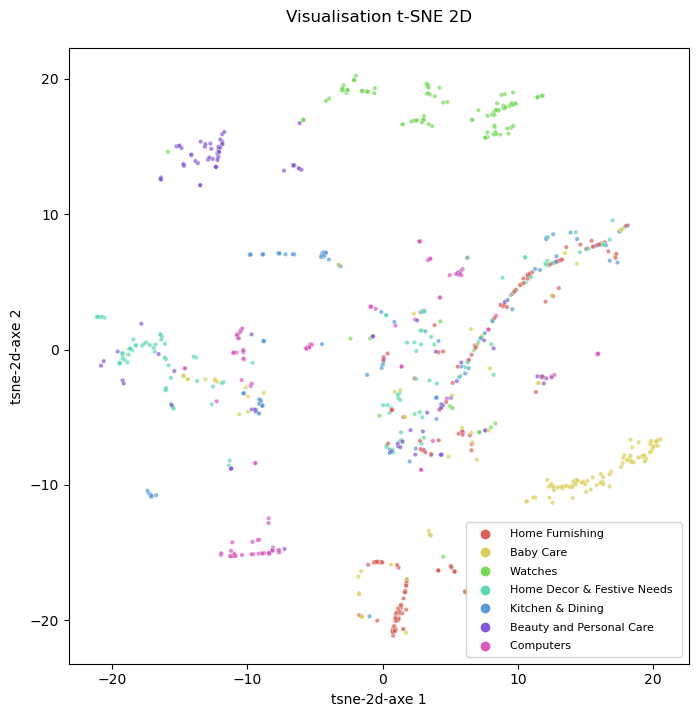

In [649]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc14,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'article) sur le T-SNE montre des groupes non distincts, et avec des chevauchements entre les groupes de catégories d'article (sauf pour les catégories "Watches" et "Baby Care". 

### 9.15.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [650]:
# Préparation des données
df_tsne_img_2d_enc14["label_kmeans"] = model_kmeans_enc14.labels_
df_tsne_img_2d_enc14

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,15.445300,8.037363,2
1,Baby Care,10.233444,4.829822,2
2,Baby Care,17.170244,6.975984,2
3,Home Furnishing,16.420113,7.925333,2
4,Home Furnishing,17.512650,8.737867,2
...,...,...,...,...
1044,Baby Care,12.522898,3.992111,2
1045,Baby Care,2.306921,2.660398,2
1046,Baby Care,-12.221103,-2.378493,1
1047,Baby Care,-14.706263,-1.933568,1


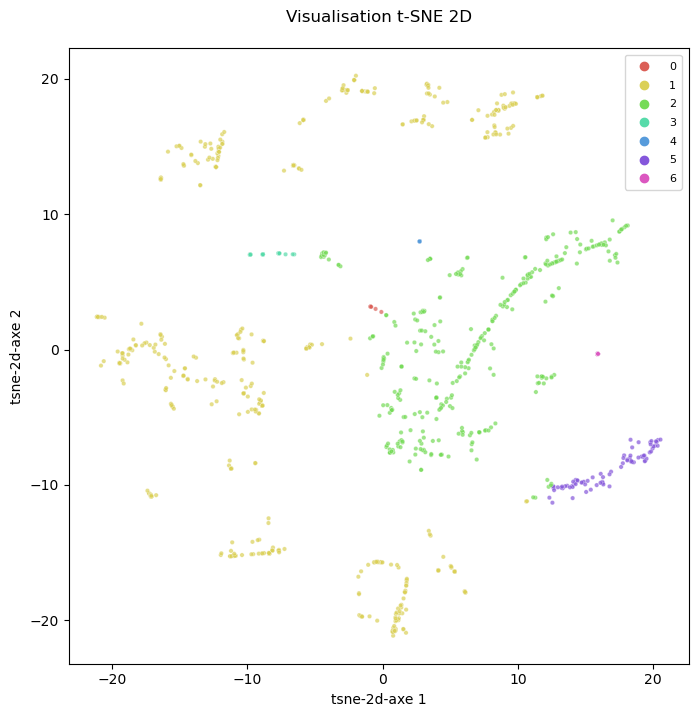

In [651]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc14,7, "label_kmeans")

La projection des données issues de la PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 1 et 2 relativement importants, les autres de très petite taille) avec clusters peu denses (notamment les clusters 1 et 2).

   ### 9.15.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,06 est mauvais**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

### 9.15.6 Qualité du clustering - Coefficient de silhouette

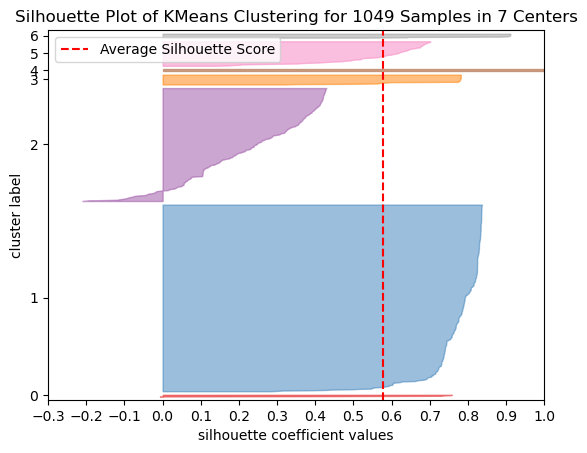

In [652]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_image_14, model_kmeans_enc14)

Le graphique ci-dessus montre:
- pas de clusters en erreur (sauf le cluster 2) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que les données de ce cluster sont erronées.
- un cluster disproportionné en taille (exemple: clusters 1 et 2 par rapport aux autres clusters)
- un score de silhouette mauvais (0,58), ce qui signifie que les clusters sont relativement bien séparés.

Par conséquent, le clustering pour cet encodage des descriptions permet de séparer à peu près distinctement les clusters.

### 9.15.7 Qualité du clustering - Affichage matrice de confusion

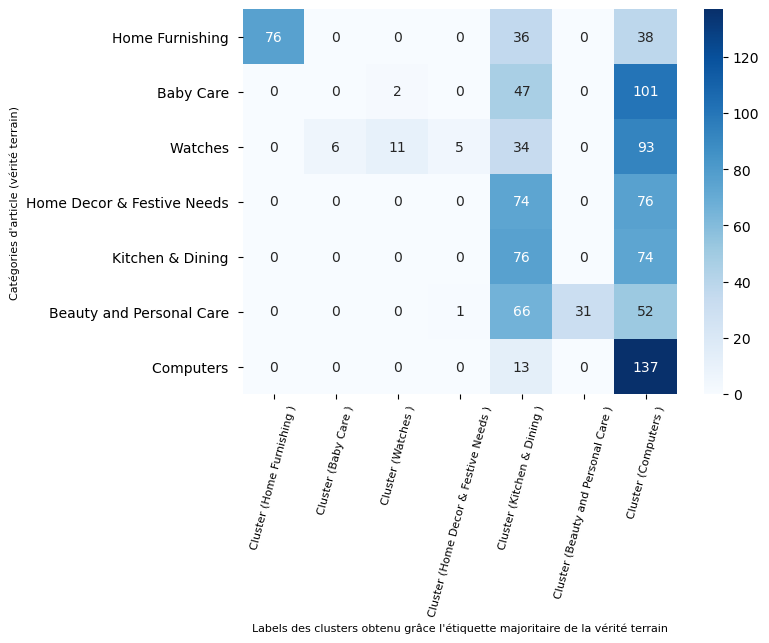

In [1169]:
# Réorganisation forcée de la matrice de confusion
argmax = [3, 6, 4, 5, 1, 0, 2]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc14.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 5ème et 7ème clusters(très volumineux en nombre d'articles) et que les autres clusters contiennent très peu d'articles.

## 9.16 Encodage 15: encodage textes - TF-IDF - Lemma /mindf /ngram et NMF

### 9.16.1 Modélisation non supervisée NMF et compression de features

In [654]:
# Modélisation / Réduction de dimension NMF
feat_nmf_tfidf_lemma_mindf_ngram = modelisation_nmf(df_tfidf_lemma_mindf_ngram, 7)

Dimensions dataset avant NMF :  (1049, 2346)
Dimensions dataset après NMF :  (1049, 7)


### 9.16.2 Clustering k-means sur sortie NMF

In [883]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [884]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_tfidf_lemma_mindf_ngram_nmf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [658]:
hyp_encodage_enc15 = 15
encodage_txt_15 = feat_nmf_tfidf_lemma_mindf_ngram
desc_encodage_txt_15 = "NMF_txt_tfidf_lemma_mindf_ngram"

# Clustering k-means
model_kmeans_enc15, silhouette_enc15, ari_enc15, results_kmeans_enc15 = clustering_kmeans(feat_nmf_tfidf_lemma_mindf_ngram, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.63
Score moyen Adjusted Rand index (ARI) : 0.23


In [886]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_tfidf_lemma_mindf_ngram_nmf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_tfidf_lemma_mindf_ngram_nmf,
                                                                              hyp_encodage_enc15, desc_encodage_txt_15, "texte", 
                                                                              silhouette_enc15, ari_enc15, results_kmeans_enc15)

In [887]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [888]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_tfidf_lemma_mindf_ngram_nmf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,NMF_txt_tfidf_lemma_mindf_ngram,texte,0,432
1,NMF_txt_tfidf_lemma_mindf_ngram,texte,1,137
2,NMF_txt_tfidf_lemma_mindf_ngram,texte,2,95
3,NMF_txt_tfidf_lemma_mindf_ngram,texte,3,149
4,NMF_txt_tfidf_lemma_mindf_ngram,texte,4,21
5,NMF_txt_tfidf_lemma_mindf_ngram,texte,5,54
6,NMF_txt_tfidf_lemma_mindf_ngram,texte,6,161


### 9.16.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [665]:
data_tsne_text_enc15 = classif_tsne(feat_nmf_tfidf_lemma_mindf_ngram, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.001s...
[t-SNE] Computed neighbors for 1049 samples in 0.026s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.013647
[t-SNE] KL divergence after 250 iterations with early exaggeration: 50.035042
[t-SNE] KL divergence after 300 iterations: 0.386712


In [666]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc15 = pd.DataFrame()
df_tsne_text_2d_enc15["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc15['tsne-2d-axe 1'] = data_tsne_text_enc15[:,0]
df_tsne_text_2d_enc15['tsne-2d-axe 2'] = data_tsne_text_enc15[:,1]
df_tsne_text_2d_enc15

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,-0.955248,0.450814
1,Baby Care,0.983833,0.172760
2,Baby Care,0.096100,1.406400
3,Home Furnishing,-0.919790,2.672840
4,Home Furnishing,-0.575412,2.438250
...,...,...,...
1044,Baby Care,-6.060723,-12.336810
1045,Baby Care,-1.744383,-11.785559
1046,Baby Care,12.530756,-1.163836
1047,Baby Care,8.120934,2.005844


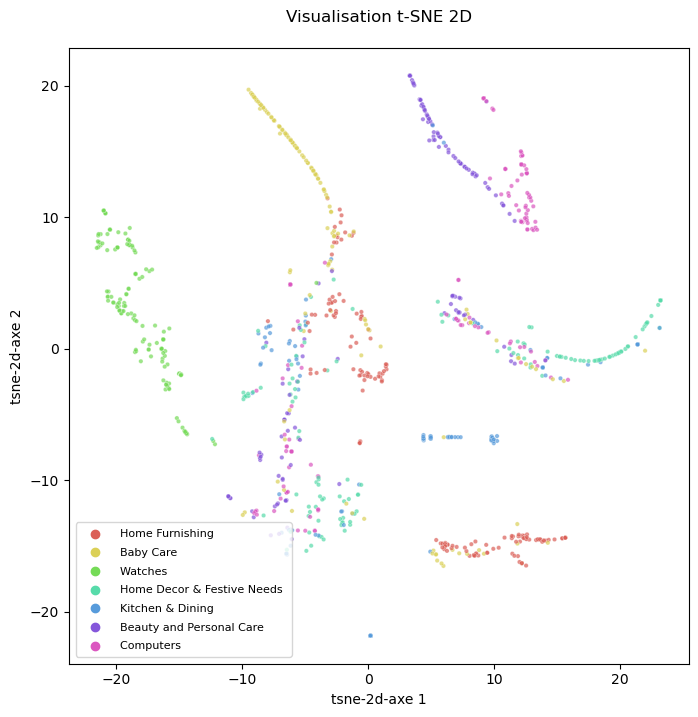

In [667]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc15,7, "categorie")

La projection des données issues de la NMF avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes peu distincts, mais avec des chevauchements entre les groupes de catégories d'articles (surtout pour les catégories "Computers" et "Home Decor & Festive Needs").

### 9.16.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [668]:
# Préparation des données
df_tsne_text_2d_enc15["label_kmeans"] = model_kmeans_enc15.labels_
df_tsne_text_2d_enc15

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,-0.955248,0.450814,0
1,Baby Care,0.983833,0.172760,0
2,Baby Care,0.096100,1.406400,0
3,Home Furnishing,-0.919790,2.672840,0
4,Home Furnishing,-0.575412,2.438250,0
...,...,...,...,...
1044,Baby Care,-6.060723,-12.336810,0
1045,Baby Care,-1.744383,-11.785559,0
1046,Baby Care,12.530756,-1.163836,6
1047,Baby Care,8.120934,2.005844,6


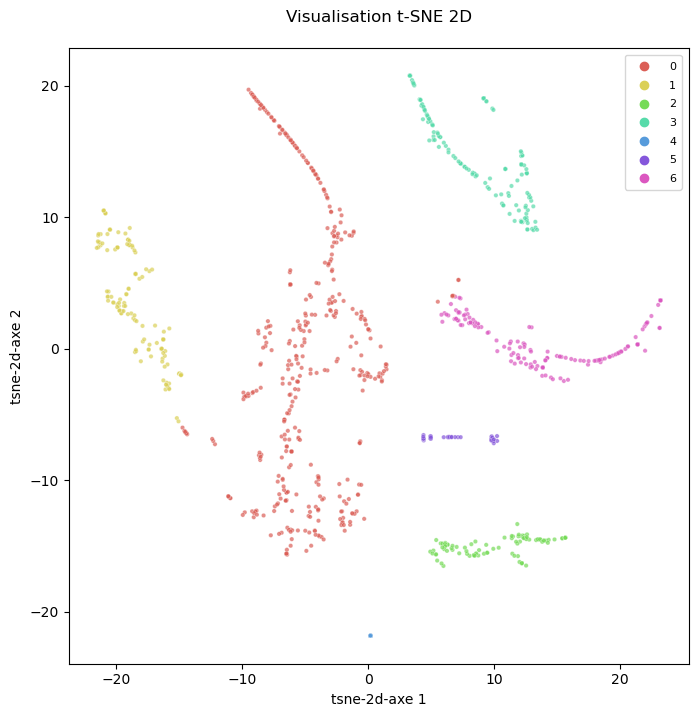

In [669]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc15,7, "label_kmeans")

La projection des données issues de la NMF avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 4 et 5 des très petite taille), mais les clusters sont espacés et relativement denses.

   ### 9.16.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,23 est moyen**, ce qui signifie qu'il y a quelques similitudes entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article).

### 9.16.6 Qualité du clustering - Coefficient de silhouette

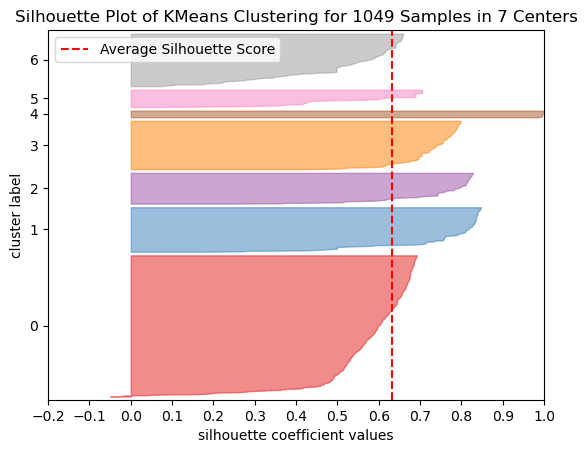

In [670]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_15, model_kmeans_enc15)

Le graphique ci-dessus montre:
- un cluster (0) présentant principalement quelques petites erreurs sur les données, 
- un cluster disproportionné en taille (exemple: cluster 0 par rapport aux autres clusters)
- un score de silhouette moyenne médiocre (0,63), ce qui signifie que les clusters sont bien séparés et denses.

Par conséquent, le clustering pour cet encodage des descriptions permet de séparer distinctement les clusters.

### 9.16.7 Qualité du clustering - Affichage matrice de confusion

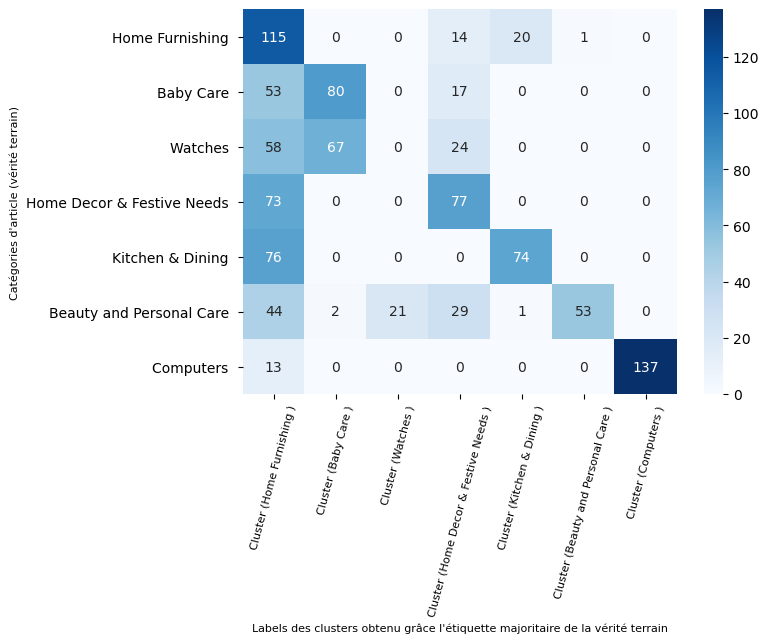

In [1175]:
# Réorganisation forcée de la matrice de confusion
argmax = [0, 6, 4, 1, 2, 5, 3]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc15.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 1er et 4ème clusters (très volumineux en nombre d'articles). Toutefois, le 1er cluster semble contenir essentiellement la catégorie "Home Furnishing" et le 7ème cluster, la catégorie "Computers". 

## 9.17 Encodage 16: encodage textes -  Word / Sentence embedding - Doc2Vec et NMF

### 9.17.1 Modélisation non supervisée NMF et compression de features

In [682]:
# Appel de la fonction de standardisation
df_doc2vec_std = std_data(df_doc2vec, MinMaxScaler())

In [684]:
# Modélisation / Réduction de dimension NMF
feat_nmf_doc2vec = modelisation_nmf(df_doc2vec_std, 7)

Dimensions dataset avant NMF :  (1049, 1000)
Dimensions dataset après NMF :  (1049, 7)


### 9.17.2 Clustering k-means sur sortie NMF

In [889]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [890]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_doc2vec_nmf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [694]:
hyp_encodage_enc16 = 16
encodage_txt_16 = feat_nmf_doc2vec
desc_encodage_txt_16 = "NMF_txt_doc2vec"

# Clustering k-means
model_kmeans_enc16, silhouette_enc16, ari_enc16, results_kmeans_enc16 = clustering_kmeans(feat_nmf_doc2vec, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.43
Score moyen Adjusted Rand index (ARI) : 0.02


In [892]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_doc2vec_nmf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_doc2vec_nmf,
                                                                              hyp_encodage_enc16, desc_encodage_txt_16, "texte", 
                                                                              silhouette_enc16, ari_enc16, results_kmeans_enc16)

In [893]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [894]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_doc2vec_nmf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,NMF_txt_doc2vec,texte,0,192
1,NMF_txt_doc2vec,texte,1,29
2,NMF_txt_doc2vec,texte,2,700
3,NMF_txt_doc2vec,texte,3,32
4,NMF_txt_doc2vec,texte,4,33
5,NMF_txt_doc2vec,texte,5,45
6,NMF_txt_doc2vec,texte,6,18


### 9.17.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [698]:
data_tsne_text_enc16 = classif_tsne(feat_nmf_doc2vec, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.003s...
[t-SNE] Computed neighbors for 1049 samples in 0.058s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.003020
[t-SNE] KL divergence after 250 iterations with early exaggeration: 64.685104
[t-SNE] KL divergence after 300 iterations: 0.891120


In [699]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc16 = pd.DataFrame()
df_tsne_text_2d_enc16["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc16['tsne-2d-axe 1'] = data_tsne_text_enc16[:,0]
df_tsne_text_2d_enc16['tsne-2d-axe 2'] = data_tsne_text_enc16[:,1]
df_tsne_text_2d_enc16

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,2.021032,-13.258659
1,Baby Care,2.215991,5.602308
2,Baby Care,1.419631,-14.925582
3,Home Furnishing,3.387066,-12.192080
4,Home Furnishing,2.170305,-16.056524
...,...,...,...
1044,Baby Care,-2.262564,-17.855755
1045,Baby Care,1.308954,-17.355829
1046,Baby Care,-13.922002,2.590626
1047,Baby Care,-0.885381,9.780322


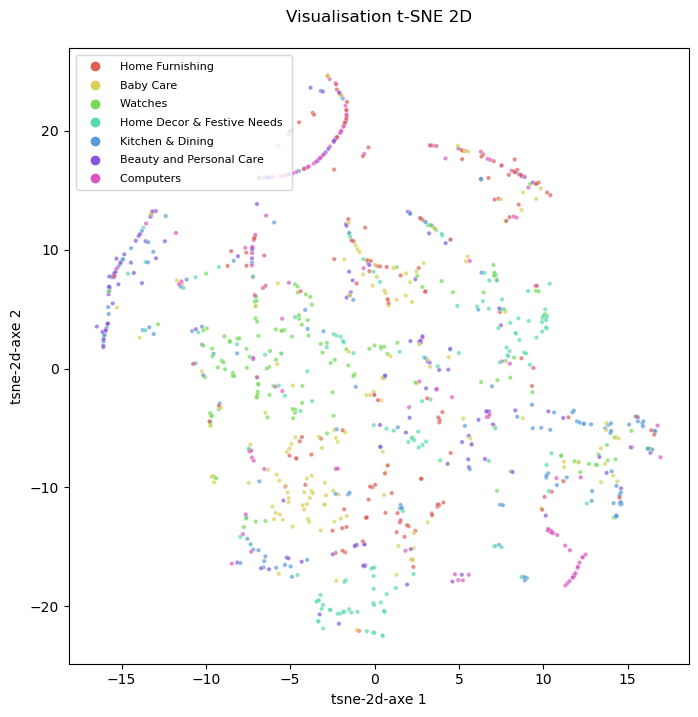

In [700]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc16,7, "categorie")

La projection des données issues de la NMF avec les vraies étiquettes (catégories d'article) sur le T-SNE montre des groupes non distincts, avec des chevauchements entre les groupes de catégories d'article. 

### 9.17.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [702]:
# Préparation des données
df_tsne_text_2d_enc16["label_kmeans"] = model_kmeans_enc16.labels_
df_tsne_text_2d_enc16

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,2.021032,-13.258659,5
1,Baby Care,2.215991,5.602308,2
2,Baby Care,1.419631,-14.925582,5
3,Home Furnishing,3.387066,-12.192080,0
4,Home Furnishing,2.170305,-16.056524,5
...,...,...,...,...
1044,Baby Care,-2.262564,-17.855755,1
1045,Baby Care,1.308954,-17.355829,3
1046,Baby Care,-13.922002,2.590626,2
1047,Baby Care,-0.885381,9.780322,2


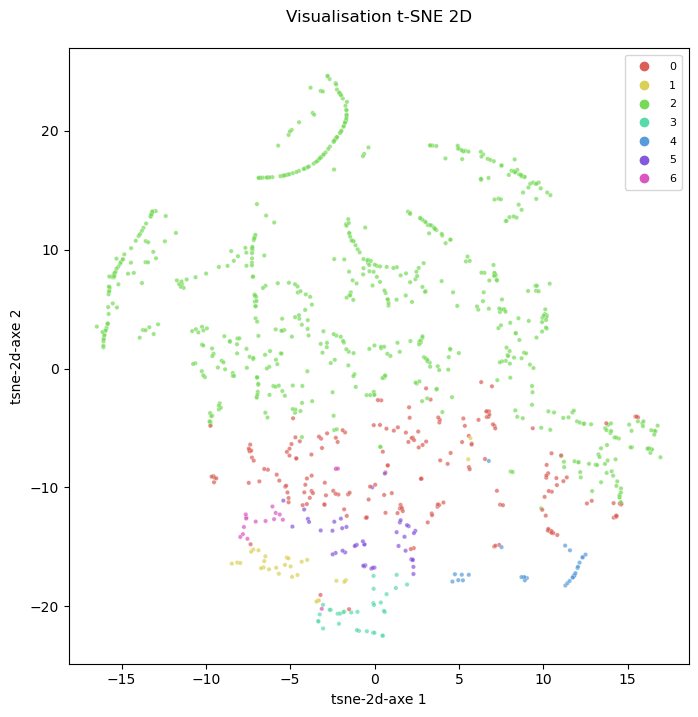

In [703]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc16,7, "label_kmeans")

La projection des données issues de la NMF avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 2 relativement important, les autres de plus petite taille) avec peu de chevauchements entre les clusters, mais avec des clusters non denses.

   ### 9.17.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,02 est très mauvais**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

Il n'y a pratiquement pas de similitudes entre les catégories d'articles et les labels des clusters.

### 9.17.6 Qualité du clustering - Coefficient de silhouette

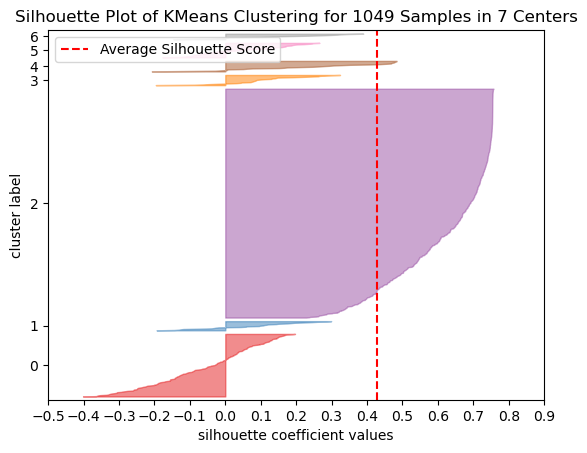

In [704]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_16, model_kmeans_enc16)

Le graphique ci-dessus montre:
- des clusters présentant principalement des erreurs (sauf le cluster 2) avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que les données des clusters sont incorrectes. 
- un cluster disproportionné en taille (exemple: cluster 2 par rapport aux autres clusters)
- un score de silhouette moyenne médiocre (0,43), ce qui signifie que les clusters sont bien séparés.

Par conséquent, le clustering pour cet encodage des descriptions permet de séparer distinctement les clusters, mais les clusters ne sont pas denses.

### 9.17.7 Qualité du clustering - Affichage matrice de confusion

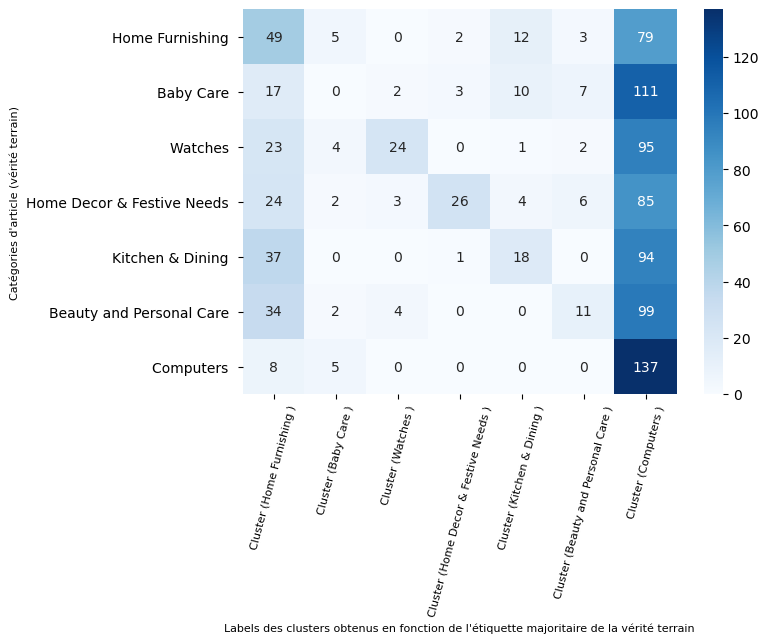

In [1240]:
# Réorganisation forcée de la matrice de confusion
argmax = [0, 5, 6, 3, 2, 4, 1]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc16.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans le 7ème cluster (très volumineux en nombre d'articles) et que les autres clusters contiennent moins d'articles.

## 9.18 Encodage 17: encodage images - SIFT avec NMF

### 9.18.1 Modélisation non supervisée NMF et compression des features

In [706]:
# Modélisation / Réduction de dimension NMF
feat_nmf_bovw_sift = modelisation_nmf(df_bovw_sift, 7)

Dimensions dataset avant NMF :  (1049, 712)
Dimensions dataset après NMF :  (1049, 7)


### 9.18.2 Clustering k-means sur sortie NMF

In [895]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [903]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_bovw_sift_nmf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [711]:
hyp_encodage_enc17 = 17
encodage_txt_17 = feat_nmf_bovw_sift
desc_encodage_txt_17 = "NMF_img_bovw_sift"

# Clustering k-means
model_kmeans_enc17, silhouette_enc17, ari_enc17, results_kmeans_enc17 = clustering_kmeans(feat_nmf_bovw_sift, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.31
Score moyen Adjusted Rand index (ARI) : 0.02


In [904]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_bovw_sift_nmf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_bovw_sift_nmf,
                                                                              hyp_encodage_enc17, desc_encodage_txt_17, "image", 
                                                                              silhouette_enc17, ari_enc17, results_kmeans_enc17)

In [905]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [906]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_bovw_sift_nmf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,NMF_img_bovw_sift,image,0,426
1,NMF_img_bovw_sift,image,1,10
2,NMF_img_bovw_sift,image,2,24
3,NMF_img_bovw_sift,image,3,86
4,NMF_img_bovw_sift,image,4,12
5,NMF_img_bovw_sift,image,5,489
6,NMF_img_bovw_sift,image,6,2


### 9.18.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes.

In [715]:
data_tsne_text_enc17 = classif_tsne(feat_nmf_bovw_sift, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.006s...
[t-SNE] Computed neighbors for 1049 samples in 0.030s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.123975
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.861996
[t-SNE] KL divergence after 300 iterations: 0.598454


In [716]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc17 = pd.DataFrame()
df_tsne_text_2d_enc17["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc17['tsne-2d-axe 1'] = data_tsne_text_enc17[:,0]
df_tsne_text_2d_enc17['tsne-2d-axe 2'] = data_tsne_text_enc17[:,1]
df_tsne_text_2d_enc17

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,-11.508244,2.617759
1,Baby Care,-3.869392,5.465584
2,Baby Care,-19.260874,11.299286
3,Home Furnishing,-11.015615,-0.255432
4,Home Furnishing,-11.809124,-3.330311
...,...,...,...
1044,Baby Care,-18.032568,-0.828561
1045,Baby Care,-15.740552,12.209831
1046,Baby Care,-17.114367,-7.628066
1047,Baby Care,-12.546276,13.868424


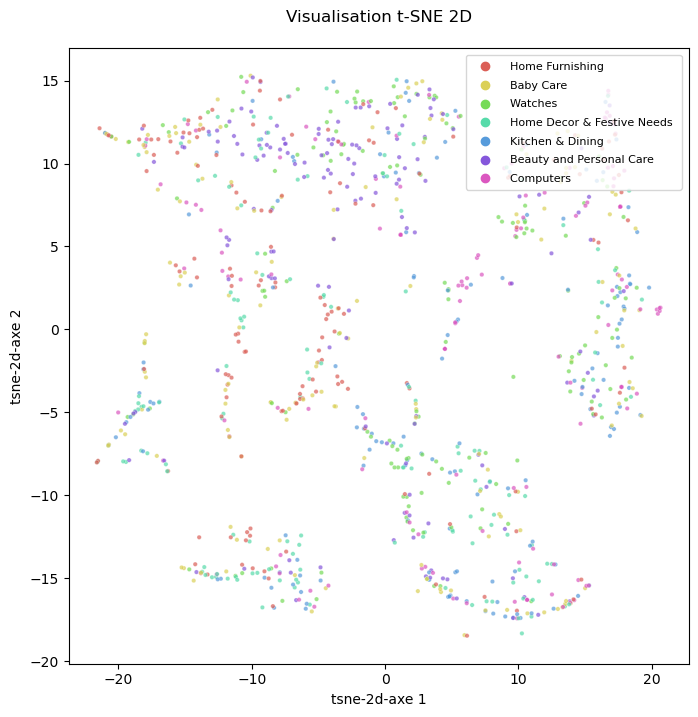

In [717]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc17,7, "categorie")

La projection des données issues de la NMF avec les vraies étiquettes (catégories d'article) sur le T-SNE ne montre pas des groupes distincts, avec des chevauchements entre les groupes de catégories d'article. 

### 9.18.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [719]:
# Préparation des données
df_tsne_text_2d_enc17["label_kmeans"] = model_kmeans_enc17.labels_
df_tsne_text_2d_enc17

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,-11.508244,2.617759,5
1,Baby Care,-3.869392,5.465584,5
2,Baby Care,-19.260874,11.299286,5
3,Home Furnishing,-11.015615,-0.255432,5
4,Home Furnishing,-11.809124,-3.330311,5
...,...,...,...,...
1044,Baby Care,-18.032568,-0.828561,5
1045,Baby Care,-15.740552,12.209831,5
1046,Baby Care,-17.114367,-7.628066,5
1047,Baby Care,-12.546276,13.868424,5


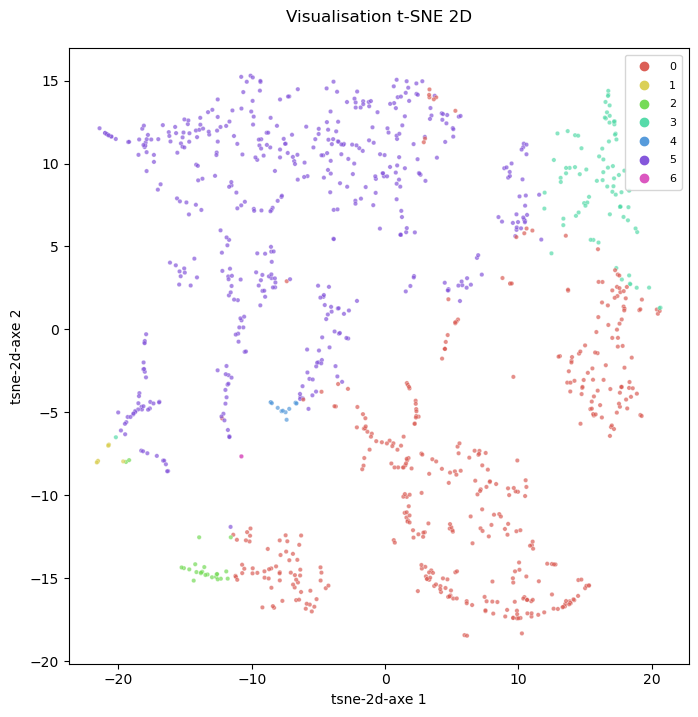

In [720]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc17,7, "label_kmeans")

La projection des données issues de la NMF avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 0 et 5 relativement importants, les autres de plus petite taille) avec des clusters relativement bien espacés, mais pas denses.

   ### 9.18.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,02 est très mauvais**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

### 9.18.6 Qualité du clustering - Coefficient de silhouette

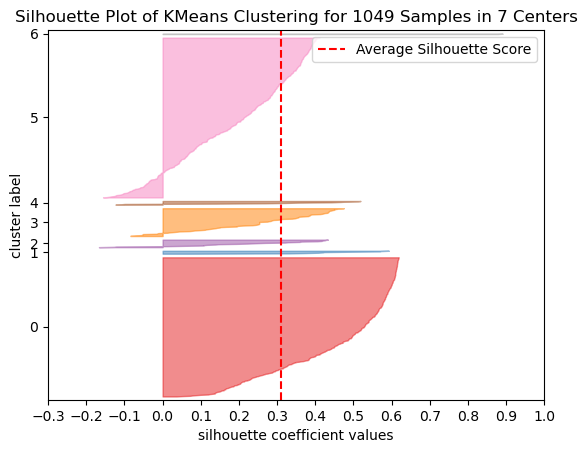

In [721]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_17, model_kmeans_enc17)

Le graphique ci-dessus montre:
-  des clusters avec des erreurs (notamment le cluster 5 avec un score de silhouette inférieur au score moyen de silhouette), mais assui les clusters 2, 3, 4, 
- des clusters disproportionnés en taille (exemple: clusters 0 et 5 par rapport aux autres clusters)
- un score de silhouette moyenne moyen (0,31), ce qui signifie que les clusters sont assez bien séparés mais peu denses.

Par conséquent, le clustering pour cet encodage des descriptions permet de séparer distinctement les clusters.

### 9.18.7 Qualité du clustering - Affichage matrice de confusion

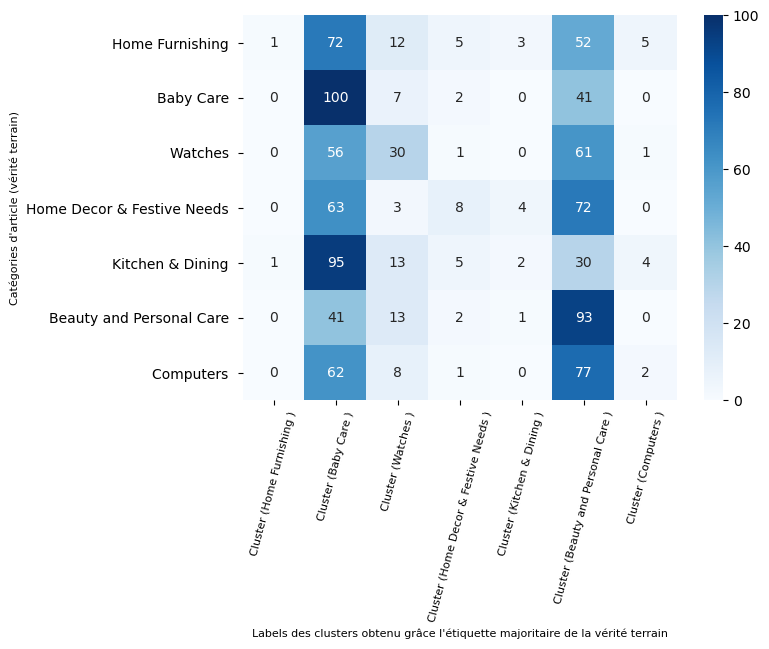

In [1182]:
# Réorganisation forcée de la matrice de confusion
argmax = [5, 4, 3, 2, 6, 1, 0]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc17.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 2ème et 6ème clusters 0 (très volumineux en nombre d'articles) et que les autres clusters contiennent moins d'articles.

## 9.19 Encodage 18: Encodage textes + images - TFIDF / ResNet50 avec PCA

### 9.19.1 Réduction de dimensions PCA

In [751]:
# Réduction de dimension PCA
feat_pca_txtimg_tfidf_resnet50 = calcul_pca(df_tfidf_resnet50, 0.95, None)

Dimensions dataset avant réduction PCA :  (1049, 102698)
Dimensions dataset après réduction PCA :  (1049, 807)


### 9.19.2 Clustering k-means sur sortie PCA

In [909]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [911]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_tfidf_resnet50 = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [752]:
hyp_encodage_enc18 = 18
encodage_txt_18 = feat_pca_txtimg_tfidf_resnet50
desc_encodage_txt_18 = "PCA_txt_img_tfidf_resnet50"

# Clustering k-means
model_kmeans_enc18, silhouette_enc18, ari_enc18, results_kmeans_enc18 = clustering_kmeans(feat_pca_txtimg_tfidf_resnet50, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.02
Score moyen Adjusted Rand index (ARI) : 0.25


In [913]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_tfidf_resnet50 = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_tfidf_resnet50,
                                                                              hyp_encodage_enc18, desc_encodage_txt_18, "texte+image", 
                                                                              silhouette_enc18, ari_enc18, results_kmeans_enc18)

In [914]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [915]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_tfidf_resnet50

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,PCA_txt_img_tfidf_resnet50,texte+image,0,138
1,PCA_txt_img_tfidf_resnet50,texte+image,1,42
2,PCA_txt_img_tfidf_resnet50,texte+image,2,176
3,PCA_txt_img_tfidf_resnet50,texte+image,3,158
4,PCA_txt_img_tfidf_resnet50,texte+image,4,73
5,PCA_txt_img_tfidf_resnet50,texte+image,5,390
6,PCA_txt_img_tfidf_resnet50,texte+image,6,72


### 9.19.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes+images.

In [765]:
data_tsne_text_enc18 = classif_tsne(feat_pca_txtimg_tfidf_resnet50, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.002s...
[t-SNE] Computed neighbors for 1049 samples in 0.123s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 127.791739
[t-SNE] KL divergence after 250 iterations with early exaggeration: 100.396652
[t-SNE] KL divergence after 300 iterations: 2.060613


In [766]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc18 = pd.DataFrame()
df_tsne_text_2d_enc18["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc18['tsne-2d-axe 1'] = data_tsne_text_enc18[:,0]
df_tsne_text_2d_enc18['tsne-2d-axe 2'] = data_tsne_text_enc18[:,1]
df_tsne_text_2d_enc18

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,7.982049,6.928343
1,Baby Care,-9.735081,6.417818
2,Baby Care,-15.261873,1.539043
3,Home Furnishing,-21.229946,3.154028
4,Home Furnishing,-20.078899,0.299130
...,...,...,...
1044,Baby Care,-19.157547,4.959881
1045,Baby Care,-3.068615,-10.649351
1046,Baby Care,-12.094961,7.407525
1047,Baby Care,-3.092133,-10.885370


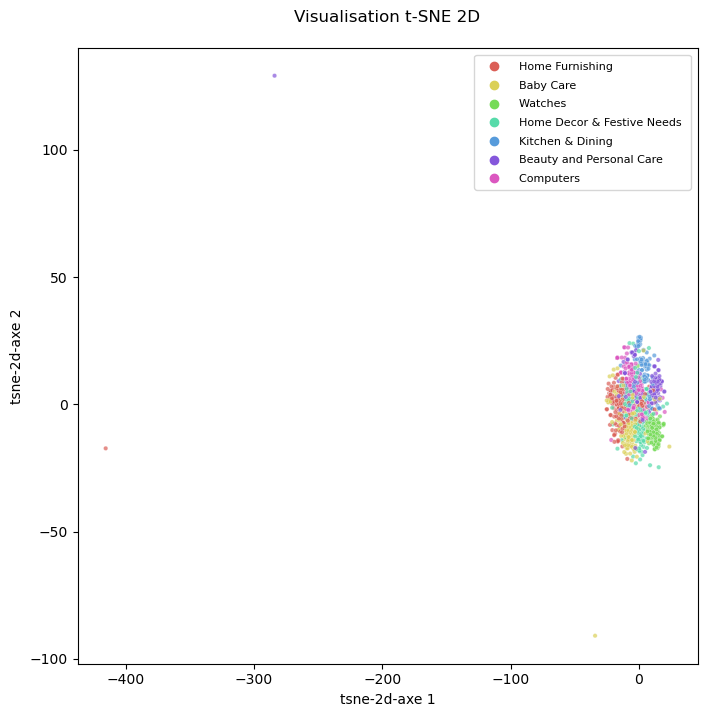

In [767]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc18,7, "categorie")

La projection des données issues de la PCA avec les vraies étiquettes (catégories d'article) sur le T-SNE ne montre pas des groupes distincts, mais avec des chevauchements entre les groupes de catégories d'article. 

### 9.19.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [768]:
# Préparation des données
df_tsne_text_2d_enc18["label_kmeans"] = model_kmeans_enc18.labels_
df_tsne_text_2d_enc18

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,7.982049,6.928343,2
1,Baby Care,-9.735081,6.417818,5
2,Baby Care,-15.261873,1.539043,5
3,Home Furnishing,-21.229946,3.154028,5
4,Home Furnishing,-20.078899,0.299130,5
...,...,...,...,...
1044,Baby Care,-19.157547,4.959881,5
1045,Baby Care,-3.068615,-10.649351,3
1046,Baby Care,-12.094961,7.407525,5
1047,Baby Care,-3.092133,-10.885370,3


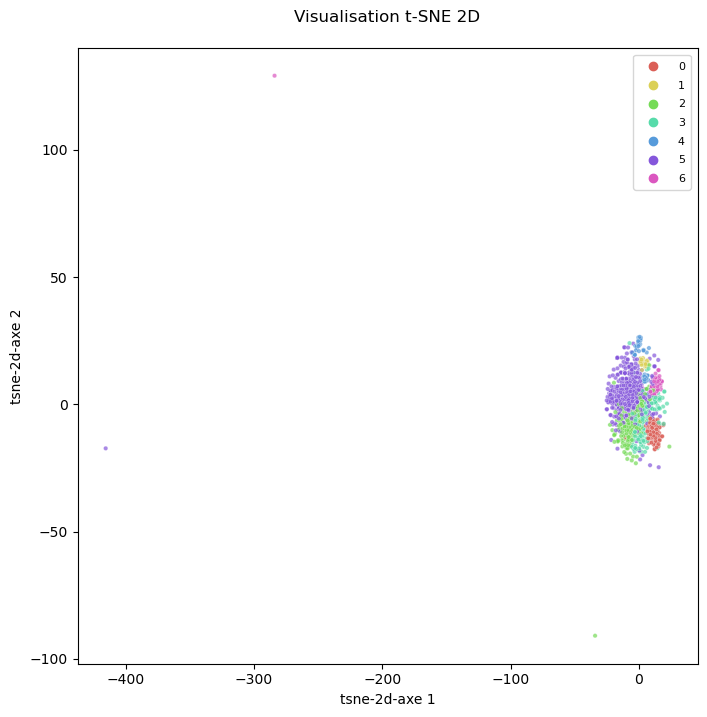

In [769]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc18,7, "label_kmeans")

La projection des données issues de la NMF avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 5 relativement important, les autres de plus petite taille) avec des chevauchements entre les clusters.

   ### 9.19.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,25 est moyen**, ce qui signifie qu'il y a quelques similitudes entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article).

### 9.19.6 Qualité du clustering - Coefficient de silhouette

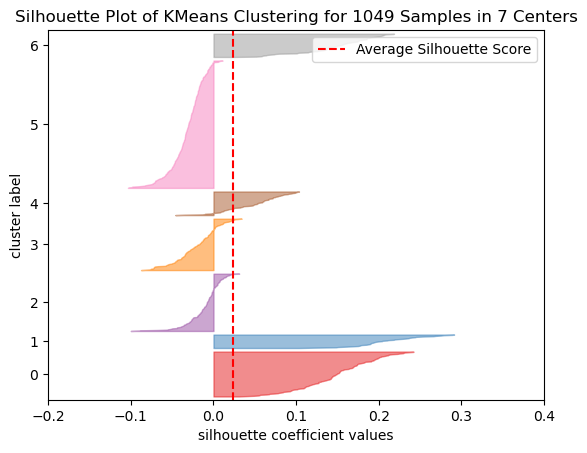

In [770]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_18, model_kmeans_enc18)

Le graphique ci-dessus montre:
-  des clusters avec des erreurs (clusters 2, 3, 4 et 5), ce qui signifie que les données des ces clusters sont incorrectes
- des cluster disproportionnés en taille (exemple: clusters 5 par rapport aux autres clusters)
- un score de silhouette moyenne très mauvais (0,02), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.19.7 Qualité du clustering - Affichage matrice de confusion

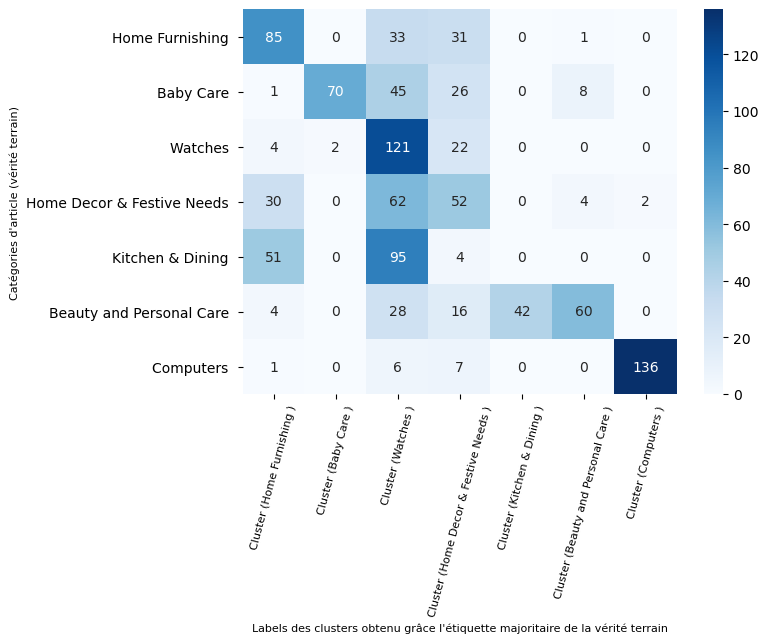

In [1185]:
# Réorganisation forcée de la matrice de confusion
argmax = [6, 4, 0, 3, 5, 2, 1]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc18.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 1er, 3ème et 4ème clusters, mais on voit que:
- le 1er cluster regroupe principalement les articles de la catégorie "Home Furnishing".
- le 3ème cluster regroupe principalement les articles de la catégorie "Watches".
- le 7ème cluster regroupe principalement les articles de la catégorie "Computers".

## 9.20 Encodage 19: Encodage textes + images - TFIDF / ResNet50 avec NMF

### 9.20.1 Modélisation non supervisée NMF et compression de features

In [772]:
# Modélisation / Réduction de dimension NMF
feat_nmf_txtimg_tfidf_resnet50 = modelisation_nmf(df_tfidf_resnet50, 7)

Dimensions dataset avant NMF :  (1049, 102698)
Dimensions dataset après NMF :  (1049, 7)


### 9.20.2 Clustering k-means sur sortie NMF

In [773]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [916]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_tfidf_resnet50_nmf = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [777]:
hyp_encodage_enc20 = 20
encodage_txt_20 = feat_nmf_txtimg_tfidf_resnet50
desc_encodage_txt_19 = "NMF_txt_img_tfidf_resnet50"

# Clustering k-means
model_kmeans_enc19, silhouette_enc19, ari_enc19, results_kmeans_enc19 = clustering_kmeans(feat_nmf_txtimg_tfidf_resnet50, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.44
Score moyen Adjusted Rand index (ARI) : 0.26


In [922]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_tfidf_resnet50_nmf = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_tfidf_resnet50_nmf,
                                                                              hyp_encodage_enc19, desc_encodage_txt_19, "texte+image", 
                                                                              silhouette_enc19, ari_enc19, results_kmeans_enc19)

In [923]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [924]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_tfidf_resnet50_nmf

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,NMF_txt_img_tfidf_resnet50,texte+image,0,417
1,NMF_txt_img_tfidf_resnet50,texte+image,1,267
2,NMF_txt_img_tfidf_resnet50,texte+image,2,102
3,NMF_txt_img_tfidf_resnet50,texte+image,3,141
4,NMF_txt_img_tfidf_resnet50,texte+image,4,21
5,NMF_txt_img_tfidf_resnet50,texte+image,5,78
6,NMF_txt_img_tfidf_resnet50,texte+image,6,23


### 9.20.3 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des textes+images.

In [782]:
data_tsne_text_enc19 = classif_tsne(feat_nmf_txtimg_tfidf_resnet50, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.416s...
[t-SNE] Computed neighbors for 1049 samples in 0.056s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 0.618272
[t-SNE] KL divergence after 250 iterations with early exaggeration: 59.446491
[t-SNE] KL divergence after 300 iterations: 0.679048


In [783]:
# Préparation des données pour affichage des points 
df_tsne_text_2d_enc19 = pd.DataFrame()
df_tsne_text_2d_enc19["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_text_2d_enc19['tsne-2d-axe 1'] = data_tsne_text_enc19[:,0]
df_tsne_text_2d_enc19['tsne-2d-axe 2'] = data_tsne_text_enc19[:,1]
df_tsne_text_2d_enc19

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,3.499719,-4.200081
1,Baby Care,-19.786751,-0.332618
2,Baby Care,-16.269037,-2.208619
3,Home Furnishing,-13.896248,2.339258
4,Home Furnishing,-8.259940,-2.168182
...,...,...,...
1044,Baby Care,-7.893632,4.252325
1045,Baby Care,16.259436,-2.442889
1046,Baby Care,-1.428011,5.695708
1047,Baby Care,17.651783,-2.305873


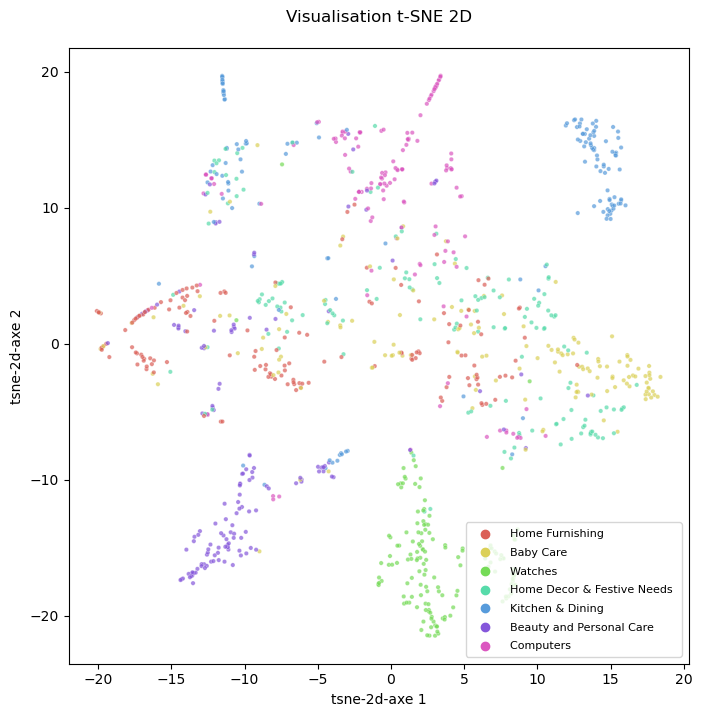

In [784]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc19,7, "categorie")

La projection des données issues de la NMF avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre quaelques groupes distincts, mais avec des chevauchements entre les groupes de catégories d'articles (notamment "Baby Care" et "Home Furnishing"). 

### 9.20.4 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [786]:
# Préparation des données
df_tsne_text_2d_enc19["label_kmeans"] = model_kmeans_enc19.labels_
df_tsne_text_2d_enc19

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,3.499719,-4.200081,1
1,Baby Care,-19.786751,-0.332618,0
2,Baby Care,-16.269037,-2.208619,0
3,Home Furnishing,-13.896248,2.339258,0
4,Home Furnishing,-8.259940,-2.168182,0
...,...,...,...,...
1044,Baby Care,-7.893632,4.252325,0
1045,Baby Care,16.259436,-2.442889,1
1046,Baby Care,-1.428011,5.695708,0
1047,Baby Care,17.651783,-2.305873,1


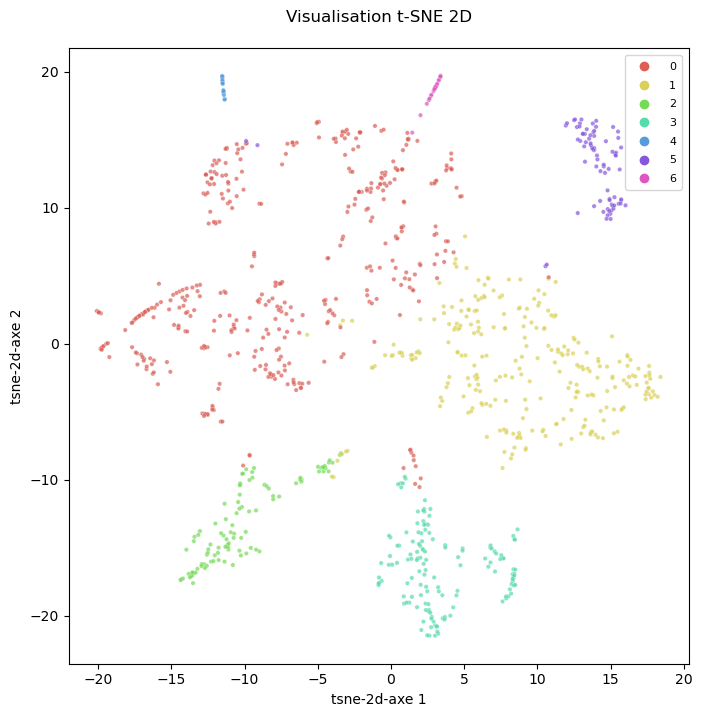

In [787]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_text_2d_enc19,7, "label_kmeans")

La projection des données issues de la NMF avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (clusters 0 et 1 relativement importants, les autres de plus petite taille), avec clusters relativement bien espacés, mais non denses.

   ### 9.20.5 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,26 est moyen**, ce qui signifie que quelques paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

### 9.20.6 Qualité du clustering - Coefficient de silhouette

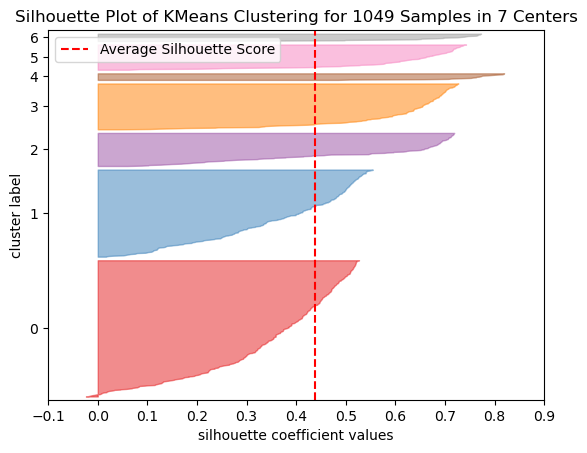

In [788]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_txt_19, model_kmeans_enc19)

Le graphique ci-dessus montre:
-  des clusters sans erreur (sauf cluster 0), 
- des cluster disproportionnés en taille (exemple: clusters 0 par rapport aux autres clusters)
- un score de silhouette moyen (0,44), ce qui signifie que les clusters sont relativement bien séparés et non denses.

Par conséquent, le clustering pour cet encodage des descriptions permet de séparer distinctement les clusters.

### 9.20.7 Qualité du clustering - Affichage matrice de confusion

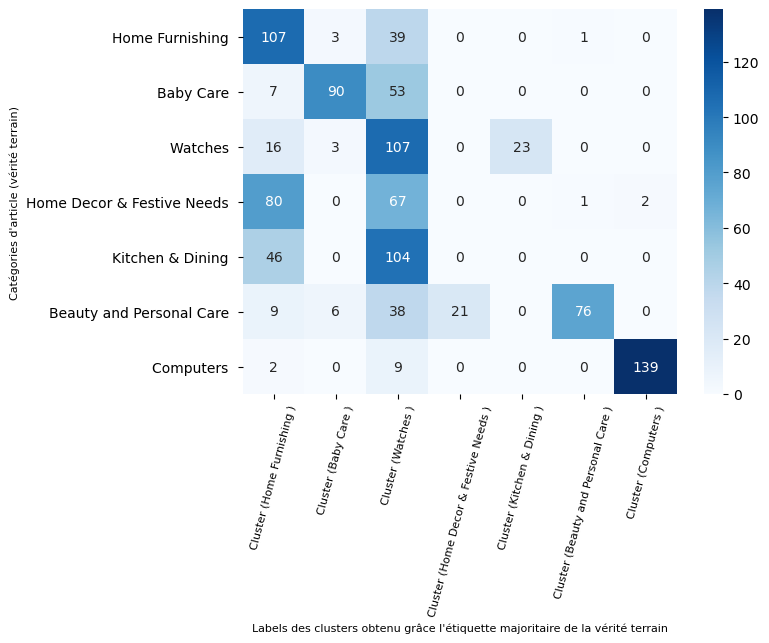

In [1190]:
# Réorganisation forcée de la matrice de confusion
argmax = [2, 0, 1, 6, 3, 5, 4]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc19.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées notamment dans les 1er et 3ème clusters (très volumineux en nombre d'articles) et que les autres clusters contiennent moins d'articles.

Toutefois:
- le 1er cluster regroupe principalement les articles de la catégorie "Home Furnishing"
- le 2ème cluster regroupe principalement les articles de la catégorie "Baby Care"
- le 6ème cluster regroupe principalement les articles de la catégorie "Baby and Personal Care"
- le 7ème cluster regroupe principalement les articles de la catégorie "Computers"

## 9.21 Encodage 20: encodage images - Réseau neurones VGG16 sans PCA

Test d'un encodage des images par un réseau de neurones VGG16 pré-entraîné **sans PCA**.

### 9.21.1 Clustering k-means

In [1205]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [1203]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_img_vgg16_w_pca = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [130]:
nbre_clusters = 7

In [1204]:
hyp_encodage_enc20 = 20
encodage_image_20 = df_vgg16
desc_encodage_txt_20 = "WITHOUT_PCA_img_vgg16"

# Clustering k-means
model_kmeans_enc20, silhouette_enc20, ari_enc20, results_kmeans_enc20 = clustering_kmeans(df_vgg16, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.02
Score moyen Adjusted Rand index (ARI) : 0.11


In [1206]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_img_vgg16_w_pca = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_img_vgg16_w_pca,
                                                                              hyp_encodage_enc20, desc_encodage_txt_20, "image", 
                                                                              silhouette_enc20, ari_enc20, results_kmeans_enc20)

In [1207]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [1208]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_img_vgg16_w_pca

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,WITHOUT_PCA_img_vgg16,image,0,148
1,WITHOUT_PCA_img_vgg16,image,1,67
2,WITHOUT_PCA_img_vgg16,image,2,63
3,WITHOUT_PCA_img_vgg16,image,3,81
4,WITHOUT_PCA_img_vgg16,image,4,31
5,WITHOUT_PCA_img_vgg16,image,5,597
6,WITHOUT_PCA_img_vgg16,image,6,62


### 9.21.2 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images.

In [1209]:
data_tsne_img_enc20 = classif_tsne(df_vgg16, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.026s...
[t-SNE] Computed neighbors for 1049 samples in 7.899s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 406.856624
[t-SNE] KL divergence after 250 iterations with early exaggeration: 103.728844
[t-SNE] KL divergence after 300 iterations: 2.124032


In [1210]:
# Préparation des données pour affichage des points 
df_tsne_img_2d_enc20 = pd.DataFrame()
df_tsne_img_2d_enc20["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_img_2d_enc20['tsne-2d-axe 1'] = data_tsne_img_enc20[:,0]
df_tsne_img_2d_enc20['tsne-2d-axe 2'] = data_tsne_img_enc20[:,1]
df_tsne_img_2d_enc20

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,-4.367661,11.851945
1,Baby Care,-8.652692,-7.972821
2,Baby Care,-16.151279,-0.139456
3,Home Furnishing,-16.509153,-9.683572
4,Home Furnishing,-10.976810,-4.395825
...,...,...,...
1044,Baby Care,-7.348173,1.463637
1045,Baby Care,-4.596246,7.085250
1046,Baby Care,-12.778091,-19.961384
1047,Baby Care,-5.576551,8.125230


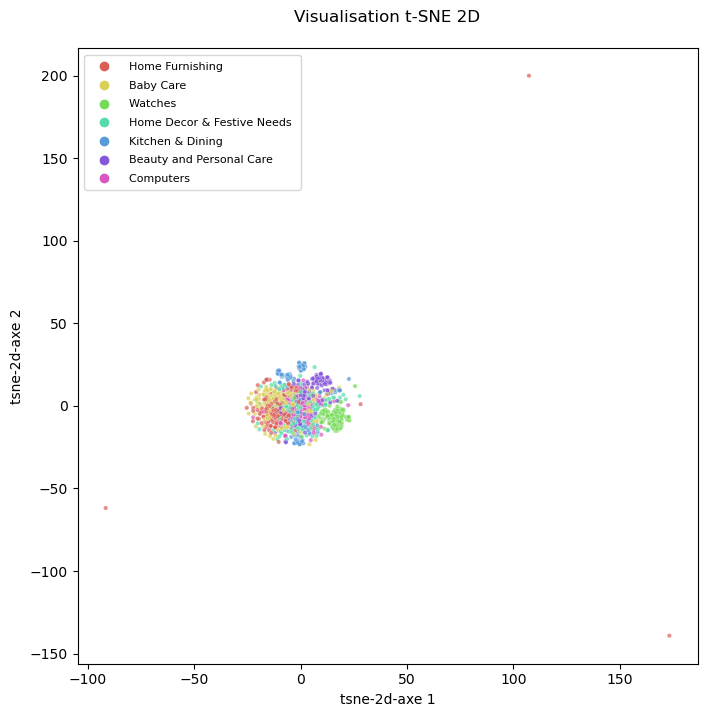

In [1211]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc20,7, "categorie")

La projection des données sans PCA avec les vraies étiquettes (catégories produit) sur le T-SNE montre des groupes non distincts, et avec des chevauchements entre les groupes de catégories de produit. 

### 9.21.3 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [1212]:
# Préparation des données
df_tsne_img_2d_enc20["label_kmeans"] = model_kmeans_enc20.labels_
df_tsne_img_2d_enc20

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,-4.367661,11.851945,0
1,Baby Care,-8.652692,-7.972821,5
2,Baby Care,-16.151279,-0.139456,5
3,Home Furnishing,-16.509153,-9.683572,5
4,Home Furnishing,-10.976810,-4.395825,5
...,...,...,...,...
1044,Baby Care,-7.348173,1.463637,0
1045,Baby Care,-4.596246,7.085250,0
1046,Baby Care,-12.778091,-19.961384,5
1047,Baby Care,-5.576551,8.125230,0


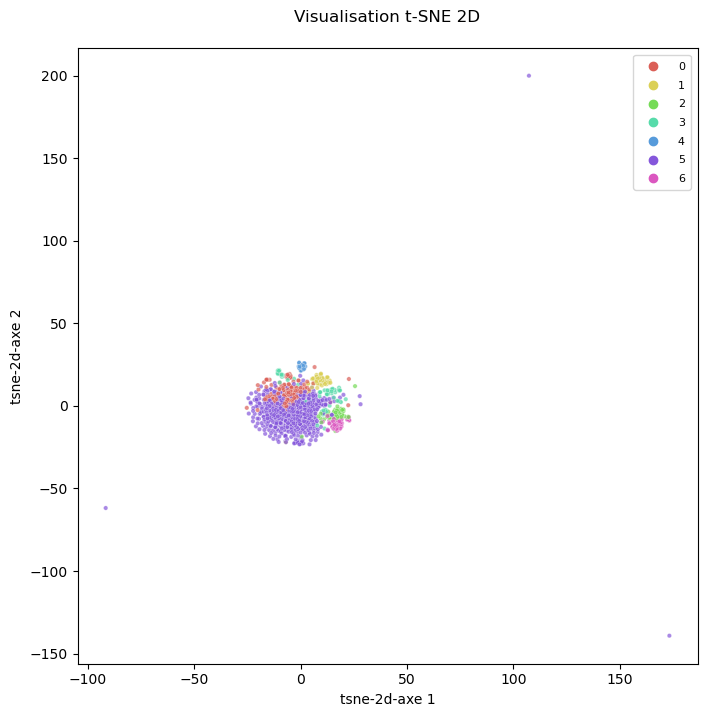

In [1213]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc20,7, "label_kmeans")

La projection des données sans PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 5 relativement important, les autres de plus petite taille) avec des chevauchements entre les clusters.

   ### 9.21.4 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,11 est mauvais**, ce qui signifie que peu de paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements.

Il n'y a pratiquement pas de similitude entre les groupes constitués par les catégories d'articles et la labels des clusters.

### 9.21.6 Qualité du clustering - Coefficient de silhouette

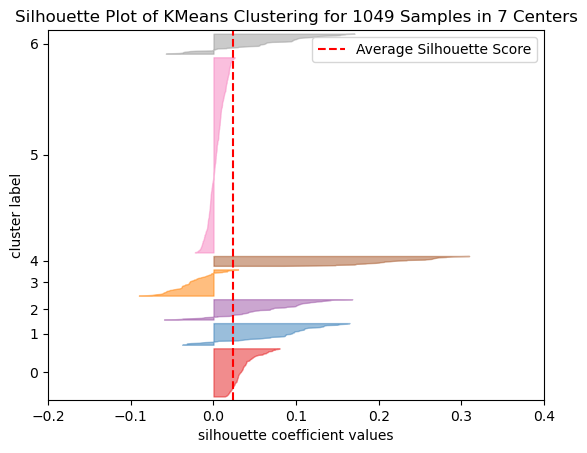

In [1214]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_image_20, model_kmeans_enc20)

Le graphique ci-dessus montre:
- des clusters en erreur (clusters 1, 2, 3, 6)  et le cluster 5 présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, ce qui signifie que les données de ces clusters sont incorrectes.
- un cluster disproportionné en taille (exemple: cluster 5 (597 articles) par rapport aux autres clusters)
- un score de silhouette mauvais (0,11), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.21.7 Qualité du clustering - Affichage matrice de confusion

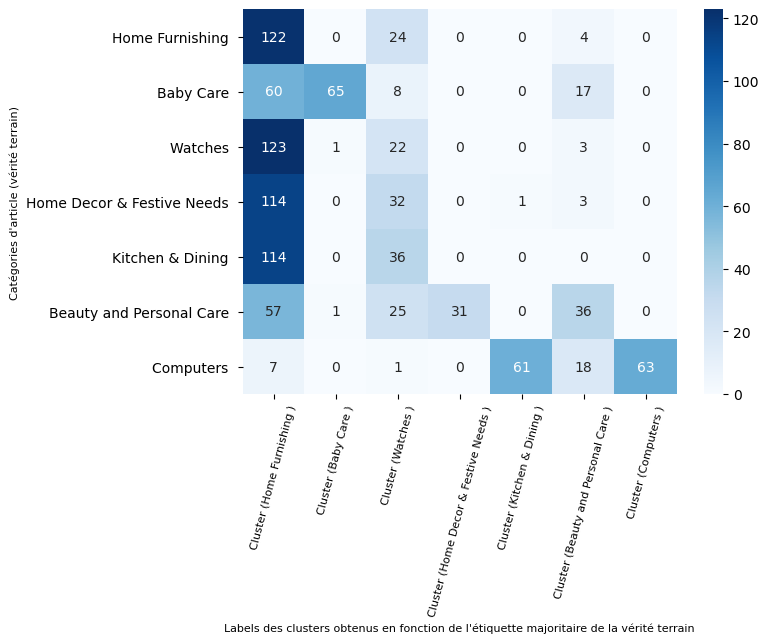

In [1217]:
# Réorganisation forcée de la matrice de confusion
argmax = [2, 1, 6, 5, 3, 0, 4]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc20.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes des catégories d'articles sont dispersées pratiquement en totalité dans le 1er cluster (très volumineux en nombre d'articles) et que les autres clusters contiennent très peu d'articles.

Disproportion dans la tailles de clusters.

## 9.22 Encodage 21: encodage images - Réseau neurones ResNet50 sans PCA

### 9.22.1 Clustering k-means

In [1218]:
# Ajout d'une ligne dans la matrice des scores
df_cluster_scores = add_line_score_dataset(df_cluster_scores)

In [1219]:
# Création d'une dataframe pour le labels et nombre d'article par cluster pour les différents encodages
df_result_cluster_img_resnet50_w_pca = pd.DataFrame(columns=["hyp encodage", "type encodage"],
                                   index=range(0, df_data_text_image_enc["label_cat_true"].nunique()))

In [1220]:
nbre_clusters = 7

In [1221]:
hyp_encodage_enc21 = 21
encodage_image_21 = df_resnet50
desc_encodage_txt_21 = "WITHOUT_PCA_img_resnet50"

# Clustering k-means
model_kmeans_enc21, silhouette_enc21, ari_enc21, results_kmeans_enc21 = clustering_kmeans(df_resnet50, nbre_clusters, 
                                                  df_data_text_image_enc["label_cat_true"], 1)

Coefficient silhouette moyen : 0.03
Score moyen Adjusted Rand index (ARI) : 0.32


In [1222]:
# Affichage synthèse des résultats clustering 
df_cluster_scores, df_result_cluster_img_resnet50_w_pca = synthese_resultats_clustering(df_cluster_scores, df_result_cluster_img_resnet50_w_pca,
                                                                              hyp_encodage_enc21, desc_encodage_txt_21, "image", 
                                                                              silhouette_enc21, ari_enc21, results_kmeans_enc21)

In [1223]:
# Affichage des score globaux sur les métriques pour les différents type d'encodage
df_cluster_scores

,hyp encodage,type encodage,silhouette score,ari score
0,PCA_txt_bow_stem,texte,0.27,0.06
1,PCA_txt_bow_lemma,texte,0.27,0.05
2,PCA_txt_bow_lemma_mindf,texte,0.28,0.06
3,PCA_txt_tfidf_stem,texte,0.05,0.23
4,PCA_txt_tfidf_lemma,texte,0.07,0.23
5,PCA_txt_tfidf_lemma_mindf,texte,0.1,0.24
6,PCA_txt_tfidf_lemma_mindf_ngram,texte,0.09,0.25
7,PCA_txt_docvec2,texte,0.26,0.04
8,PCA_img_bovw_sift,image,0.07,0.02
9,PCA_img_vgg16,image,0.13,0.09


In [1225]:
# Affichage de la composition des clusters pour un encodage donné
df_result_cluster_img_resnet50_w_pca

,hyp encodage,type encodage,kmeans_labels,nbre_articles
0,WITHOUT_PCA_img_resnet50,image,0,212
1,WITHOUT_PCA_img_resnet50,image,1,23
2,WITHOUT_PCA_img_resnet50,image,2,143
3,WITHOUT_PCA_img_resnet50,image,3,42
4,WITHOUT_PCA_img_resnet50,image,4,187
5,WITHOUT_PCA_img_resnet50,image,5,311
6,WITHOUT_PCA_img_resnet50,image,6,131


### 9.22.2 Visualisation T-SNE en 2 dimensions - labels = catégories articles (vérité terrain)

Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images.

In [1226]:
data_tsne_img_enc21 = classif_tsne(df_resnet50, 2)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 1049 samples in 0.092s...
[t-SNE] Computed neighbors for 1049 samples in 29.205s...
[t-SNE] Computed conditional probabilities for sample 1000 / 1049
[t-SNE] Computed conditional probabilities for sample 1049 / 1049
[t-SNE] Mean sigma: 138.458012
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.307159
[t-SNE] KL divergence after 300 iterations: 1.410273


In [1227]:
# Préparation des données pour affichage des points 
df_tsne_img_2d_enc21 = pd.DataFrame()
df_tsne_img_2d_enc21["categorie"] = df_data_text_image_enc["categ_princ"]
df_tsne_img_2d_enc21['tsne-2d-axe 1'] = data_tsne_img_enc21[:,0]
df_tsne_img_2d_enc21['tsne-2d-axe 2'] = data_tsne_img_enc21[:,1]
df_tsne_img_2d_enc21

,categorie,tsne-2d-axe 1,tsne-2d-axe 2
0,Home Furnishing,-0.147588,0.733286
1,Baby Care,10.644528,-3.451246
2,Baby Care,3.549655,-12.763524
3,Home Furnishing,9.940181,-15.241653
4,Home Furnishing,8.219230,-14.974365
...,...,...,...
1044,Baby Care,9.241768,-12.499552
1045,Baby Care,-9.652864,-7.592888
1046,Baby Care,9.190702,-10.567665
1047,Baby Care,-9.685402,-7.673357


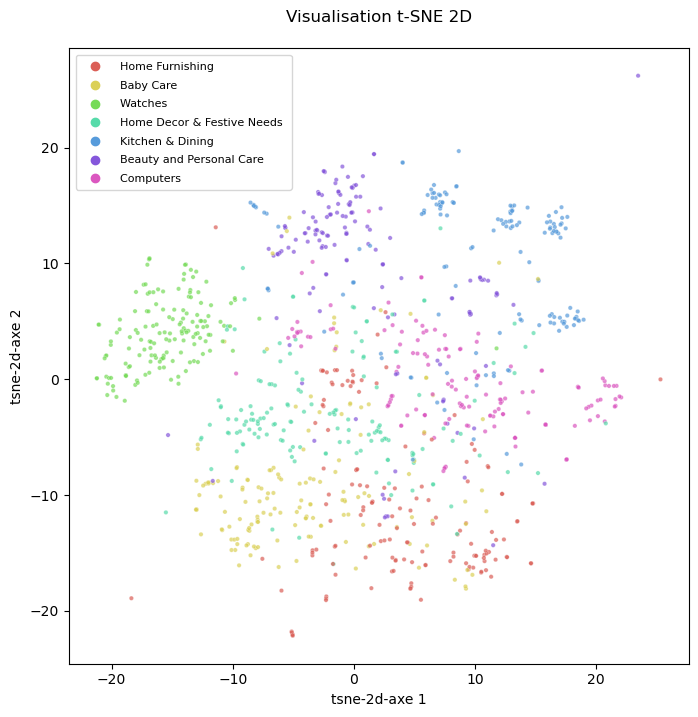

In [1228]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc21,7, "categorie")

La projection des données sans PCA avec les vraies étiquettes (catégories d'articles) sur le T-SNE montre des groupes peu distincts, et avec des chevauchements entre les groupes de catégories d'articles (principalement "Computers", "Beauty and Personal Care", "Home Decor & Festive Needs"). 

### 9.22.3 Visualisation T-SNE en 2 dimensions - labels = clusters k-means

In [1229]:
# Préparation des données
df_tsne_img_2d_enc21["label_kmeans"] = model_kmeans_enc21.labels_
df_tsne_img_2d_enc21

,categorie,tsne-2d-axe 1,tsne-2d-axe 2,label_kmeans
0,Home Furnishing,-0.147588,0.733286,5
1,Baby Care,10.644528,-3.451246,4
2,Baby Care,3.549655,-12.763524,4
3,Home Furnishing,9.940181,-15.241653,4
4,Home Furnishing,8.219230,-14.974365,4
...,...,...,...,...
1044,Baby Care,9.241768,-12.499552,4
1045,Baby Care,-9.652864,-7.592888,0
1046,Baby Care,9.190702,-10.567665,5
1047,Baby Care,-9.685402,-7.673357,0


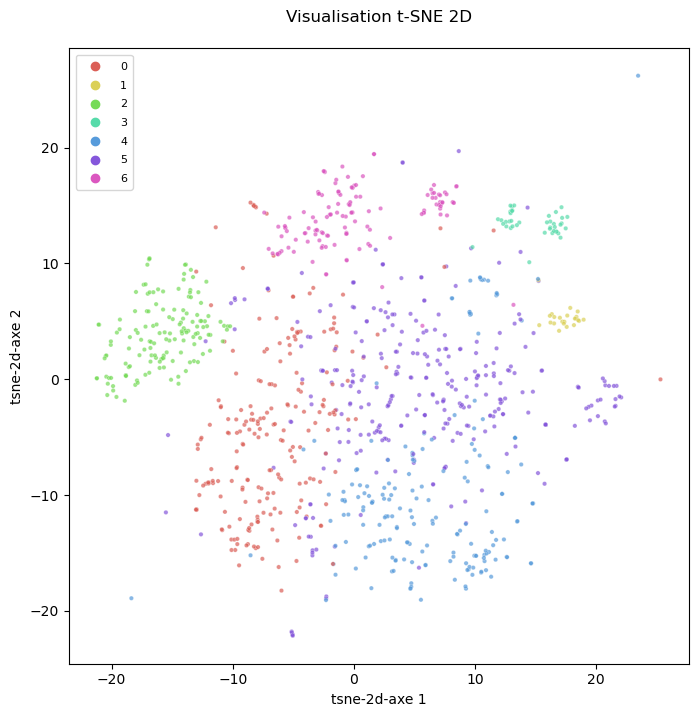

In [1230]:
# Appel de la fonction pour la représentation graphique 2D des points du T-SNE
proj_grade_tsne(df_tsne_img_2d_enc21,7, "label_kmeans")

La projection des données sans PCA avec les labels des clusters k-means sur le T-SNE montre des disproportions dans les tailles des clusters (cluster 1 et 3 relativement petits, les autres de plus grande taille) avec des chevauchements entre les clusters (surtout clusters 0, 3 et 5).

   ### 9.22.4 Analyse de la similarité des catégories d'articles et des clusters - ARI score

**Le score ARI de 0,32 est moyen**, ce qui signifie que quelques paires entre les éléments des clusters k-means et les étiquettes "vraies" (catégories d'article) sont classées de la même manière sous les deux regroupements, mais pas la majorité.

### 9.22.6 Qualité du clustering - Coefficient de silhouette

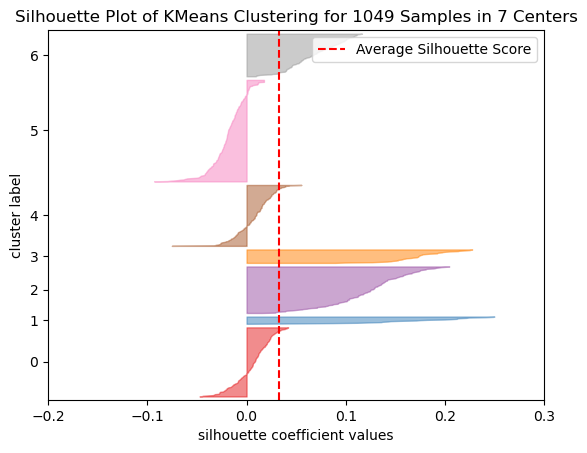

In [1231]:
# Appel de la fonction pour calculer et afficher le coefficient de silhouette
calcul_coef_silhouette_kmeans(encodage_image_21, model_kmeans_enc21)

Le graphique ci-dessus montre:
- des clusters en erreur (notamment les clusters 0, 4 et 5) présentant principalement des erreurs avec un score de silhouette inférieur à la moyenne du score de silhouette sur l'ensemble des clusters, 
- un score de silhouette mauvais (0,03), ce qui signifie que les clusters se chevauchent.

Par conséquent, le clustering pour cet encodage des descriptions ne permet pas de séparer distinctement les clusters.

### 9.22.7 Qualité du clustering - Affichage matrice de confusion

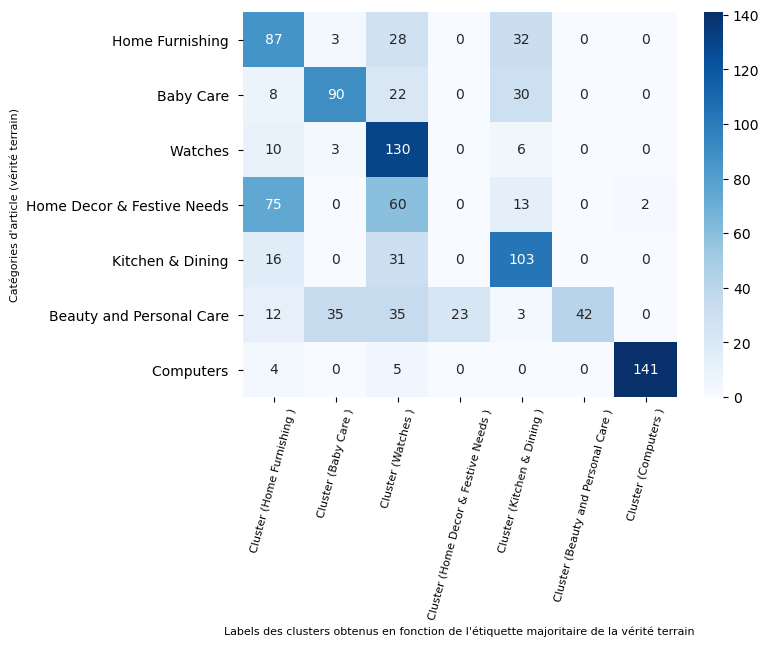

In [1235]:
# Réorganisation forcée de la matrice de confusion
argmax = [0, 3, 6, 5, 4, 2, 1]

# Appel de la fonction pour l'affichage de la matrice de confusion
cm_argmax = affichage_matrice_confusion_transform(df_data_text_image_enc["label_cat_true"], 
                            df_data_text_image_enc["categ_princ"], model_kmeans_enc21.labels_, "force", argmax)

Sur le heatmap de la matrice de confusion, on voit bien que les étiquettes certaines catégories d'articles correspondent majoritairement à des clusters données:
- catégorie d'articles "Baby Care" dans le 2ème cluster,
- catégorie d'articles "Watches" dans le 3ème cluster,
- catégorie d'articles "Kitchen & Dining" dans le 5ème cluster,
- catégorie d'articles "Computers" dans le 6ème cluster.

Lea autres catégories sont dispersées dans les différents clusters.

# 10. Conclusion sur l'étude de faisabilité

La métrique principale est l'ARI score et sera complétée par 2 métriques secondaires (le score de silhouette et l'homogénéité de la taille des clusters).

## 10.1 Synthèse sur les scores ARI - Métrique principale

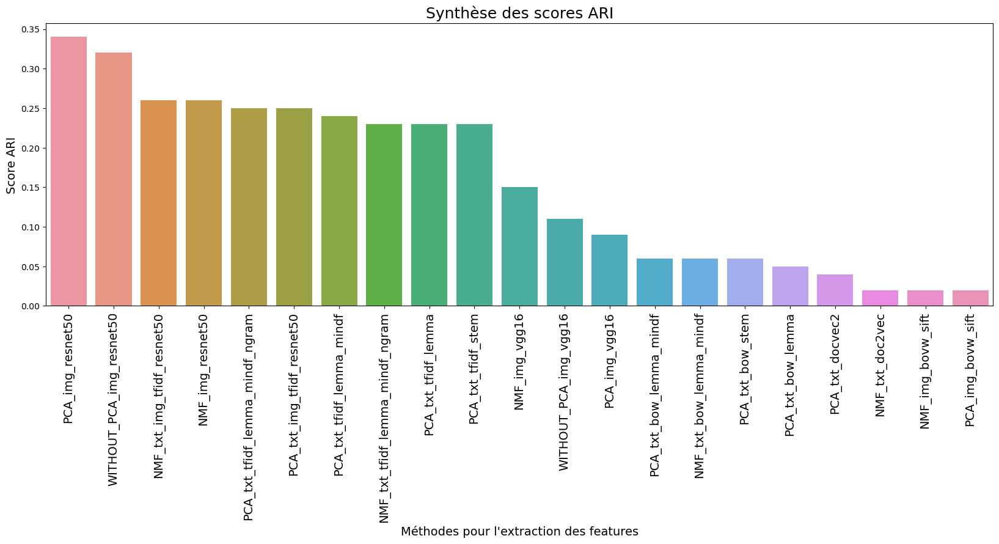

In [1236]:
affich_score_ari(df_cluster_scores)

L’ARI permet d’évaluer si les 7 groupes formés par le k-means correspondent à nos 7
catégories initiales (categ_princ).

IL est compris entre 0 (aucune paire classée de la même manière sous les deux regroupements) et 1 (regroupement similaire aux catégories initiales).

Les meilleurs scores ARI sur le clustering des encodages testés sont entre 0,23 et 0,34.
Les clustering avec un score ARI inférieur à 0,2 sont éliminés.

Sur la métrique principale (ARI), on retient uniquement les clustering suivants:
- encodage des images à partir d'un réseau de neurones ResNet50, réduction de dimensions PCA (ARI=0,34)
- encodage des images à partir d'un réseau de neurones ResNet50, sans PCA (ARI=0,32)
- encodage textes+images à partir de vectorisation Tf-Idf et réseau de neurones ResNet50, modélisation NMF (ARI=0,26)
- encodage des images à partir d'un réseau de neurones ResNet50, modélisation NMF (ARI=0,26)
- encodage textes+images à partir de vectorisation Tf-Idf et réseau de neurones ResNet50, réduction de dimensions PCA (ARI=0,25)
- encodage textes à partir de vectorisation Tf-Idf (lemmatisation, limitation nombre d'occurences, unigrammes et bigrammes), réduction de dimensions PCA (ARI=0,25)
- encodage textes à partir de vectorisation Tf-Idf (lemmatisation, limitation nombre d'occurences), réduction de dimensions PCA (ARI=0,24)
- encodage textes à partir de vectorisation Tf-Idf (racinisation), réduction de dimensions PCA (ARI=0,23)
- encodage textes à partir de vectorisation Tf-Idf (lemmatisation), réduction de dimensions PCA (ARI=0,23)
- encodage textes à partir de vectorisation Tf-Idf (lemmatisation, limitation nombre d'occurences, unigrammes et bigrammes), modélisation NMF (ARI=0,23)

## 10.2 Synthèse sur les scores de silhouette - Métrique secondaire

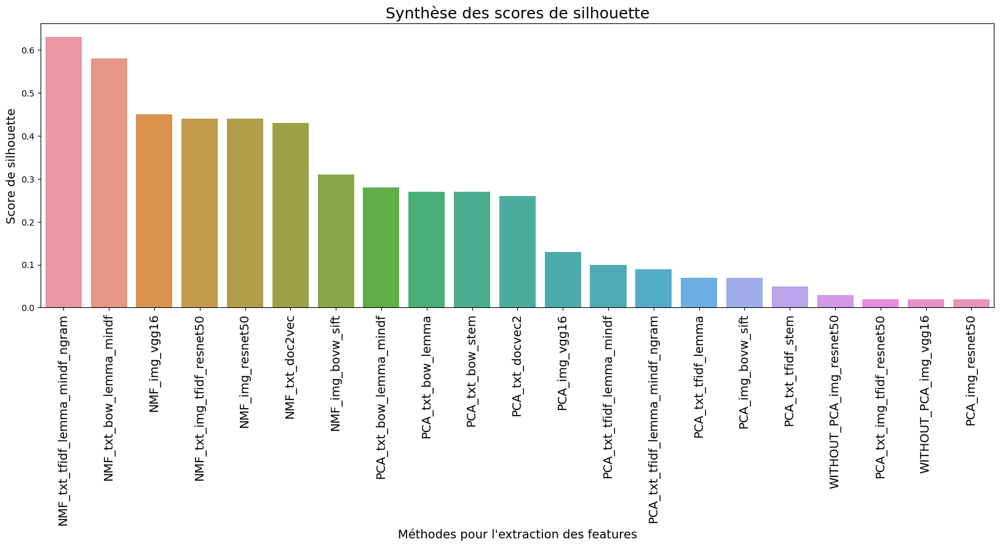

In [1237]:
affich_score_silhouette(df_cluster_scores)

Le coefficient de silhouette permet de mesurer la densité (homogénéité) et la séparation des clusters.

Il est compris entre -1 et 1: une score de silhouette de 1 signifie que les grappes sont très denses et bien séparées,  une score de 0 signifie que les clusters se chevauchent. Enfin, un score inférieur à 0 signifie que les données appartenant aux clusters peuvent être erronées/incorrectes.

Sur les 10 hypothèses d'encodage retenues précedemment sur le score ARI, on écarte les encodages suivants:
- encodage des images à partir d'un réseau de neurones ResNet50, réduction de dimensions PCA
- encodage des images à partir d'un réseau de neurones ResNet50, sans PCA (ARI=0,32)
- encodage textes+images à partir de vectorisation Tf-Idf et réseau de neurones ResNet50, réduction de dimensions PCA
- encodage textes à partir de vectorisation Tf-Idf (lemmatisation, limitation nombre d'occurences, unigrammes et bigrammes), réduction de dimensions PCA
- encodage textes à partir de vectorisation Tf-Idf (lemmatisation, limitation nombre d'occurences), réduction de dimensions PCA
- encodage textes à partir de vectorisation Tf-Idf (racinisation), réduction de dimensions PCA
- encodage textes à partir de vectorisation Tf-Idf (lemmatisation), réduction de dimensions PCA

En effet, même si les hypothèses d'encodage permettent d'obtenir un socre ARI honorable, leur coefficient de silhouette se situe entre 0,02 et 0,1, ce qui signifie que les clusters se chevauchent, qu'ils ne sont pas bien séparés et avec la présence d'erreurs.

Par contre, on garde les encodages suivants (après avoir écarté les encodages retenus précédemment inférieurs à 0,20 sur le silhouette score):
- encodage textes+images à partir de vectorisation Tf-Idf et réseau de neurones ResNet50, modélisation NMF (silhouette=0,44 et ARI=0,26)
- encodage des images à partir d'un réseau de neurones ResNet50, modélisation NMF (silhouette=0,44 et ARI=0,26)
- encodage textes à partir de vectorisation Tf-Idf (lemmatisation, limitation nombre d'occurences, unigrammes et bigrammes), modélisation NMF (silhouette=0,63 et ARI=0,23)


## 10.3 Taille des clusters

Pour les 3 encodages retenus ci-dessus, on regarde la taille des différents clusters.

**Taille des clusters pour l'encodage textes+images à partir de vectorisation Tf-Idf et réseau de neurones ResNet50, modélisation NMF (silhouette=0,44 et ARI=0,26)**

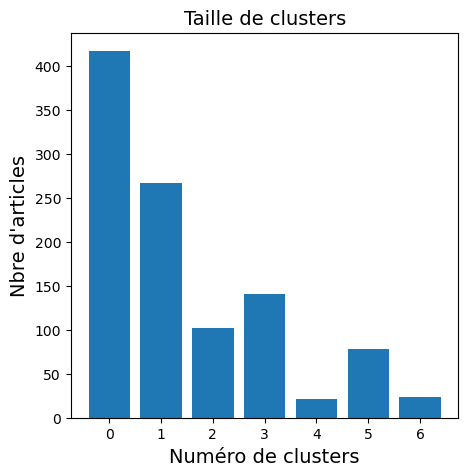

In [980]:
# Appel de la fonction pour l'affichage de la distribution des clusters
affich_taille_clusters(df_result_cluster_tfidf_resnet50_nmf)

**Taille de clusters pour l'encodage des images à partir d'un réseau de neurones ResNet50, modélisation NMF (silhouette=0,44 et ARI=0,26)**

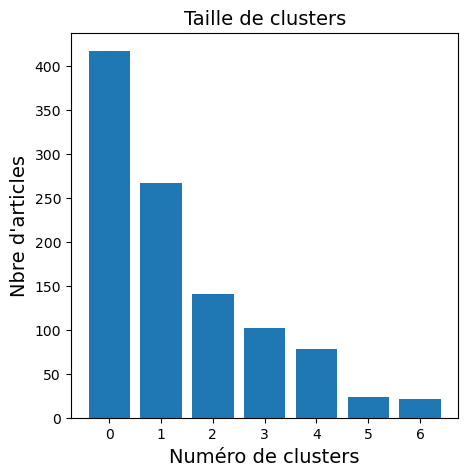

In [981]:
# Appel de la fonction pour l'affichage de la distribution des clusters
affich_taille_clusters(df_result_cluster_img_resnet50_nmf)

**Taille des clusters pour l'encodage textes à partir de vectorisation Tf-Idf (lemmatisation, limitation nombre d'occurences, unigrammes et bigrammes), modélisation NMF (silhouette=0,63 et ARI=0,23)**

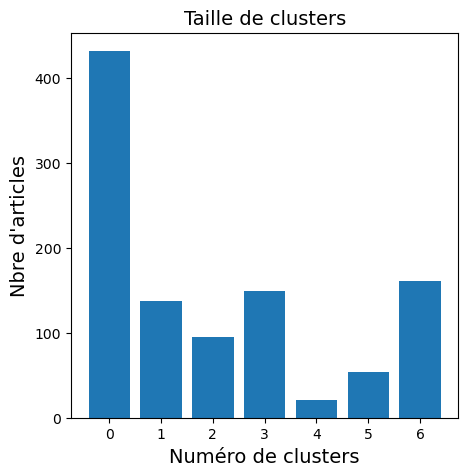

In [982]:
# Appel de la fonction pour l'affichage de la distribution des clusters
affich_taille_clusters(df_result_cluster_tfidf_lemma_mindf_ngram_nmf)

On se rend compte que les clustering des 3 encodages retenus suite à l'étude de faisabilité proposent des clusters disporportionnées en taille, ne correspondant pas à la répartition des catégories d'articles de la vérité terrain.

## 10.3 Conclusion finale

### 10.3.1 Réduction de dimension PCA vs Modélisation / Compression features NMF

Tout d'abord, on se rend compte, de manière générale, que la réduction de dimensions par la méthode PCA n'est pas vraiment adaptée pour le traitement des textes et des images.

En effet, même si la PCA est fortement recommandée lorsqu'il faut transformer des dimensions élevées en dimensions basses (cas du traitement des images), on se rend compte que les résultats sur les métriques (silhouette ou ARI) sont meilleurs avec la méthode NMF. 

La méthode NMF (Non Negative Matrix Factorisation), au delà de la réduction de features qu'elle engendre, peut être considérée comme une version compressée de l'ensemble de données d'origine.

La méthode NMF est efficace pour la reconnaissance de mots et de vocabulaire car la compression du texte original en vecteurs de données plus petits est facilement possible.

Et elle peut être un très bon choix dans les problèmes de traitement d'image, l'exploration de texte, les processus de transcription, l'encodage et le décodage cryptiques. Il peut également gérer la décomposition d'objets de données non compréhensibles comme des vidéos, de la musique, des images.

### 10.3.2  Faisabilité - Limites - Améliorations

**L'étude de faisabilité montre qu'il est possible d'envisager un moteur de classification à partir de l'encodage de features sur les descriptions (textes) et sur les images.**

Il est possible de réaliser un moteur de classification, soit, sur les descriptions texte seuls, soit sur les image seules, soit sur une combinaison textes+images.

Du point du vue du clustering, il est intéressant de combiner les textes avec les images, ce qui améliore le coefficient de silhouette par rapport à l'encodage des textes seuls.

La faisabilité d'un moteur de classification est illustrée par des cas concrets de classification SVM, confirmant définitivement cette faisabilité.

**Limites:**

Comme on peut le voir sur les visualisations T-SNE à partir des labels des clusters k-means, nous avons des clustering assez bien répartis, mais qui ne correspondent pas à nos categorie initiales (ARI score moyen).

Les clusters sont mieux séparés et denses pour l'encodage du texte seulement.

**Améliorations:**

- Il faut augmenter le volume de la base de données pour améliorer les performances avec plus de volumes de données.
- Pour l'encodage du texte, il faut expérimenter des méthodes de Word Embedding (FastText, ELM0) et de Sentences Embedding (Google Universal Sentence) plus performantes.

# 11. Exemples de classifications à partir des features encodées

Pour vérifier la faisabilité d'un moteur de classification à partir de l'encodage des features (textes et images), nous allons calculer la précision des prédictions (accuracy) à partir des encodages suivants:
- **encodage des textes seulement**: vectorisation TF-IDF (avec lemmatisation, limitation du nombre des occurrences et prise en compte des unigrammes et bigrammes) et modélisation NMF.
- **encodage des images seulement**: encodage des features à partir d'un réseau de neurones CNN (réseau ResNet50) et modélisation NMF.
- **encodage textes + images**: combinaison des encodages texte et image ci-dessus et modélisation NMF.

Le classifieur utilisé est le **SVM Classifier**.

## 11.1 Classification SVM: textes (TF-IDF, NMF)

In [961]:
# Appel de la fonction pour classification SVM
model, predictions, accuracy, X_test, y_test = classif_svm_classifier(feat_nmf_tfidf_lemma_mindf_ngram, 
                                                                      df_data_text["categ_princ"])

In [962]:
print("Accuracy du SVM classifier :", round(accuracy, 2))

Accuracy du SVM classifier : 0.57


On se rend compte que la précision de la classification est moyenne (0,57) à partir de l'encodage texte seulement. 

In [1242]:
# Décomposition des catégories d'articles
y_test.value_counts()

Baby Care                      44
Computers                      41
Watches                        40
Home Furnishing                35
Kitchen & Dining               35
Beauty and Personal Care       35
Home Decor & Festive Needs     33
Name: categ_princ, dtype: int64

L'echantillon de test contient : 263 articles.


<Figure size 1000x1000 with 0 Axes>

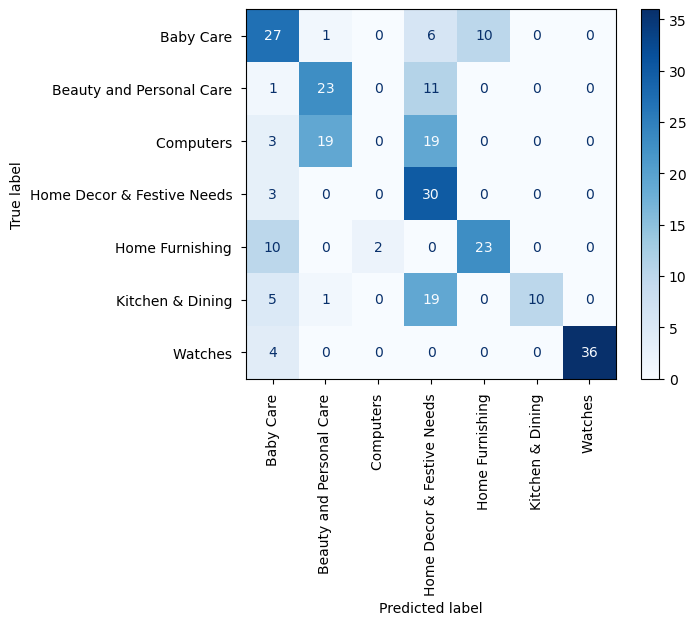

In [964]:
# Affichage de la matrice de confusion
affich_cm_classif(X_test, y_test, model, predictions)

Il y a beaucoup d'erreurs de prédiction, sauf pour les catégories d'articles "Watches" et "Home Decor & Festive Needs".
Ainsi, le cluster avec les labels "Watches" et "Home Decor & Festive Needs" correspondent vraisemblablement aux mêmes catégories de la vérité terrain.

## 11.2 Classification SVM: images (ResNet50, NMF)

In [957]:
# Appel de la fonction pour classification SVM
model, predictions, accuracy, X_test, y_test = classif_svm_classifier(feat_nmf_img_resnet50, 
                                                                      df_data_text["categ_princ"])

In [958]:
print("Accuracy du SVM classifier :", round(accuracy, 2))

Accuracy du SVM classifier : 0.75


La précision de la classification est meilleure (0,75) à partir de l'encodage des images.

In [1243]:
# Décomposition des catégories d'articles
y_test.value_counts()

Baby Care                      44
Computers                      41
Watches                        40
Home Furnishing                35
Kitchen & Dining               35
Beauty and Personal Care       35
Home Decor & Festive Needs     33
Name: categ_princ, dtype: int64

L'echantillon de test contient : 263 articles.


<Figure size 1000x1000 with 0 Axes>

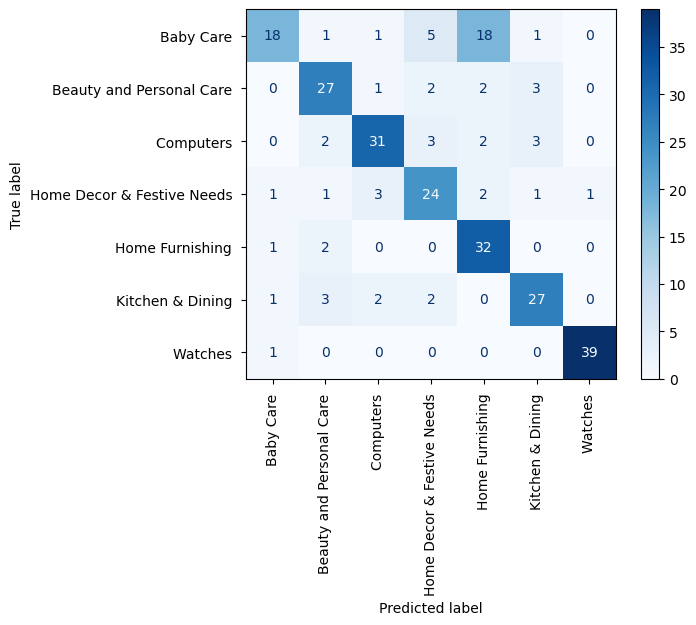

In [959]:
# Affichage de la matrice de confusion
affich_cm_classif(X_test, y_test, model, predictions)

Mise à part la catégorie "Baby Care", les prédictions de la classification sont globalemet correctes. Si on entre plus dans le détail, les précisions (accuracy) sont les suivantes:
- "Baby Care": 41%
- "Beauty and Personal Care": 77%
- "Computers": 79%
- "Home decor and Festive needs": 73%
- "Home Furnishing": 91%
- "Kitchen and Dining": 77%
- "Watches": 97%

La catégorie « Baby Care » génère les résultats les plus mauvais. Cela est dû a une grande diversité d’articles contenus dans celle-ci.

## 11.3 Classification SVM: textes + images (TF-IDF, ResNet50, NMF)

In [954]:
# Appel de la fonction pour classification SVM
model, predictions, accuracy, X_test, y_test = classif_svm_classifier(feat_nmf_txtimg_tfidf_resnet50, 
                                                                      df_data_text["categ_princ"])

In [955]:
print("Accuracy du SVM classifier :", round(accuracy, 2))

Accuracy du SVM classifier : 0.75


La précision de la classification est identique (0,75) à la classification à partir de l'encodage des images seules.

L'echantillon de test contient : 263 articles.


<Figure size 1000x1000 with 0 Axes>

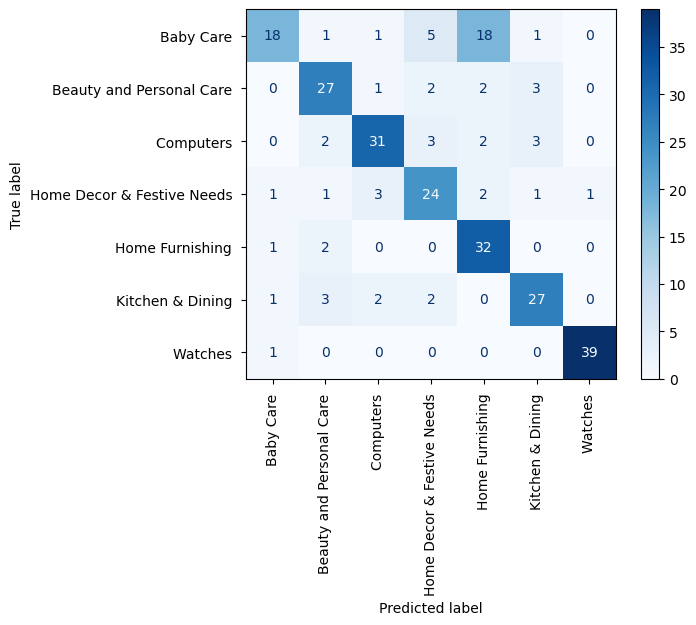

In [956]:
# Affichage de la matrice de confusion
affich_cm_classif(X_test, y_test, model, predictions)

On se rend compte que la matrice de confusion pour l'encodage textes + images est la même que pour l'encodage des images seulement.

On retrouve les mêmes précisions par catégorie d'articles.

On retrouve le même comportement sur les résultats de la classification que sur les métriques du clustering: comme pour le clustering textes+images, la classification textes+images ne permet pas d'améliorer le résultat (précision ici) de la classification sur les images seules.